In [1]:
from IPython.display import HTML
HTML('''<script>
code_show=false; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
 click <a href="javascript:code_toggle()">here</a> to hide the raw code.''')

**Parameter from production runs**

|RunName|T/orbs|$\alpha_M$|$\alpha_R$|$\alpha_{tot}$|$\langle$$\varepsilon_{\eta,sh}$$\rangle_{i}$$/$$\langle$$\varepsilon_{\eta}$$\rangle$|$\langle$$\varepsilon_{\eta,sh}$$\rangle    $$/$$\langle$$\varepsilon_{\eta}$$\rangle$|$N_{jsheet}$(>8) | dimensions(non- vol- and dis-weighted) |$\langle \overline{V_{sh}/V}\rangle$|$\langle$$\overline{v_{sh}/V}$$\rangle_{\varepsilon}$$(10$$^{-4})$ |
|----------|:----:|:------:|:-----:|:---------:|:-------:|:------------:|:----------------:|:------:|:--------:|:-----:|
|<s>x2y4z1r64pm1re4000</s>  |50 (25) | 0.0948 |0.0258 |0.1206 |6.70 | 8.34 |127.7 |(0.447,0.140,0.0477)(1.48,0.41,0.18)(1.59,0.44,0.19)| 0.029 | 18.7
|x2y4z1r128pm1re4000   | 50 (25)|0.1093  |0.0269 |0.1362 | 7.86 | 10.8 | 340.4  |(0.27,0.10,0.03)(1.27,0.38,0.17)(1.38,0.42,0.18)|  0.023| 10.2|
|x2y4z1r256pm1re4000   | 25 (10)|0.0916  |0.0211 |0.1127 | 8.74 | 12.7 | 664.2  |(0.202,0.077,0.0234)(1.11,0.35,0.15)(1.23,0.39,0.17) | 0.020 |6.27 |
|x2y4z1r256pm1re8000   | 50 (25)|0.1853  |0.0365 |0.2217 | 9.72 | 14.6 | 1198.5 |(0.15,0.06,0.018)(1.15,0.37,0.17)(1.29,0.42,0.18)| 0.018 |5.78 |
|x2y4z1r512pm1re8000   |25 (10)| 0.1929 |0.0375 |0.2303  | 12.3 | 19.5 | 2226.5 |(0.10,0.042,0.012)(0.93,0.33,0.15)(1.09,0.38,0.17)|0.013 | 3.13| 
|x2y4z1r512pm1re16000   |25 (10)| 0.2557| 0.0457 | 0.3014| 13.8 | 21.9 | 4281.4 |  (0.073,0.031,0.009)(0.91,0.35,0.15)(1.08,0.40,0.18)| 0.012 | 2.58 |
|x2y4z1r256ideal        | 25 (10)|0.1846 | 0.0335| 0.2181| 10.4 | 15.2 | 2802.6 | (0.094,0.039,0.012)(0.95,0.37,0.17)(1.06,0.42,0.19)|0.016 | 4.36 |





$\bar{A}\equiv \frac{ \int A dt } {  \int dt}$; $\langle A \rangle \equiv \frac{\int A dV}{\int dV}$;  $\langle A \rangle_i \equiv \frac{\int A dv_i}{\int dv_i}$



In [2]:
%load_ext autoreload
%autoreload 2
#%reload_ext autoreload

# 1. numerical convergence
* 2x4x1  resol  64/H, 128/H, 256/H, 512/H  
* Pm = 1, Re = 4000,8000, and 16000
* convergence found 128/H with Re=4000 (comparing with 256/H), 256/H with Re=8000 (comparing with 512/H)


Run x2y4z1r128pm1re4000: <alpha> =  0.109934813 0.0269628239937 0.136897636994
Run x2y4z1r256pm1re8000: <alpha> =  0.149096912406 0.0300220509719 0.179118963378
Run x2y4z1r512pm1re16000: <alpha> =  0.255741469578 0.0456552051537 0.301396674731
Run x2y4z1r256ideal: <alpha> =  0.187646207 0.0337700861812 0.221416293181
Run adb.r256.new: <alpha> =  0.159576134555 0.0253518592961 0.184927993851


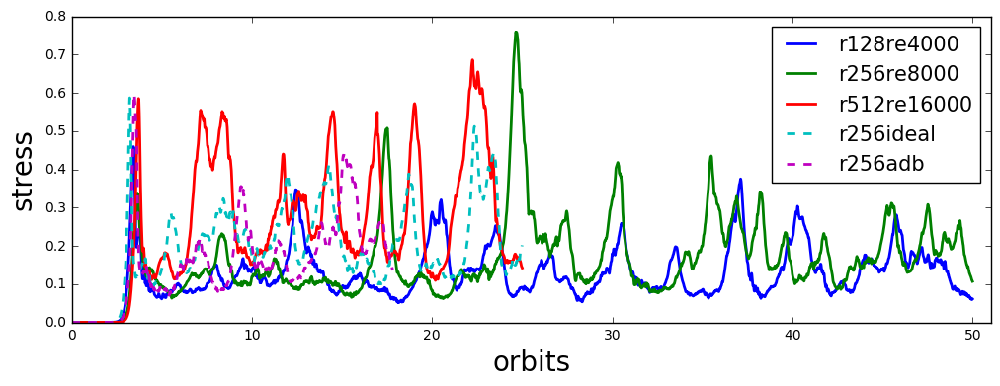

In [3]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
from read_hist import read_hist1d
%matplotlib inline


direname='/tigress/jiming/reconnect/athena/bin/'
basename='Unstra.out2.'
appdname='athdf'
histname='Unstra.hst'

omg=1.0
rho0=1.0
cs = 1.0
pres = rho0*cs**2
torb=2.*np.pi/omg

#list of target
targlist=[  'x2y4z1r64pm1re4000', 'x2y4z1r128pm1re4000',\
            'x2y4z1r256pm1re4000',#'x2y4z1r512pm1re4000',
            'x2y4z1r256pm1re8000',\
            'x2y4z1r512pm1re8000','x2y4z1r512pm1re16000',
            'x2y4z1r256ideal','adb.r256.new']


# a shorter list for paper:
targlist=[  'x2y4z1r128pm1re4000',\
            'x2y4z1r256pm1re8000',\
            'x2y4z1r512pm1re16000',\
            'x2y4z1r256ideal',\
             'adb.r256.new'] #,'x2y4z1r512pm1re4000']

Lx,Ly,Lz=2.0,4.0,1.0
volume= Lx*Ly*Lz
first_time=True

matplotlib.rcParams['figure.figsize'] = (12,4)

for targname in targlist:
    fname=direname+targname+'/'+histname
    if targname=='adb.r256' or targname=='adb.r256.new':
      tt,em1,em2,em3,maxwell,reynolds = read_hist1d(fname,adb=True)
      plt.plot(tt/torb,(maxwell+reynolds)/pres/volume,'--',label='r256adb',lw=2)
    else:
      tt,em1,em2,em3,maxwell,reynolds = read_hist1d(fname)
      if targname=='x2y4z1r256ideal':
        plt.plot(tt/torb,(maxwell+reynolds)/pres/volume,'--',label=targname[6:],lw=2)
      else:
        plt.plot(tt/torb,(maxwell+reynolds)/pres/volume,label=targname[6:10]+targname[13:],lw=2)
    size=int(len(maxwell)*0.2)
    if targname == 'x2y4z1r256pm1re8000':
        size =int(len(maxwell)*0.2)
    if targname == 'x2y4z1r512pm1re4000':
        size =int(len(maxwell)*0.2)
    print 'Run '+targname+': <alpha> = ',np.average(maxwell[size:])/pres/volume, \
                                         np.average(reynolds[size:])/pres/volume, \
                                         np.average(maxwell[size:]+reynolds[size:])/pres/volume
   
plt.ylim([0,0.8])
plt.xlim([0,51])
#plt.xticks(np.arange(0, 51, 1.0))
plt.xlabel('orbits',fontsize=20)
plt.ylabel('stress',fontsize=20)
plt.legend(fontsize=15,loc=1)
plt.savefig('alpha_t.png', format='png', dpi=300)

* power spectra show convergence too
* note there is discrepancy between r256re8000 and r512re8000, probably due to time average; the former exhibit stronger fluctuation only at later time where the spectra have not yet been computed (only frame 30-50, need to extend to 80 as suggested by the stress vs. time plot)

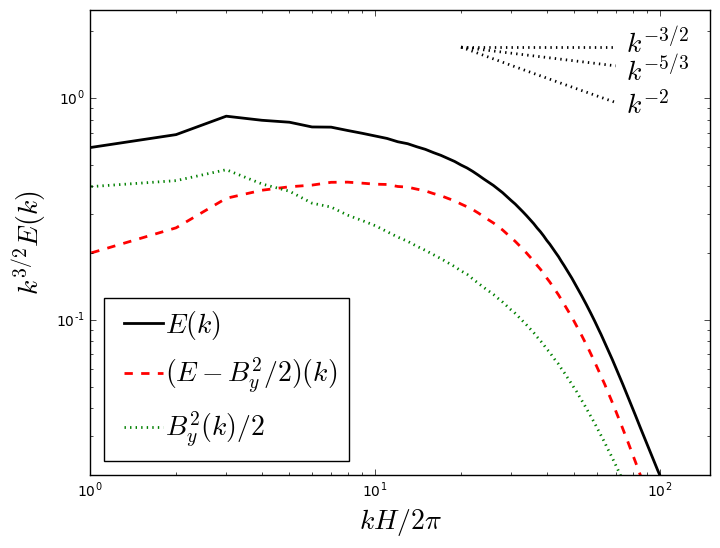

In [26]:
from powerspectra.pspec import get_pspec1dall
from powerspectra.pspec import get_pspec1d
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

lx,ly,lz=2,4,1
prefac = (4.*np.pi)**2*(lx*ly*lz)*2/np.pi
clist = ['k','r','g','m','y','k','c','k']
lw = [2,2,2,2,2,2,2,1]
cnt = 0
matplotlib.rcParams['figure.figsize'] = (8,6)

targname = 'x2y4z1r512pm1re16000'
ts,te,tstride= 25,40,1
nkx,nky,nkz=512,504,256

# targname = 'x2y4z1r256pm1re8000'
# ts,te,tstride= 50,100,1
# nkx,nky,nkz=256,252,128
## pwra -shell_int kinetic; pwrb - shell_int magnetic
## pwrax - yz_int kinetic along kx axis etc.
##k,kx,ky,kz,pwra,pwrb,pwrax,pwrbx,pwray,pwrby,pwraz,pwrbz = get_pspec1dall(targname,nkx,nky,nkz,ts,te,tstride)
k,pwra,pwrb,pwrby = get_pspec1d(targname,ts,te,tstride,noby=True,nk=256)
appfac = (k/(k.max()/2))**2
appfac[0:len(k)/2+1]=1
appfac[:]=1.
kymax = int(k[int(nky/ly)])
appfac = np.zeros(len(k))
appfac[0:kymax] = 1.0
appfac[kymax:] = k[kymax:]/kymax # in order to remove the excessive volume due to low resol in yd

plt.plot(k[:-1],k[:-1]**1.5*(pwrb[:-1]+pwra[:-1]+pwrby[:-1])*prefac/appfac[:-1],'-'+clist[0],lw=lw[cnt],\
         label=r'$E(k)$')

plt.plot(k[:-1],k[:-1]**1.5*(pwrb[:-1]+pwra[:-1])*prefac/appfac[:-1],'--'+clist[1],lw=lw[cnt],\
         label=r'$(E-B_y^2/2)(k)$')

plt.plot(k[:-1],k[:-1]**1.5*pwrby[:-1]*prefac/appfac[:-1],':'+clist[2],lw=lw[cnt],\
         label=r'$B_y^2(k)/2$')

cnt +=1
plt.xscale('log')
plt.yscale('log')
plt.xlim([1,150])
plt.ylim([2e-2,2.5])
plt.xlabel(r'$kH/2\pi$',fontsize=20)
plt.ylabel('power',fontsize=20)
plt.ylabel(r'$k^{3/2}E(k)$',fontsize=20)
amp = 1.6
xshift,yshift=20,0.1
x=np.arange(xshift,70,0.1)
y=(x/xshift)
plt.plot(x,yshift+amp*y**(1.5-1.5),'k:',lw=2)
plt.plot(x,yshift+amp*y**(1.5-5./3.),'k:',lw=2)
plt.plot(x,yshift+amp*y**(1.5-2.0),'k:',lw=2)

xpos=76
plt.annotate(r'$k^{-3/2}$',xy=(xpos,1.6),fontsize=20)
plt.annotate(r'$k^{-5/3}$',xy=(xpos,1.2),fontsize=20)
plt.annotate(r'$k^{-2}$',xy=(xpos,0.85),fontsize=20)

legend = plt.legend(fontsize=20,loc=3,handlelength=2, handletextpad=-0.2)
# cnt = 0
# for item in legend.legendHandles:
#     item.set_visible(False)
    
# for text in legend.get_texts():
#     plt.setp(text, color = clist[cnt])
#     cnt +=1

plt.savefig('pwrspec_re16000.png', format='png', dpi=300)

## spectra on constant $k_z$ plane

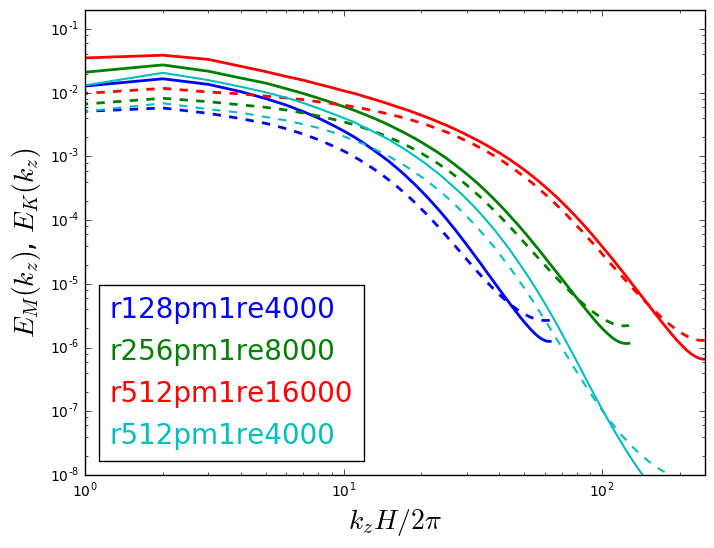

In [46]:
## to generate powerspectra of E(kz)
from powerspectra.pspec import get_pspec1dall
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

# # a shorter list for paper:
targlist=[  'x2y4z1r128pm1re4000',\
             'x2y4z1r256pm1re8000',\
             'x2y4z1r512pm1re16000',\
              'x2y4z1r512pm1re4000'] #,\
             #'x2y4z1r256ideal','adb.r256.new']

# targlist=[  'x2y4z1r64pm1re4000',\
#              'x2y4z1r128pm1re4000',\
#              'x2y4z1r256pm1re4000']
# targlist=[  'x2y4z1r256pm1re8000',\
#              'x2y4z1r512pm1re8000']

prefac = 1. #4.*np.pi*2*4*1
clist = ['b','g','r','c','m','k','y','k']
lw = [2,2,2,1.5,1.5,2,2,1]
cnt = 0
matplotlib.rcParams['figure.figsize'] = (8,6)
for targname in targlist:
  ts,te,tstride=50,100,1
  if targname[6:9] == 'r64':
    nkx,nky,nkz = 64,63,32
  if targname[6:10] == 'r128':
    nkx,nky,nkz = 128,126,64
  if targname[6:10] == 'r256':
    nkx,nky,nkz,ts,te,tstride=256,252,128,30,51,1
  if targname[6:10] == 'r512':
    nkx,nky,nkz,ts,te,tstride=512,504,256,30,51,1
  if targname[-4:] == '8000':
    ts,te,tstride= 50,100,1 #25,51,1
  if targname[-4:] == '8000' and targname[6:10] == 'r512':
    ts,te,tstride= 25,39,1
  if targname[-5:] == '16000':
    ts,te,tstride= 25,40,1
  if targname == 'x2y4z1r512pm1re4000':
    ts,te,tstride= 10,17,1 
  if targname == 'x2y4z1r256ideal':
    ts,te,tstride= 25,40,1
  if targname == 'adb.r256.new':
     nkx,nky,nkz,ts,te,tstride=256,252,128,10,30,1
     print 'reach adb256'
  ## pwra -shell_int kinetic; pwrb - shell_int magnetic
  ## pwrax - yz_int kinetic along kx axis etc.
  k,kx,ky,kz,pwra,pwrb,pwrax,pwrbx,pwray,pwrby,pwraz,pwrbz = get_pspec1dall(targname,nkx,nky,nkz,ts,te,tstride)
#   appfac = (k/(k.max()/2))**2
#   appfac[0:len(k)/2+1]=1
  appfac = 1.
  plt.plot(kz[:-1],pwraz[:-1]*prefac/appfac,'--'+clist[cnt],lw=lw[cnt]) #,label=targname[6:])+': '+r'$\rho v^2/2$')
  if (targname == 'adb.r256.new'):
    plt.plot(kz[:-1],pwrbz[:-1]*prefac/appfac,'-'+clist[cnt],lw=lw[cnt],label='r256adb')
  else:
    plt.plot(kz[:-1],pwrbz[:-1]*prefac/appfac,'-'+clist[cnt],lw=lw[cnt],label=targname[6:]) #+': '+r'$B^2/2$')
  cnt +=1
plt.xscale('log')
plt.yscale('log')
plt.xlim([1,250])
plt.ylim([1e-8,0.2])
plt.xlabel(r'$k_z H/2\pi$',fontsize=20)
plt.ylabel('power',fontsize=20)
plt.ylabel(r'$E_M(k_z)$, $E_K(k_z)$',fontsize=20)
amp = 0.01
#plt.plot(np.arange(0,100,0.1),amp*np.arange(0.01,100,0.1)**(-1.5),'k:',lw=2)

#plt.plot(np.arange(0,100,0.1),amp*np.arange(0.01,100,0.1)**(-1),'k:',lw=2)
#plt.plot(np.arange(0,100,0.1),amp*np.arange(0.01,100,0.1)**(-2),'k:',lw=2)
legend = plt.legend(fontsize=20,loc=3,handlelength=0, handletextpad=0)
cnt = 0
for item in legend.legendHandles:
    item.set_visible(False)
    
for text in legend.get_texts():
    plt.setp(text, color = clist[cnt])
    cnt +=1
plt.savefig('pwrspec_three.png', format='png', dpi=300)

## spectra of spherical shell integrated k-space 

reach adb256


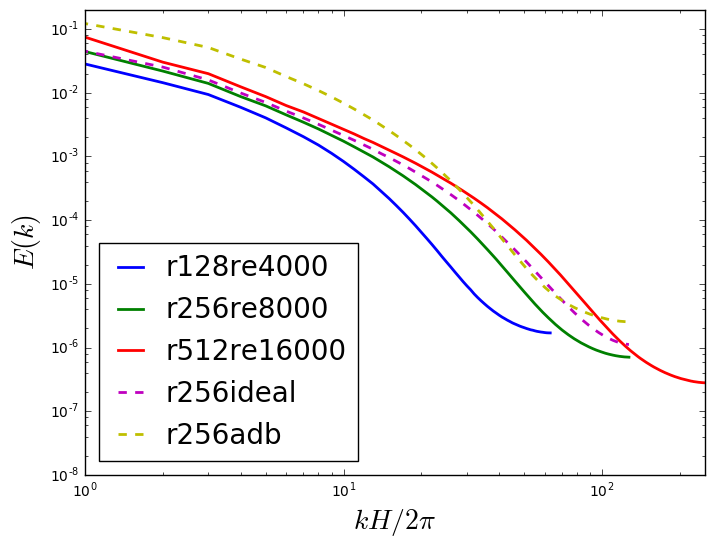

In [125]:
from powerspectra.pspec import get_pspec1dall
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

# # a shorter list for paper:
targlist=[   'x2y4z1r128pm1re4000',\
             'x2y4z1r256pm1re8000',\
             'x2y4z1r512pm1re16000',\
             'x2y4z1r256ideal',\
             'adb.r256.new']

# targlist=[  'x2y4z1r64pm1re4000',\
#              'x2y4z1r128pm1re4000',\
#              'x2y4z1r256pm1re4000']
# targlist=[  'x2y4z1r256pm1re8000',\
#             'x2y4z1r512pm1re8000']
lx,ly,lz=2,4,1
prefac = 4.*np.pi*lx*ly*lz
clist = ['b','g','r','m','y','k','c','k']
lw = [2,2,2,2,2,2,2,1]
cnt = 0
matplotlib.rcParams['figure.figsize'] = (8,6)
for targname in targlist:
  ts,te,tstride=50,100,1
  if targname[6:9] == 'r64':
    nkx,nky,nkz = 64,63,32
  if targname[6:10] == 'r128':
    nkx,nky,nkz = 128,126,64
  if targname[6:10] == 'r256':
    nkx,nky,nkz,ts,te,tstride=256,252,128,30,51,1
  if targname[6:10] == 'r512':
    nkx,nky,nkz,ts,te,tstride=512,504,256,30,51,1
  if targname[-4:] == '8000':
    ts,te,tstride= 50,100,1 #25,51,1
  if targname[-4:] == '8000' and targname[6:10] == 'r512':
    ts,te,tstride= 25,39,1
  if targname[-5:] == '16000':
    ts,te,tstride= 25,40,1
  if targname == 'x2y4z1r512pm1re4000':
    ts,te,tstride= 10,17,1 
  if targname == 'x2y4z1r256ideal':
    ts,te,tstride= 25,40,1
  if targname == 'adb.r256.new':
     nkx,nky,nkz,ts,te,tstride=256,252,128,10,30,1
#   if targname == 'x2y4z1r256pm1re8000':
#      nkx,nky,nkz,ts,te,tstride=256,252,128,50,51,1
     print 'reach adb256'
  ## pwra -shell_int kinetic; pwrb - shell_int magnetic
  ## pwrax - yz_int kinetic along kx axis etc.
  k,kx,ky,kz,pwra,pwrb,pwrax,pwrbx,pwray,pwrby,pwraz,pwrbz = get_pspec1dall(targname,nkx,nky,nkz,ts,te,tstride)
  kymax = int(k[int(nky/ly)])
  appfac = np.zeros(len(k))
  appfac[0:kymax] = 1.0
  appfac[kymax:] = k[kymax:]/kymax # in order to remove the excessive volume due to low resol in ydir
  #plt.plot(k[:-1],pwra[:-1]*prefac/appfac[:-1],'--'+clist[cnt],lw=lw[cnt]) #,label=targname[6:])+': '+r'$\rho v^2/2$')
  if (targname == 'adb.r256.new'):
    plt.plot(k[:-1],(pwra[:-1]+pwrb[:-1])*prefac/appfac[:-1],'--'+clist[cnt],lw=lw[cnt],label='r256adb')
  else:
    if (targname == 'x2y4z1r256ideal'):
      plt.plot(k[:-1],(pwra[:-1]+pwrb[:-1])*prefac/appfac[:-1],'--'+clist[cnt],lw=lw[cnt],label=targname[6:])
    else:
      plt.plot(k[:-1],(pwra[:-1]+pwrb[:-1])*prefac/appfac[:-1],'-'+clist[cnt],lw=lw[cnt],label=targname[6:10]+targname[13:]) #+': '+r'$B^2/2$')
  cnt +=1
plt.xscale('log')
plt.yscale('log')
plt.xlim([1,250])
plt.ylim([1e-8,0.2])
#plt.ylim([1e-6,1e-5])
plt.xlabel(r'$kH/2\pi$',fontsize=20)
plt.ylabel('power',fontsize=20)
#plt.ylabel(r'$E_M(k)$, $E_K(k)$',fontsize=20)
plt.ylabel(r'$E(k)$',fontsize=20)
amp = 0.01
#plt.plot(np.arange(0,100,0.1),amp*np.arange(0.01,100,0.1)**(-1.5),'k:',lw=2)

#plt.plot(np.arange(0,100,0.1),amp*np.arange(0.01,100,0.1)**(-1),'k:',lw=2)
#plt.plot(np.arange(0,100,0.1),amp*np.arange(0.01,100,0.1)**(-2),'k:',lw=2)
legend = plt.legend(fontsize=20,loc=3,handlelength=1.5,handletextpad=0.5)

#legend = plt.legend(fontsize=20,loc=3,handlelength=0, handletextpad=0)
#cnt = 0
# for item in legend.legendHandles:
#     item.set_visible(False)
    
# for text in legend.get_texts():
#     plt.setp(text, color = clist[cnt])
#     cnt +=1
plt.savefig('pwrspec_five.png', format='png', dpi=300)

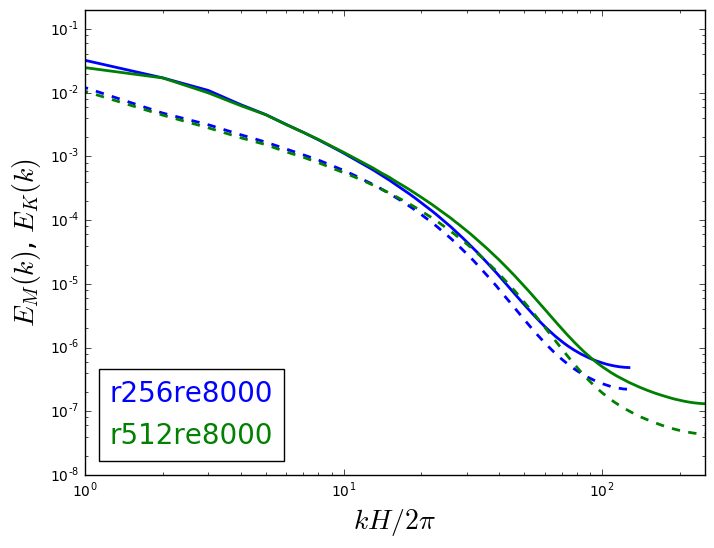

In [129]:
from powerspectra.pspec import get_pspec1dall
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

# # a shorter list for paper:
# targlist=[   'x2y4z1r128pm1re4000',\
#              'x2y4z1r256pm1re8000',\
#              'x2y4z1r512pm1re16000',\
#              'x2y4z1r256ideal',\
#              'adb.r256.new']

targlist=[  'x2y4z1r64pm1re4000',\
             'x2y4z1r128pm1re4000',\
             'x2y4z1r256pm1re4000',\
              'x2y4z1r512pm1re4000']
targlist=[  'x2y4z1r256pm1re8000',\
             'x2y4z1r512pm1re8000']
lx,ly,lz=2,4,1
prefac = 4.*np.pi*lx*ly*lz
clist = ['b','g','r','m','y','k','c','k']
lw = [2,2,2,2,2,2,2,1]
cnt = 0
matplotlib.rcParams['figure.figsize'] = (8,6)
for targname in targlist:
  ts,te,tstride=50,100,1
  if targname[6:9] == 'r64':
    nkx,nky,nkz = 64,63,32
  if targname[6:10] == 'r128':
    nkx,nky,nkz = 128,126,64
  if targname[6:10] == 'r256':
    nkx,nky,nkz,ts,te,tstride=256,252,128,30,51,1
  if targname[6:10] == 'r512':
    nkx,nky,nkz,ts,te,tstride=512,504,256,30,51,1
  if targname[-4:] == '8000':
    ts,te,tstride= 50,100,1 #25,51,1
  if targname[-4:] == '8000' and targname[6:10] == 'r512':
    ts,te,tstride= 25,39,1
  if targname[-5:] == '16000':
    ts,te,tstride= 25,40,1
  if targname == 'x2y4z1r512pm1re4000':
    ts,te,tstride= 11,18,1
  if targname == 'x2y4z1r256ideal':
    ts,te,tstride= 25,40,1
  if targname == 'adb.r256.new':
     nkx,nky,nkz,ts,te,tstride=256,252,128,10,30,1
#   if targname == 'x2y4z1r256pm1re8000':
#      nkx,nky,nkz,ts,te,tstride=256,252,128,50,51,1
     print 'reach adb256'
  ## pwra -shell_int kinetic; pwrb - shell_int magnetic
  ## pwrax - yz_int kinetic along kx axis etc.
  k,kx,ky,kz,pwra,pwrb,pwrax,pwrbx,pwray,pwrby,pwraz,pwrbz = get_pspec1dall(targname,nkx,nky,nkz,ts,te,tstride)
  kymax = int(k[int(nky/ly)])
  appfac = np.zeros(len(k))
  appfac[0:kymax] = 1.0
  appfac[kymax:] = k[kymax:]/kymax # in order to remove the excessive volume due to low resol in ydir
  
  plt.plot(k[:-1],pwra[:-1]*prefac/appfac[:-1],'--'+clist[cnt],lw=lw[cnt]) #,label=targname[6:])+': '+r'$\rho v^2/2$')
  if (targname == 'adb.r256.new'):
    plt.plot(k[:-1],(pwrb[:-1])*prefac/appfac[:-1],'-'+clist[cnt],lw=lw[cnt],label='r256adb')
  else:
    if targname == 'x2y4z1r64pm1re4000':
      plt.plot(k[:-1],(pwrb[:-1])*prefac/appfac[:-1],'-'+clist[cnt],lw=lw[cnt],label=targname[6:9]+targname[12:]) #+': '+r'$B^2/2$')
    else:
      plt.plot(k[:-1],(pwrb[:-1])*prefac/appfac[:-1],'-'+clist[cnt],lw=lw[cnt],label=targname[6:10]+targname[13:]) #+': '+r'$B^2/2$')
  cnt +=1
plt.xscale('log')
plt.yscale('log')
plt.xlim([1,250])
plt.ylim([1e-8,0.2])
#plt.ylim([1e-6,1e-5])
plt.xlabel(r'$kH/2\pi$',fontsize=20)
plt.ylabel('power',fontsize=20)
plt.ylabel(r'$E_M(k)$, $E_K(k)$',fontsize=20)
#plt.ylabel(r'$E(k)$',fontsize=20)

#legend = plt.legend(fontsize=20,loc=3,handlelength=1.5,handletextpad=0.5)

legend = plt.legend(fontsize=20,loc=3,handlelength=0, handletextpad=0)
cnt = 0
for item in legend.legendHandles:
    item.set_visible(False)
    
for text in legend.get_texts():
    plt.setp(text, color = clist[cnt])
    cnt +=1
#plt.savefig('pwrspec_re4000.png', format='png', dpi=300)
plt.savefig('pwrspec_re8000.png', format='png', dpi=300)

## cylindrical shell integration to get $E(k_{\perp})$ over $k_{\perp}$

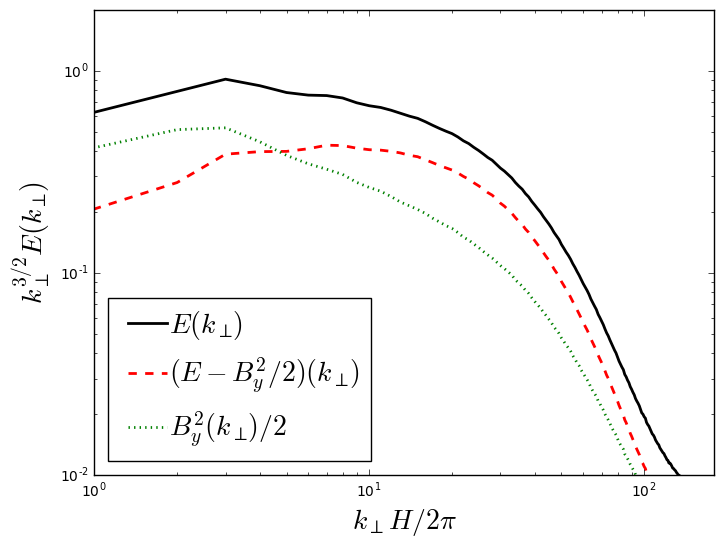

In [51]:
from powerspectra.pspec_kperp import get_pspec1dall
from powerspectra.pspec_kperp import get_pspec1d_kperp
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

lx,ly,lz=2,4,1
prefac = (4.*np.pi)**2*(lx*ly*lz)*2/np.pi
clist = ['k','r','g','m','y','k','c','k']
lw = [2,2,2,2,2,2,2,1]
cnt = 0
matplotlib.rcParams['figure.figsize'] = (8,6)

targname = 'x2y4z1r512pm1re16000'
ts,te,tstride= 25,31,1
nkx,nky,nkz=512,504,256


# targname = 'x2y4z1r256pm1re4000'
# ts,te,tstride= 30,50,1
# nkx,nky,nkz=256,252,128
## pwra -shell_int kinetic; pwrb - shell_int magnetic
## pwrax - yz_int kinetic along kx axis etc.
##k,kx,ky,kz,pwra,pwrb,pwrax,pwrbx,pwray,pwrby,pwraz,pwrbz = get_pspec1dall(targname,nkx,nky,nkz,ts,te,tstride)
k,pwra,pwrb,pwrby = get_pspec1d_kperp(targname,ts,te,tstride,noby=True,nk=256) #nk=128)
appfac=np.ones(k.shape)
prefac=nky**2/ly**2


plt.plot(k[:-1],k[:-1]**1.5*(pwrb[:-1]+pwra[:-1]+pwrby[:-1])*prefac/appfac[:-1],'-'+clist[0],lw=lw[cnt],\
         label=r'$E(k_{\perp}\!)$')

plt.plot(k[:-1],k[:-1]**1.5*(pwrb[:-1]+pwra[:-1])*prefac/appfac[:-1],'--'+clist[1],lw=lw[cnt],\
         label=r'$(E-B_y^2/2)(k_{\perp}\!)$')

plt.plot(k[:-1],k[:-1]**1.5*pwrby[:-1]*prefac/appfac[:-1],':'+clist[2],lw=lw[cnt],\
         label=r'$B_y^2(k_{\perp}\!)/2$')

cnt +=1
plt.xscale('log')
plt.yscale('log')
plt.xlim([1,180])
plt.ylim([0.01,2.])
plt.xlabel(r'$k_{\perp}H/2\pi$',fontsize=20)
#plt.xlabel(r'$k_{\perp}$',fontsize=20)
plt.ylabel('power',fontsize=20)
plt.ylabel(r'$k_{\perp}^{3/2}E(k_{\perp}\!)$',fontsize=20)
# amp = 1.2
# xshift,yshift=15,0.1
# x=np.arange(xshift,70,0.1)
# y=(x/xshift)
# plt.plot(x,yshift+amp*y**(1.5-1.5),'k:',lw=2)
# plt.plot(x,yshift+amp*y**(1.5-5./3.),'k:',lw=2)
# plt.plot(x,yshift+amp*y**(1.5-2.0),'k:',lw=2)

# xpos=76;ypos=1.2
# plt.annotate(r'$k_{\perp}^{-3/2}$',xy=(xpos,ypos),fontsize=20)
# plt.annotate(r'$k_{\perp}^{-5/3}$',xy=(xpos,ypos-0.3),fontsize=20)
# plt.annotate(r'$k_{\perp}^{-2}$',xy=(xpos,ypos-0.55),fontsize=20)

legend = plt.legend(fontsize=20,loc=3,handlelength=2, handletextpad=-0.2)
# cnt = 0
# for item in legend.legendHandles:
#     item.set_visible(False)
    
# for text in legend.get_texts():
#     plt.setp(text, color = clist[cnt])
#     cnt +=1

plt.savefig('pwrspec_re16000_kperp.png', format='png', dpi=300)

# 2 dissipation statistics

### 2.1 cumulative distribution function of current density and volume of current sheets as a function of threshold value


* linewidth for different runs(the thicker, the larger Rm); color: blue for dissipation, green for volume. 
* left panel for current density; right panel for vorticity.

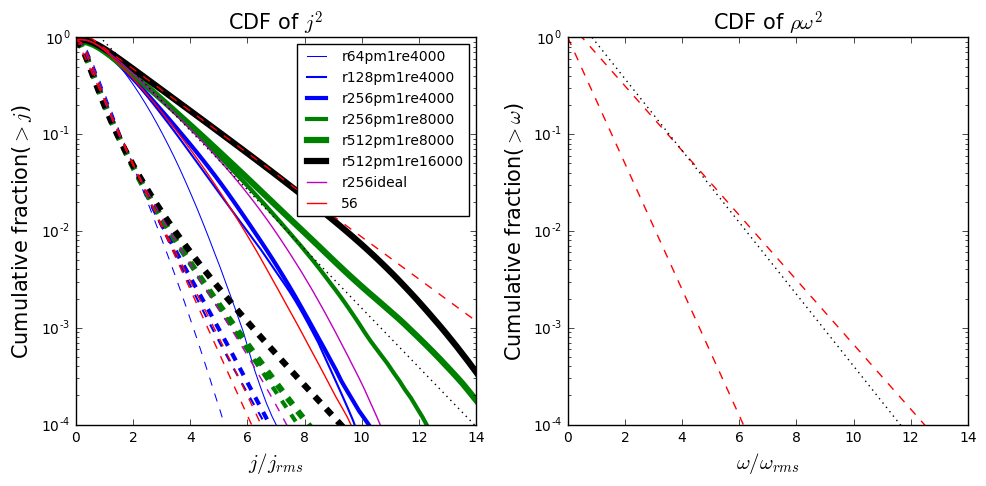

In [63]:
direname='/tigress/jiming/reconnect/athena/bin/'
basename='Unstra.out2.'
targlist=['x2y4z1r64pm1re4000','x2y4z1r128pm1re4000','x2y4z1r256pm1re4000',\
          'x2y4z1r256pm1re8000','x2y4z1r512pm1re8000',\
          'x2y4z1r512pm1re16000','x2y4z1r256ideal','adb.r256.new']


linewidth = [0.75,1.5,3,3,4.5,4.5,1,1]  #width for various resolution
linestyle = [':',':',':','--',':','--','-','--'] # linestyle to show various Re
ctable = ['b','b','b','g','g','k','m','r','r']
count = 0
matplotlib.rcParams['figure.figsize'] = (10,5)

##(1) draw current sheet cdf
appdname='.athdf.jcdf.tab'
plt.subplot(1,2,1)
for targ in targlist:
  ts,te,tstride = 30,50,1
  label = targ[6:]
  if targ == 'x2y4z1r64pm1re4000':
    ts,te,tstride = 50,100,1
  elif targ == 'x2y4z1r128pm1re4000':
    ts,te,tstride =50,75,1 #50, 100,1 #
  elif targ == 'x2y4z1r256pm1re4000':
    ts,te,tstride = 34,45,1 #30,50,1 #
  elif targ == 'x2y4z1r256pm1re8000':
    ts,te,tstride = 50,65,1 #50,65,1 #
  elif targ == 'x2y4z1r512pm1re8000':
    ts,te,tstride = 30,40,1 #30,36,1 #
  elif targ == 'x2y4z1r512pm1re4000':
    ts,te,tstride = 10,19,1
  elif targ == 'adb.r256':
    ts,te,tstride = 10,31,1
  else:
    ts,te,tstride = 30,50,1
#   elif targ[7:9]=='64':
#     appdname = '.athdf.jcdf2.tab'
#   elif targ[7:10]!='512':
#     appdname = '.athdf.jcdf3.tab'
#   else:
#     appdname = '.athdf.jcdf.tab'
  #print targ,ts,te,tstride
  nbin = 100; nt = (te-ts+1.)/tstride
  jth2 = np.zeros(nbin)
  cdfj2 = np.zeros(nbin)
  cdfvol = np.zeros(nbin)
  for i in np.arange(ts,te,tstride):
    fname = direname+targ+'/'+basename+str(i).zfill(5)+appdname
    dtype1 = np.dtype([('jth2', 'f8'), ('cdfj2', 'f8'),('cdfvol','f8')])
    ahist = np.loadtxt(fname, dtype=dtype1, usecols=(0,1,2))
    cdfj2 += ahist['cdfj2']
    cdfvol += ahist['cdfvol']

  jth = (ahist['jth2'])**0.5
  cdfj2 /= float(nt)
  cdfvol /= float(nt)
  plt.plot(jth,cdfj2,ctable[count]+'-',linewidth=linewidth[count],label=label)
  plt.plot(jth,cdfvol,ctable[count]+'--',linewidth=linewidth[count])
  count +=1
    
plt.yscale('log')
plt.xlim([0,14])
plt.ylim([1e-4,1])
plt.plot(jth,np.exp(-(jth-0.5)/2),'r--')
plt.plot(jth,np.exp(-jth*1.5),'r--')
plt.plot(jth,np.exp(-(jth-0.85)/1.42),'k:')
plt.title('CDF of '+r'$j^2$',fontsize=15)
plt.xlabel(r'$j/j_{rms}$',fontsize=15)
plt.ylabel('Cumulative fraction'+r'($>j$)',fontsize=15)
plt.legend(loc=1,fontsize=10)


# targlist=['x2y4z1r64pm1re4000','x2y4z1r128pm1re4000','x2y4z1r256pm1re4000',\
#           'x2y4z1r256pm1re8000','x2y4z1r512pm1re8000',\
#           'x2y4z1r512pm1re16000']# 'x2y4z1r512pm1re4000'
## (2) draw vorticity sheet cdf
appdname='.athdf.vcdf.tab'
plt.subplot(1,2,2)
# count = 0
# for targ in targlist:
#   ts,te,tstride = 30,50,1
#   label = targ[6:]
#   if targ == 'x2y4z1r64pm1re4000':
#     ts,te,tstride = 50,101,1
#   elif targ == 'x2y4z1r128pm1re4000':
#     ts,te,tstride = 50,75,1
#   elif targ == 'x2y4z1r256pm1re4000':
#     ts,te,tstride = 35,45,1
#   elif targ == 'x2y4z1r256pm1re8000':
#     ts,te,tstride = 50,65,1
#   elif targ == 'x2y4z1r512pm1re8000':
#     ts,te,tstride = 30,36,1#30,40,1
#   elif targ == 'x2y4z1r512pm1re4000':
#     ts,te,tstride = 10,19,1
#   else:
#     ts,te,tstride = 30,50,1
#   #print targ,ts,te,tstride
#   nbin = 100; nt = te-ts+1
#   jth2 = np.zeros(nbin)
#   cdfj2 = np.zeros(nbin)
#   cdfvol = np.zeros(nbin)
#   for i in np.arange(ts,te,tstride):
#     fname = direname+targ+'/'+basename+str(i).zfill(5)+appdname
#     dtype1 = np.dtype([('jth2', 'f8'), ('cdfj2', 'f8'),('cdfvol','f8')])
#     ahist = np.loadtxt(fname, dtype=dtype1, usecols=(0,1,2))
#     cdfj2 += ahist['cdfj2']
#     cdfvol += ahist['cdfvol']

#   jth = (ahist['jth2'])**0.5
#   cdfj2 /= float(nt)
#   cdfvol /= float(nt)
#   plt.plot(jth,cdfj2,ctable[count]+'-',linewidth=linewidth[count], label=label)
#   plt.plot(jth,cdfvol,ctable[count]+'--',linewidth=linewidth[count])
#   count +=1
    
# plt.yscale('log')
# plt.xlim([0,14])
# plt.ylim([1e-4,1])
# plt.plot(jth,np.exp(-(jth-0.5)/1.3),'r--')
# plt.plot(jth,np.exp(-(jth*1.5)),'r--')
# plt.plot(jth,np.exp(-(jth-0.85)/1.17),'k:')
# plt.title('CDF of $\omega^2$',fontsize=15)
# plt.xlabel(r'$\omega/\omega_{rms}$',fontsize=15)
# plt.ylabel('Cumulative fraction'+r'($>\omega$)',fontsize=15)
# #plt.legend(loc=1,fontsize=7)


## (3) draw vorticity cdf2 (with density weight) overlays
appdname='.athdf.vcdf2.tab'
count = 0
# for targ in targlist:
#   ts,te,tstride = 30,50,1
#   label = targ[6:]
#   if targ == 'x2y4z1r64pm1re4000':
#     ts,te,tstride = 50,101,1
#   elif targ == 'x2y4z1r128pm1re4000':
#     ts,te,tstride = 50,75,1
#   elif targ == 'x2y4z1r256pm1re4000':
#     ts,te,tstride = 35,45,1
#   elif targ == 'x2y4z1r256pm1re8000':
#     ts,te,tstride = 50,65,1
#   elif targ == 'x2y4z1r512pm1re8000':
#     ts,te,tstride = 30,44,1#30,36,1
#   elif targ == 'x2y4z1r512pm1re4000':
#     ts,te,tstride = 10,19,1
#   else:
#     ts,te,tstride = 30,50,1
#   #print targ,ts,te,tstride
#   nbin = 100; nt = te-ts+1
#   jth2 = np.zeros(nbin)
#   cdfj2 = np.zeros(nbin)
#   cdfvol = np.zeros(nbin)
#   cdfj2w2 = np.zeros(nbin)
#   cdfvolw2 = np.zeros(nbin)
#   for i in np.arange(ts,te,tstride):
#     fname = direname+targ+'/'+basename+str(i).zfill(5)+appdname
#     dtype1 = np.dtype([('jth2', 'f8'), ('cdfj2', 'f8'),('cdfj2w2','f8'),('cdfvol','f8'),('cdfvolw2','f8')])
#     ahist = np.loadtxt(fname, dtype=dtype1, usecols=(0,1,2,3,4))
#     cdfj2 += ahist['cdfj2']
#     cdfvol += ahist['cdfvol']
#     cdfj2w2 += ahist['cdfj2w2']
#     cdfvolw2 += ahist['cdfvolw2']
    
#   jth = (ahist['jth2'])**0.5
#   cdfj2 /= float(nt)
#   cdfvol /= float(nt)
#   cdfj2w2 /= float(nt)
#   cdfvolw2 /= float(nt)
# #   plt.plot(jth,cdfj2,'y-', label=r'$\Phi$')
# #   plt.plot(jth,cdfvol,'y--',label=r'$vol(\Phi)$')
# #  plt.plot(jth,cdfj2w2,'c-',label=r'$\rho\nu\omega^2$')
# #  plt.plot(jth,cdfvolw2,'c--',label=r'$vol(\rho\nu\omega^2)$')
#   plt.plot(jth,cdfj2w2,ctable[count]+'-',linewidth=linewidth[count], label=label)
#   plt.plot(jth,cdfvolw2,ctable[count]+'--',linewidth=linewidth[count])
#   count +=1
    
plt.yscale('log')
plt.xlim([0,14])
plt.ylim([1e-4,1])
plt.plot(jth,np.exp(-(jth-0.5)/1.3),'r--')
plt.plot(jth,np.exp(-(jth*1.5)),'r--')
plt.plot(jth,np.exp(-(jth-0.85)/1.17),'k:')
plt.title('CDF of '+r'$\rho \omega^2$',fontsize=15)
plt.xlabel(r'$\omega/\omega_{rms}$',fontsize=15)
plt.ylabel('Cumulative fraction'+r'($>\omega$)',fontsize=15)
    
plt.legend(loc=1,fontsize=10)
    
#   jth = (ahist['jth2'])**0.5
#   cdfj2 /= float(nt)
#   cdfvol /= float(nt)
#   plt.plot(jth,cdfj2,ctable[count]+'-',linewidth=linewidth[count], label=label)
#   plt.plot(jth,cdfvol,ctable[count]+'--',linewidth=linewidth[count])
#   count +=1
    

# #plt.legend(loc=1,fontsize=7)
plt.tight_layout()
plt.savefig('cdf_all.png', format='png', dpi=300)

In [117]:
####################################################################
## explore different differentiation effects while calc j2 and w2
####################################################################
# direname='/tigress/jiming/reconnect/athena/bin/'
# basename='Unstra.out2.'
# targlist=['x2y4z1r64pm1re4000','x2y4z1r128pm1re4000','x2y4z1r256pm1re4000',\
#           'x2y4z1r256pm1re8000','x2y4z1r512pm1re4000','x2y4z1r512pm1re8000',\
#           'x2y4z1r512pm1re16000']


# linewidth = [0.75,1.5,3,3,4.5,4.5,4.5]  #width for various resolution
# linestyle = [':',':',':','--',':','--','-'] # linestyle to show various Re
# ctable = ['b','b','b','g','b','g','k']
# count = 0
# matplotlib.rcParams['figure.figsize'] = (10,5)


# plt.subplot(1,2,1)
# targ = 'x2y4z1r128pm1re4000'
# for nf in np.arange(3):
#   if nf==0: 
#     appdname = '.athdf.jcdf.tab'
#     label='gradient'
#   elif nf==1:
#     appdname = '.athdf.jcdf2.tab'
#     label='dbl in yz'
#   else:
#     appdname = '.athdf.jcdf3.tab'
#     label='dbl in xyz'
#   ts,te,tstride = 50,90,1 #50,70,1
#   nbin = 100; nt = te-ts+1
#   jth2 = np.zeros(nbin)
#   cdfj2 = np.zeros(nbin)
#   cdfvol = np.zeros(nbin)
#   for i in np.arange(ts,te,tstride):
#     fname = direname+targ+'/'+basename+str(i).zfill(5)+appdname
#     dtype1 = np.dtype([('jth2', 'f8'), ('cdfj2', 'f8'),('cdfvol','f8')])
#     ahist = np.loadtxt(fname, dtype=dtype1, usecols=(0,1,2))
#     cdfj2 += ahist['cdfj2']
#     cdfvol += ahist['cdfvol']

#   jth = (ahist['jth2'])**0.5
#   cdfj2 /= float(nt)
#   cdfvol /= float(nt)
#   plt.plot(jth,cdfj2,ctable[count]+'-',linewidth=linewidth[count],label=label)
#   plt.plot(jth,cdfvol,ctable[count]+'--',linewidth=linewidth[count])
#   count +=1
    
# plt.yscale('log')
# plt.xlim([0,14])
# plt.ylim([1e-4,1])
# plt.plot(jth,np.exp(-(jth-0.5)/2),'r--')
# plt.plot(jth,np.exp(-jth*1.5),'r--')
# plt.plot(jth,np.exp(-(jth-0.85)/1.42),'k:')
# plt.title('CDF of '+r'$j^2$',fontsize=15)
# plt.xlabel(r'$j/j_{rms}$',fontsize=15)
# plt.ylabel('Cumulative fraction'+r'($>j$)',fontsize=15)
# plt.legend(loc=1,fontsize=8)

In [124]:
# plt.subplot(1,2,1)
# targ = 'x2y4z1r128pm1re4000'
# for nf in np.arange(1):
#   if nf==0: 
#     appdname = '.athdf.jcdf.tab'
#     label='gradient'
#   elif nf==1:
#     appdname = '.athdf.jcdf2.tab'
#     label='dbl in yz'
#   else:
#     appdname = '.athdf.jcdf3.tab'
#     label='dbl in xyz'
#   ts,te,tstride = 50,75,1 #30,43,2 #37,43,1 #50,70,1
#   nbin = 100; nt = (te-ts+1)/tstride
#   j2avg = np.zeros(nbin)
#   volavg = np.zeros(nbin)
#   for i in np.arange(ts,te,tstride):
#     fname = direname+targ+'/'+basename+str(i).zfill(5)+appdname
#     dtype1 = np.dtype([('jth2', 'f8'), ('cdfj2', 'f8'),('cdfvol','f8')])
#     ahist = np.loadtxt(fname, dtype=dtype1, usecols=(0,1,2))
#     cdfj2 = ahist['cdfj2']
#     cdfvol = ahist['cdfvol']
# #     j2avg +=np.log10(cdfj2)
# #     volavg +=np.log10(cdfvol)
#     j2avg += cdfj2
#     volavg += cdfvol
#     jth = (ahist['jth2'])**0.5
#     label=str(i)
#     plt.plot(jth,cdfj2,'-',linewidth=0.5,label=label)
#     plt.plot(jth,cdfvol,'g--',linewidth=0.2)

# j2avg /=float(nt)
# volavg /=float(nt)
# #j2avg = 10.**j2avg
# #volavg = 10.**volavg
# plt.plot(jth,j2avg,'k-')
# plt.plot(jth,volavg,'g-')
# plt.yscale('log')
# #plt.xscale('log')
# plt.xlim([0,14])
# plt.ylim([1e-4,1])
# plt.plot(jth,np.exp(-(jth-0.5)/2),'r--')
# plt.plot(jth,np.exp(-jth*1.5),'r--')
# plt.plot(jth,np.exp(-(jth-0.85)/1.42),'k:')
# plt.title('CDF of '+r'$j^2$',fontsize=15)
# plt.xlabel(r'$j/j_{rms}$',fontsize=15)
# plt.ylabel('Cumulative fraction'+r'($>j$)',fontsize=15)
# plt.legend(loc=1,fontsize=8)




# plt.subplot(1,2,2)
# targ = 'x2y4z1r256pm1re4000'
# for nf in np.arange(1):
#   if nf==0: 
#     appdname = '.athdf.jcdf.tab'
#     label='gradient'
#   elif nf==1:
#     appdname = '.athdf.jcdf2.tab'
#     label='dbl in yz'
#   else:
#     appdname = '.athdf.jcdf3.tab'
#     label='dbl in xyz'
#   ts,te,tstride = 34,45,1 #65,75,1 #50,70,1
#   nbin = 100; nt = (te-ts+1)/float(tstride)
#   j2avg = np.zeros(nbin)
#   volavg = np.zeros(nbin)
#   for i in np.arange(ts,te,tstride):
#     fname = direname+targ+'/'+basename+str(i).zfill(5)+appdname
#     dtype1 = np.dtype([('jth2', 'f8'), ('cdfj2', 'f8'),('cdfvol','f8')])
#     ahist = np.loadtxt(fname, dtype=dtype1, usecols=(0,1,2))
#     cdfj2 = ahist['cdfj2']
#     cdfvol = ahist['cdfvol']
#     #j2avg +=np.log10(cdfj2)
#     #volavg +=np.log10(cdfvol)
#     j2avg += cdfj2
#     volavg += cdfvol
#     jth = (ahist['jth2'])**0.5
#     label=str(i)
#     plt.plot(jth,cdfj2,'-',linewidth=0.5,label=label)
#     plt.plot(jth,cdfvol,'g--',linewidth=0.2)

# j2avg /=float(nt)
# volavg /=float(nt)
# #j2avg = 10.**j2avg
# #volavg = 10.**volavg
# plt.plot(jth,j2avg,'k-',linewidth=2)
# plt.plot(jth,volavg,'g-')
# plt.yscale('log')
# #plt.xscale('log')
# plt.xlim([0,14])
# plt.ylim([1e-4,1])
# plt.plot(jth,np.exp(-(jth-0.5)/2),'r--')
# plt.plot(jth,np.exp(-jth*1.5),'r--')
# plt.plot(jth,np.exp(-(jth-0.85)/1.42),'k:')
# plt.title('CDF of '+r'$j^2$',fontsize=15)
# plt.xlabel(r'$j/j_{rms}$',fontsize=15)
# plt.ylabel('Cumulative fraction'+r'($>j$)',fontsize=15)
# plt.legend(loc=1,fontsize=8)

* time variation of the CDF:  we need longer time average, as the shallower CDF, which usually associates with spike of $\alpha$, dominates the time average. (or we can separate the peak and trough, and study separately)

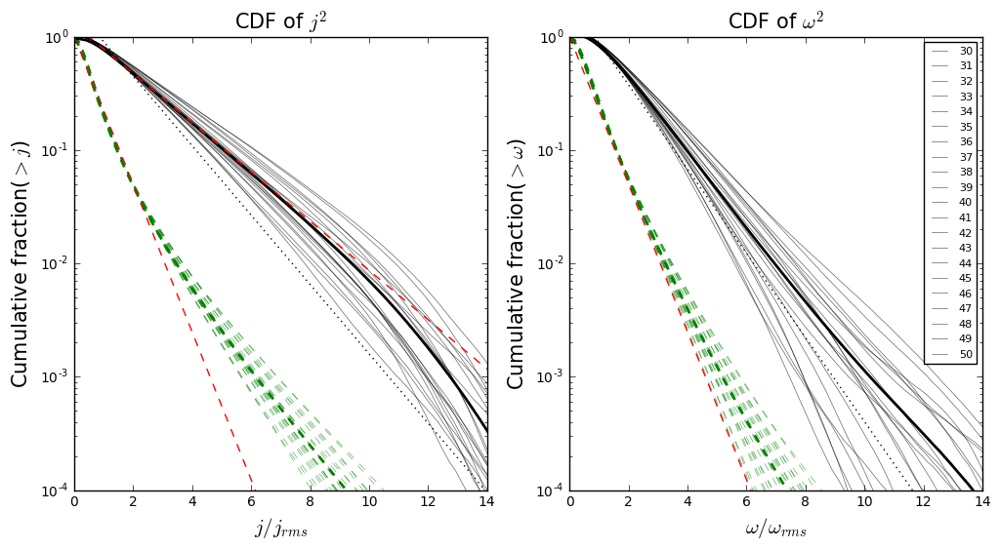

In [183]:
matplotlib.rcParams['figure.figsize'] = (12, 6.0)
plt.subplot(1,2,1)
targ = 'x2y4z1r512pm1re16000'
#targ = 'x2y4z1r512pm1re8000'
for nf in np.arange(1):
  if nf==0: 
    appdname = '.athdf.jcdf.tab'
    label='gradient'
  elif nf==1:
    appdname = '.athdf.jcdf2.tab'
    label='dbl in yz'
  else:
    appdname = '.athdf.jcdf3.tab'
    label='dbl in xyz'
  ts,te,tstride = 30,51,1 #30,43,2 #37,43,1 #50,70,1
 # ts,te,tstride = 30,49,1
  nbin = 100; nt = (te-ts+1)/tstride
  j2avg = np.zeros(nbin)
  volavg = np.zeros(nbin)
  for i in np.arange(ts,te,tstride):
    fname = direname+targ+'/'+basename+str(i).zfill(5)+appdname
    dtype1 = np.dtype([('jth2', 'f8'), ('cdfj2', 'f8'),('cdfvol','f8')])
    ahist = np.loadtxt(fname, dtype=dtype1, usecols=(0,1,2))
    cdfj2 = ahist['cdfj2']
    cdfvol = ahist['cdfvol']
#     j2avg +=np.log10(cdfj2)
#     volavg +=np.log10(cdfvol)
    j2avg += cdfj2
    volavg += cdfvol
    jth = (ahist['jth2'])**0.5
    label=str(i)
    plt.plot(jth,cdfj2,'k-',linewidth=0.5,label=label,alpha=0.6)
    plt.plot(jth,cdfvol,'g--',linewidth=0.5,alpha=0.6)

j2avg /=float(nt)
volavg /=float(nt)
#j2avg = 10.**j2avg
#volavg = 10.**volavg
plt.plot(jth,j2avg,'k-',linewidth=2)
plt.plot(jth,volavg,'g--',linewidth=2)
plt.yscale('log')
#plt.xscale('log')
plt.xlim([0,14])
plt.ylim([1e-4,1])
plt.plot(jth,np.exp(-(jth-0.5)/2),'r--')
plt.plot(jth,np.exp(-jth*1.5),'r--')
plt.plot(jth,np.exp(-(jth-0.85)/1.42),'k:')
plt.title('CDF of '+r'$j^2$',fontsize=15)
plt.xlabel(r'$j/j_{rms}$',fontsize=15)
plt.ylabel('Cumulative fraction'+r'($>j$)',fontsize=15)
#plt.legend(loc=1,fontsize=8)




plt.subplot(1,2,2)

for nf in np.arange(1):
  if nf==0: 
    appdname = '.athdf.vcdf.tab'
    appdname = '.athdf.vcdf2.tab'
    label='gradient'
  elif nf==1:
    appdname = '.athdf.jcdf2.tab'
    label='dbl in yz'
  else:
    appdname = '.athdf.jcdf3.tab'
    label='dbl in xyz'

  j2avg = np.zeros(nbin)
  volavg = np.zeros(nbin)      
  for i in np.arange(ts,te,tstride):
    fname = direname+targ+'/'+basename+str(i).zfill(5)+appdname
    dtype1 = np.dtype([('jth2', 'f8'), ('cdfj2', 'f8'),('cdfj2w2','f8'),('cdfvol','f8'),('cdfvolw2','f8')])
    ahist = np.loadtxt(fname, dtype=dtype1, usecols=(0,1,2,3,4))
    cdfj2 = ahist['cdfj2w2']
    cdfvol = ahist['cdfvolw2']
    #j2avg +=np.log10(cdfj2)
    #volavg +=np.log10(cdfvol)
    j2avg += cdfj2
    volavg += cdfvol
    jth = (ahist['jth2'])**0.5
    label=str(i)
    plt.plot(jth,cdfj2,'k-',linewidth=0.5,label=label,alpha=0.6)
    plt.plot(jth,cdfvol,'g--',linewidth=0.5,alpha=0.6)

j2avg /=float(nt)
volavg /=float(nt)
#j2avg = 10.**j2avg
#volavg = 10.**volavg
plt.plot(jth,j2avg,'k-',linewidth=2)
plt.plot(jth,volavg,'g--',linewidth=2)
plt.yscale('log')
#plt.xscale('log')
plt.xlim([0,14])
plt.ylim([1e-4,1])
#plt.plot(jth,np.exp(-(jth-0.5)/2),'r--')
plt.plot(jth,np.exp(-jth*1.5),'r--')
plt.plot(jth,np.exp(-(jth-0.85)/1.17),'k:')
plt.title('CDF of '+r'$\omega^2$',fontsize=15)
plt.xlabel(r'$\omega/\omega_{rms}$',fontsize=15)
plt.ylabel('Cumulative fraction'+r'($>\omega$)',fontsize=15)
plt.legend(loc=1,fontsize=8)




## 2.2 channel mode burst vs. quiescent turbulence

* shallower vs. steeper slope of CDF: channel mode favors stronger current and vorticit 

[38, 44, 45, 46]
[40, 41]


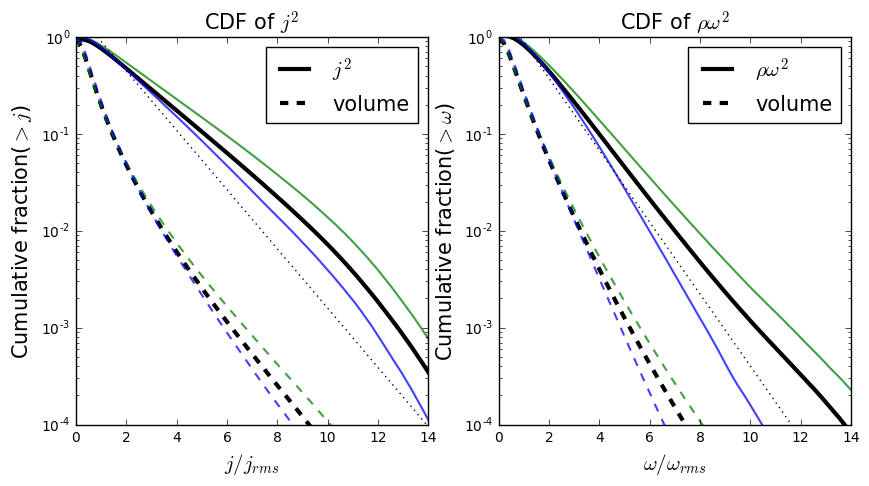

In [385]:
from read_hist import time_trim

targ = 'x2y4z1r512pm1re16000'
# load alpha history data


direname='/tigress/jiming/reconnect/athena/bin/'
basename='Unstra.out2.'
targlist=['x2y4z1r64pm1re4000','x2y4z1r128pm1re4000','x2y4z1r256pm1re4000',\
          'x2y4z1r256pm1re8000','x2y4z1r512pm1re8000',\
          'x2y4z1r512pm1re16000']
targ = targlist[5]

linewidth = [3,3,3,3,4.5,4.5]  #width for various resolution
linestyle = [':',':',':','--',':','--','-'] # linestyle to show various Re
ctable = ['k','k','b','g','g','k']
count = 0
matplotlib.rcParams['figure.figsize'] = (10,5)


ts,te,tstride = 30,50,1
label = targ[6:]
nbin = 100; nt = (te-ts+1.)/tstride; torb = 2.0*np.pi



# 1) get hist info for alpha and prepare the range for average
fname=direname+targ+'/'+'Unstra.hst'
dtype = np.dtype([('time', 'f8'), ('em1', 'f8'),('em2','f8'),('em3','f8'),('maxwell','f8'),('reynolds','f8')])
tmp = np.loadtxt(fname, dtype=dtype, skiprows=2, usecols=(0,9,10,11,12,13))
tt,em1,em2,em3,maxwell,reynolds = time_trim(tmp)
idx_ts = np.abs(tt-(0.5*ts*torb)).argmin()
idx_te = np.abs(tt-(0.5*te*torb)).argmin()
#print idx_ts,idx_te
maxwell_avg = np.average(maxwell[idx_ts:idx_te])
amp = 0.25
maxwellu = maxwell_avg*(1.+3*amp) #3.5*amp)
maxwellb = maxwell_avg*(1.-2*amp) #-2*amp)
#print maxwell_avg,maxwellu,maxwellb

# 2) sort the time frames based on the value alpha of maxwellu and maxwellb
ulist = []; blist =[]
for nvar in np.arange(2): # j2 and w2 respectively
  appdname='.athdf.jcdf.tab'
  irow = (0,1,2)
  label=r'$j^2$'
  if nvar > 0:
    appdname = '.athdf.vcdf.tab'
    irow = (0,1,2)
    label = r'$\omega^2$'
    appdname = '.athdf.vcdf2.tab'
    irow = (0,2,4)
    label = r'$\rho\omega^2$'
  plt.subplot(1,2,nvar+1)
  jth2 = np.zeros(nbin)
  cdfj2 = np.zeros(nbin);cdfj2u = np.zeros(nbin);cdfj2b = np.zeros(nbin)
  cdfvol = np.zeros(nbin);cdfvolu = np.zeros(nbin);cdfvolb = np.zeros(nbin)
  countu = countb = 0
  for i in np.arange(ts,te,tstride):
    fname = direname+targ+'/'+basename+str(i).zfill(5)+appdname
    dtype1 = np.dtype([('jth2', 'f8'), ('cdfj2', 'f8'),('cdfvol','f8')])
    ahist = np.loadtxt(fname, dtype=dtype1, usecols=irow)
    cdfj2 += ahist['cdfj2']
    cdfvol += ahist['cdfvol']
    idx = np.abs(tt-(0.5*i*torb)).argmin()
    if maxwell[idx] >= maxwellu: #upper bound
        cdfj2u += ahist['cdfj2']
        cdfvolu += ahist['cdfvol']
        countu += 1
        if nvar==0:
            ulist.append(i)
        #print 'upper bound at ',i
    if maxwell[idx] <= maxwellb: # lower bound
        cdfj2b += ahist['cdfj2']
        cdfvolb += ahist['cdfvol']
        countb +=1
        if nvar==0:
            blist.append(i)
        #print 'lower bound at ',i

  jth = (ahist['jth2'])**0.5
  cdfj2 /= float(nt)
  cdfvol /= float(nt)
  cdfj2u /= countu; cdfvolu /= countu
  cdfj2b /= countb; cdfvolb /= countb

  plt.plot(jth,cdfj2,ctable[count]+'-',linewidth=linewidth[count],label=label)
  plt.plot(jth,cdfvol,ctable[count]+'--',linewidth=linewidth[count],label='volume')
  plt.plot(jth,cdfj2u,'g-',linewidth=linewidth[count]-1.5,alpha=0.75,)
  plt.plot(jth,cdfvolu,'g--',linewidth=linewidth[count]-1.5,alpha=0.75)
  plt.plot(jth,cdfj2b,'b-',linewidth=linewidth[count]-1.5,alpha=0.75)
  plt.plot(jth,cdfvolb,'b--',linewidth=linewidth[count]-1.5,alpha=0.75)
    
  count +=1
  plt.yscale('log')
  plt.xlim([0,14])
  plt.ylim([1e-4,1])
  if nvar == 0:  
    #plt.plot(jth,np.exp(-(jth-0.5)/2),'r--')
    #plt.plot(jth,np.exp(-jth*1.5),'r--')
    plt.plot(jth,np.exp(-(jth-0.85)/1.42),'k:')
    plt.title('CDF of '+r'$j^2$',fontsize=15)
    plt.xlabel(r'$j/j_{rms}$',fontsize=15)
    plt.ylabel('Cumulative fraction'+r'($>j$)',fontsize=15)
    plt.legend(loc=1,fontsize=8)
  else:
    #plt.plot(jth,np.exp(-(jth-0.5)/1.45),'r--')
    #plt.plot(jth,np.exp(-jth*1.2)/1.2,'r--')
    plt.plot(jth,np.exp(-(jth-0.85)/1.17),'k:')
    plt.title('CDF of '+r'$\rho\omega^2$',fontsize=15)
    plt.xlabel(r'$\omega/\omega_{rms}$',fontsize=15)
    plt.ylabel('Cumulative fraction'+r'($>\omega$)',fontsize=15)
   
  plt.legend(loc=1,fontsize=15)

print ulist
print blist
plt.savefig('cdf_re16000_twostate.png', format='png', dpi=300)

In [5]:
# import cPickle as pickle
# import athena_read as ath

# def get_curl(fname='Unstra.out2.00008.athdf'):
#   """load 3d bfield and calc the current density"""
#   # ---
#   def curl(vx,vy,vz,dx,dy,dz):
#     [dzvx,dyvx,dxvx] = np.gradient(vx)
#     [dzvy,dyvy,dxvy] = np.gradient(vy)
#     [dzvz,dyvz,dxvz] = np.gradient(vz)
#     j2 = (dyvz/dy-dzvy/dz)**2
#     j2 += (dzvx/dz-dxvz/dx)**2
#     j2 += (dxvy/dx-dyvx/dy)**2
#     return j2
#   # ---
#   #data=ath.athdf(fname,quantities=['B1','B2','B3'])
#   time,data=ath.athdf(fname,quantities=['Bcc1'])
#   bx = data['Bcc1']
#   time,data=ath.athdf(fname,quantities=['Bcc2'])
#   by = data['Bcc2']
#   time,data=ath.athdf(fname,quantities=['Bcc3'])
#   bz = data['Bcc3']
#   x  = data['x1f'];y  = data['x2f']; z  = data['x3f']
#   dx = dz = x[1]-x[0]; dy = y[1]-y[0]
#   #j2 = curl(bx,by,bz,dx,dy,dz)
#   j2 = curl(bx,by,bz,dx,dy,dz)

#   time,data=ath.athdf(fname,quantities=['vel1'])
#   bx = data['vel1']
#   time,data=ath.athdf(fname,quantities=['vel2'])
#   by = data['vel2']
#   time,data=ath.athdf(fname,quantities=['vel3'])
#   bz = data['vel3']
#   time,data=ath.athdf(fname,quantities=['rho'])
#   d  = data['rho']
#   #w2 = curl(bx,by,bz,dx,dy,dz)*data['rho']
#   w2 = curl(bx,by,bz,dx,dy,dz)*d

#   return time,x,y,z,j2,w2


# #fdir = '/tigress/jiming/reconnect/athena/bin/'
# #fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00040.athdf'
# #t,x,y,z,j2,w2 = get_curl(fname)

In [20]:
# from matplotlib import gridspec
# from mpl_toolkits.axes_grid1 import make_axes_locatable

# def plot_3slice(input_data,xslice=512,yslice=504,zslice=256,dmin=0,dmax=100,cmap='OrRd',figsize_x=6,figsize_y=8):
#     tmp = input_data
#     matplotlib.rcParams['figure.figsize'] = (figsize_x, figsize_y)
#     matplotlib.rcParams['image.cmap'] = cmap
#     gs = gridspec.GridSpec(2, 2,width_ratios=[2, 1],height_ratios=[4, 1])

#     ax1 = plt.subplot(gs[0])
#     fig1 = plt.imshow(tmp[zslice,:,:],origin='lower',extent =[-1,1,-2,2],vmin=dmin,vmax=dmax)
#     plt.ylabel('y',fontsize=15)
#     ax2 = plt.subplot(gs[1])
#     fig2 = plt.imshow(np.transpose(tmp[:,:,xslice]),origin='lower',extent=[-0.5,0.5,-2,2],vmin=dmin,vmax=dmax)
#     ax3 = plt.subplot(gs[2])
#     fig3 = plt.imshow(tmp[:,yslice,:],origin='lower',extent=[-1,1,-0.5,0.5],vmin=dmin,vmax=dmax)
#     plt.ylabel('z',fontsize=15)
#     plt.xlabel('x',fontsize=15)
#     ax4 = plt.subplot(gs[3])
#     ax4.axis('off')

#     divider = make_axes_locatable(ax4)
#     cax = divider.append_axes("left", size="10%", pad=0.15)

#     ax1.tick_params(labelbottom='off') 
#     ax2.tick_params(labelleft='off')

#     #ax2.get_yaxis().set_ticks([])
#     plt.colorbar(cax=cax)

#     plt.tight_layout()

In [100]:


# def show_contour(x,y,input_data,dmin=0,dmax=100,cmap='OrRd',xspan=(0,0),yspan=(0,0),figsize_x=6,figsize_y=8,xlabel='x',ylabel='y'):
#     tmp = input_data
#     matplotlib.rcParams['figure.figsize'] = (figsize_x, figsize_y)
#     matplotlib.rcParams['image.cmap'] = cmap
#     #gs = gridspec.GridSpec(2, 2,width_ratios=[2, 1],height_ratios=[4, 1])
#     if xspan[0] == 0 and xspan[1] == 0:
#         xmin = -1; xmax=1
#     else:
#         xmin = xspan[0]; xmax=xspan[1]
#     if yspan[0] == 0 and yspan[1] == 0:
#         ymin = -2; ymax=2
#     else:
#         ymin = yspan[0]; ymax=yspan[1]
    
#     # reduce the img to required size
#     ids=np.abs(x-xmin).argmin()
#     ide=np.abs(x-xmax).argmin()
#     jds=np.abs(y-ymin).argmin()
#     jde=np.abs(y-ymax).argmin()
#     ndim = np.shape(tmp)
#     jde = jde if jde < ndim[0] else ndim[0]-1
#     ide = ide if ide < ndim[1] else ndim[1]-1
#     tmp = tmp[jds:jde,ids:ide]

#     fig1 = plt.imshow(tmp,origin='lower',extent =[xmin,xmax,ymin,ymax],vmin=dmin,vmax=dmax)
#     plt.ylabel(ylabel,fontsize=15)
#     plt.xlabel(xlabel,fontsize=15)
#     plt.colorbar(pad=0.05,fraction=0.05)


* channel modes promote current sheets with larger scales

In [5]:
import cPickle as pickle
from csheet3d import get_curl
from csheet3d import plot_3slice
from csheet3d import show_contour
import athena_read as ath


fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00040.athdf'
t,x,y,z,j2,w2 = get_curl(fname)
#from csheet3d import plot_3slice
#from csheet3d import get_curl
fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00045.athdf'
t,x,y,z,j2u,w2u = get_curl(fname)

plot_3slice(j2u/np.average(j2u),dmin=0,dmax=10)
np.save(fname+".j2_t=40.p",j2)
np.save(fname+".w2_t=40.p",w2)
np.save(fname+".j2_t=45.p",j2u)
np.save(fname+".w2_t=45.p",w2u)
# fdir = '/tigress/jiming/reconnect/athena/bin/'
# fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00049.athdf'
# t,x,y,z,j2,w2 = get_curl(fname)
# np.save(fname+".j2_t=49.p",j2)
# np.save(fname+".w2_t=49.p",w2)



time =  153.937868153
time =  153.937868153
time =  153.937868153
time =  153.937868153
time =  153.937868153
time =  153.937868153
time =  153.937868153


### magnitude of current density at t=40 (20 orbits) mild turbulent state (slices at z = -0.2, x= -0.75, and y=-0.5 respectively)

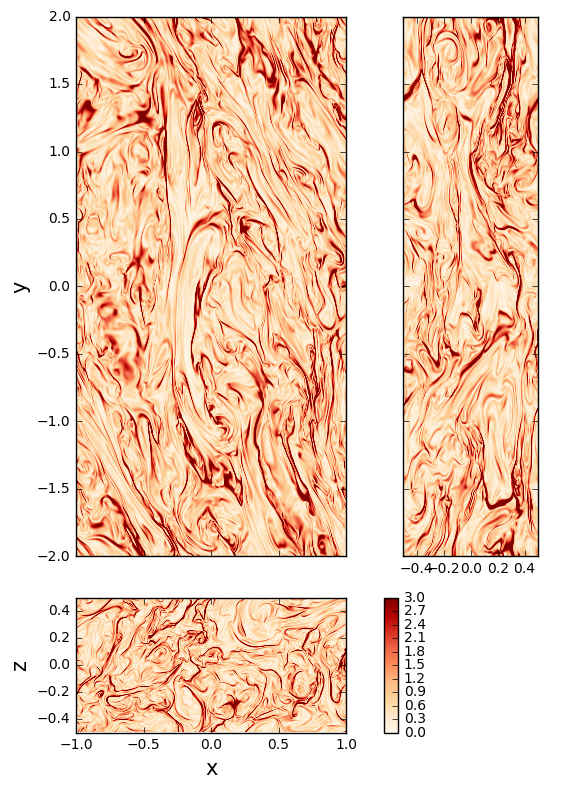

In [253]:
plot_3slice(np.sqrt(j2)/np.average(np.sqrt(j2)),dmin=0,dmax=3,yslice=375,xslice=128,zslice=152)

### similar as above but at t=45 (channel mode spurs) 

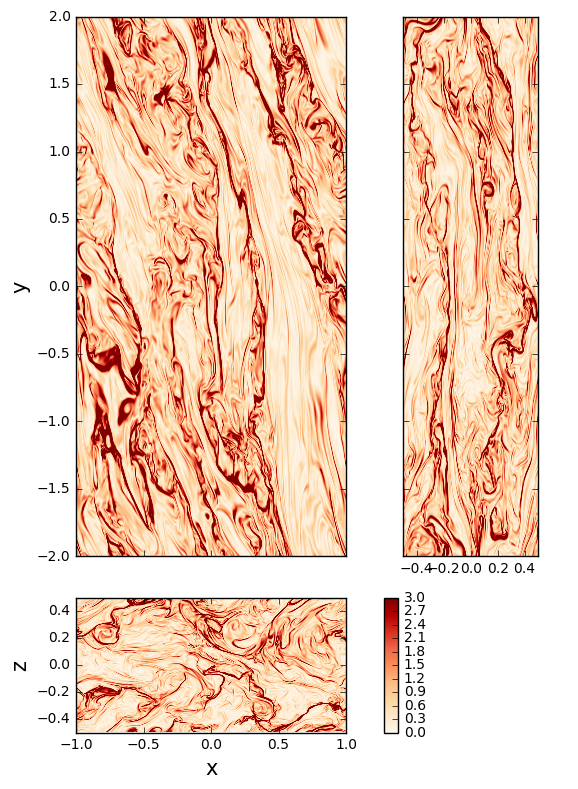

In [191]:
plot_3slice(np.sqrt(j2u)/np.average(np.sqrt(j2u)),dmin=0,dmax=3,yslice=375,xslice=128,zslice=152)

### $B_y$ for t=40 for reference

In [228]:
fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00040.athdf'
time,data = ath.athdf(fname,quantities=['Bcc2'])

time =  125.663719861


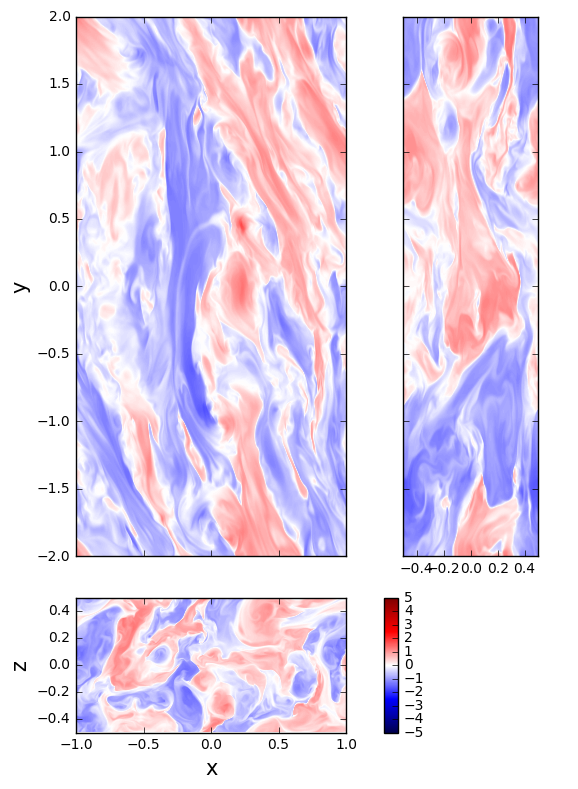

In [229]:
plot_3slice(data['Bcc2'],dmin=-5,dmax=5,cmap='seismic',yslice=375,xslice=128,zslice=152)

### $B_y$ for t=45 for reference

In [144]:
fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00045.athdf'
time,data = ath.athdf(fname,quantities=['Bcc2'])

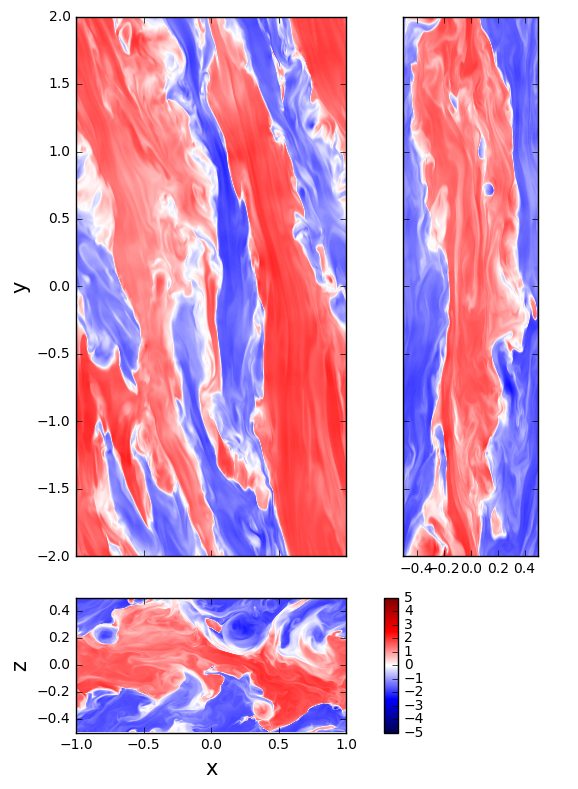

In [230]:
plot_3slice(data['Bcc2',dmin=-5,dmax=5,cmap='seismic',yslice=375,xslice=128,zslice=152)

### $\omega$ vorticity plots for t=40 (top) and t=45 (bottom) 

* they look very similar to the current density plots.

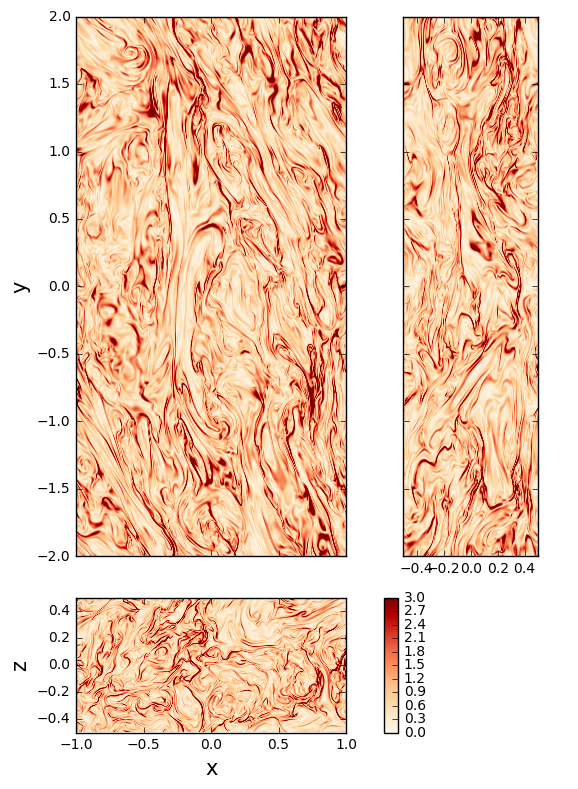

In [231]:
plot_3slice(np.sqrt(w2)/np.average(np.sqrt(w2)),dmin=0,dmax=3,yslice=375,xslice=128,zslice=152)

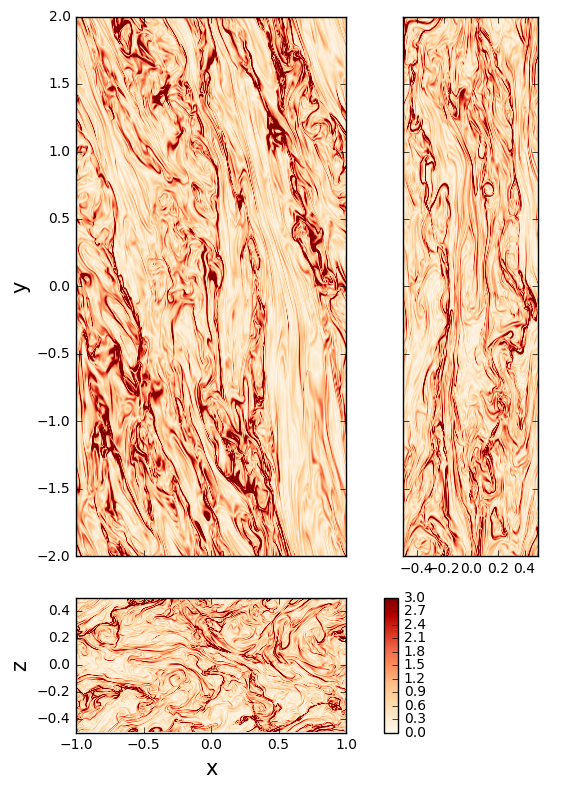

In [232]:
plot_3slice(np.sqrt(w2u)/np.average(np.sqrt(w2u)),dmin=0,dmax=3,yslice=375,xslice=128,zslice=152)

### snapshots for adiabatic run

In [34]:
import cPickle as pickle
from csheet3d import get_curl
from csheet3d import plot_3slice
from csheet3d import show_contour
import athena_read as ath


fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'adb.r256.new/Unstra.out2.00030.athdf'
t,x,y,z,j2,w2 = get_curl(fname)
# #from csheet3d import plot_3slice
# #from csheet3d import get_curl
# fdir = '/tigress/jiming/reconnect/athena/bin/'
# fname=fdir+'x2y4z1r256ideal/Unstra.out2.00040.athdf'
# t,x,y,z,j2l,w2l = get_curl(fname)

# fdir = '/tigress/jiming/reconnect/athena/bin/'
# fname=fdir+'x2y4z1r256ideal/Unstra.out2.00045.athdf'
# t,x,y,z,j2u,w2u = get_curl(fname)

# # plot_3slice(j2u/np.average(j2u),dmin=0,dmax=10)
# # np.save(fname+".j2_t=40.p",j2)
# # np.save(fname+".w2_t=40.p",w2)
# # np.save(fname+".j2_t=45.p",j2u)
# # np.save(fname+".w2_t=45.p",w2u)

time =  94.2478001739
time =  94.2478001739
time =  94.2478001739
time =  94.2478001739
time =  94.2478001739
time =  94.2478001739
time =  94.2478001739


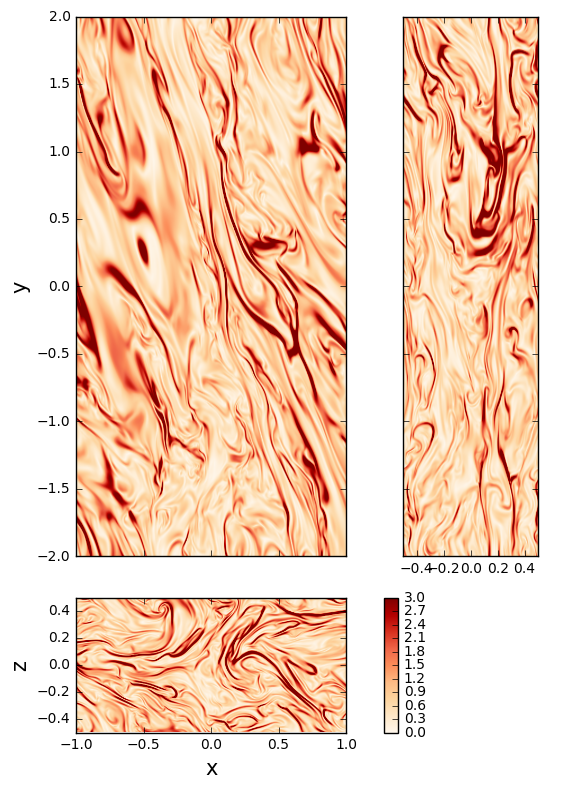

In [35]:
# jcurrent for adiabatic run
plot_3slice(np.sqrt(j2)/np.average(np.sqrt(j2)),dmin=0,dmax=3,yslice=252,xslice=256,zslice=128)

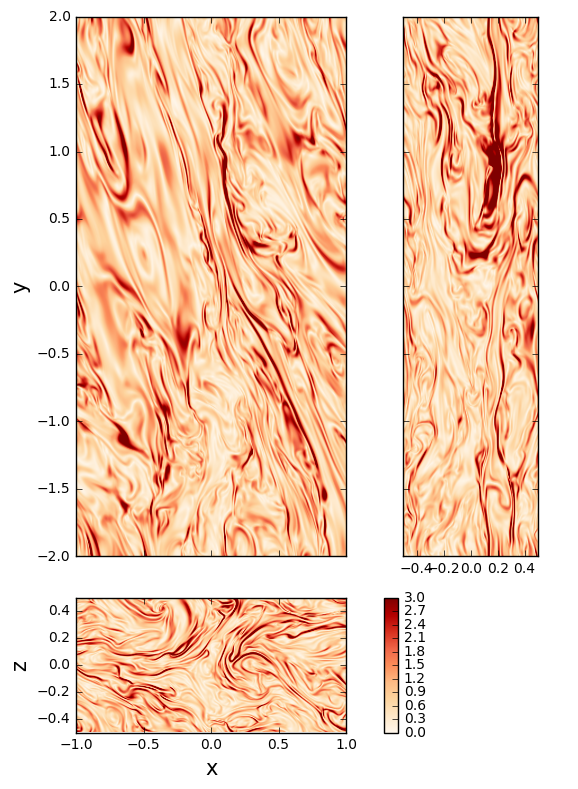

In [36]:
# vorticity for adiabatic run
plot_3slice(np.sqrt(w2)/np.average(np.sqrt(w2)),dmin=0,dmax=3,yslice=252,xslice=256,zslice=128)

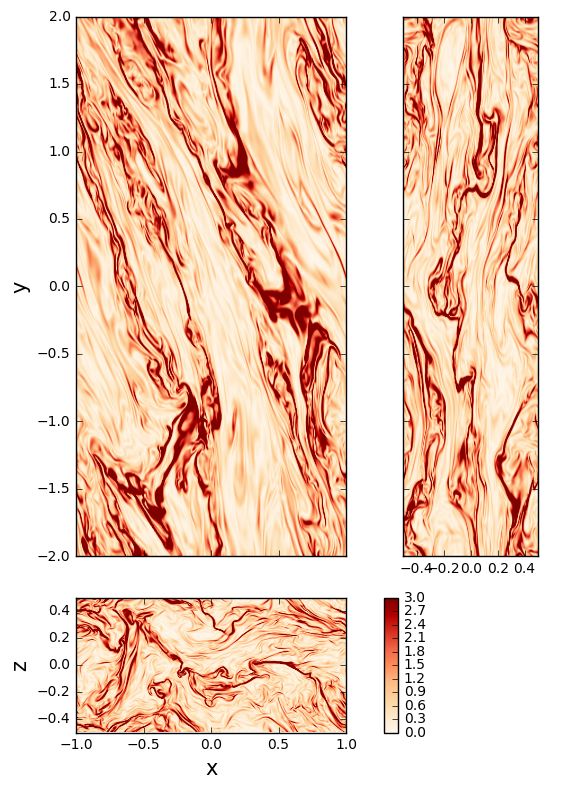

In [68]:
# jcurrent for ideal run with high stress level
plot_3slice(np.sqrt(j2u)/np.average(np.sqrt(j2u)),dmin=0,dmax=3,yslice=252,xslice=256,zslice=128)

###  auto-correlation of $j$ and cross-correlation of $j\circ \omega$ confirms this

In [422]:
# load the precalculated and stored data 
import cPickle as pickle
from csheet3d import get_curl
from csheet3d import plot_3slice
from csheet3d import show_contour
import athena_read as ath

fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00040.athdf'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00045.athdf'
time,data = ath.athdf(fname,quantities=['Bcc2'])
x,y,z = data['x1f'],data['x2f'],data['x3f']
x = x+0.5*(x[1]-x[0]); x=x[:-1]
y = y+0.5*(y[1]-y[0]); y=y[:-1]
z = z+0.5*(z[1]-z[0]); z=z[:-1]
dx = x[1]-x[0]
##t,x,y,z,j2,w2 = get_curl(fname)
##t,x,y,z,j2u,w2u = get_curl(fname)
##plot_3slice(j2u/np.average(j2u),dmin=0,dmax=10)
# j2=np.load(fname+".j2_t=40.p",j2)
# w2=np.load(fname+".w2_t=40.p",w2)
j2=np.load(fname+".j2_t=45.p.npy")
w2=np.load(fname+".w2_t=45.p.npy")

time =  141.371607789


### let's compare midplane slices using structural similarity index method (SSIM)
* a similarity factor 0.88 is obtained which is very close to 1 (perfectly match)

In [433]:
print s

0.167920262792


In [438]:
from skimage.measure import structural_similarity as ssim
from csheet3d import show_contour
jmid = (j2[255,...])
wmid = (w2[255,...])
jmid -= np.average(jmid)
wmid -= np.average(wmid)
jmid /=np.max(jmid)
wmid /=np.max(wmid)
print jmid.shape
s = ssim(jmid,wmid)
print s

(1008, 1024)


/home/jiming/local/anaconda/anaconda2/lib/python2.7/site-packages/skimage/measure/_structural_similarity.py:224: skimage_deprecation: Call to deprecated function ``structural_similarity``. Use ``compare_ssim`` instead.
  def structural_similarity(X, Y, win_size=None, gradient=False,


0.881554982388


In [388]:
from itertools import product
import numpy as np


def multiroll(x, shift, axis=None):
    """Roll an array along each axis.

    Parameters
    ----------
    x : array_like
        Array to be rolled.
    shift : sequence of int
        Number of indices by which to shift each axis.
    axis : sequence of int, optional
        The axes to be rolled.  If not given, all axes is assumed, and
        len(shift) must equal the number of dimensions of x.

    Returns
    -------
    y : numpy array, with the same type and size as x
        The rolled array.

    Notes
    -----
    The length of x along each axis must be positive.  The function
    does not handle arrays that have axes with length 0.

    See Also
    --------
    numpy.roll

    Example
    -------
    Here's a two-dimensional array:

    >>> x = np.arange(20).reshape(4,5)
    >>> x 
    array([[ 0,  1,  2,  3,  4],
           [ 5,  6,  7,  8,  9],
           [10, 11, 12, 13, 14],
           [15, 16, 17, 18, 19]])

    Roll the first axis one step and the second axis three steps:

    >>> multiroll(x, [1, 3])
    array([[17, 18, 19, 15, 16],
           [ 2,  3,  4,  0,  1],
           [ 7,  8,  9,  5,  6],
           [12, 13, 14, 10, 11]])

    That's equivalent to:

    >>> np.roll(np.roll(x, 1, axis=0), 3, axis=1)
    array([[17, 18, 19, 15, 16],
           [ 2,  3,  4,  0,  1],
           [ 7,  8,  9,  5,  6],
           [12, 13, 14, 10, 11]])

    Not all the axes must be rolled.  The following uses
    the `axis` argument to roll just the second axis:

    >>> multiroll(x, [2], axis=[1])
    array([[ 3,  4,  0,  1,  2],
           [ 8,  9,  5,  6,  7],
           [13, 14, 10, 11, 12],
           [18, 19, 15, 16, 17]])

    which is equivalent to:

    >>> np.roll(x, 2, axis=1)
    array([[ 3,  4,  0,  1,  2],
           [ 8,  9,  5,  6,  7],
           [13, 14, 10, 11, 12],
           [18, 19, 15, 16, 17]])

    """
    x = np.asarray(x)
    if axis is None:
        if len(shift) != x.ndim:
            raise ValueError("The array has %d axes, but len(shift) is only "
                             "%d. When 'axis' is not given, a shift must be "
                             "provided for all axes." % (x.ndim, len(shift)))
        axis = range(x.ndim)
    else:
        # axis does not have to contain all the axes.  Here we append the
        # missing axes to axis, and for each missing axis, append 0 to shift.
        missing_axes = set(range(x.ndim)) - set(axis)
        num_missing = len(missing_axes)
        axis = tuple(axis) + tuple(missing_axes)
        shift = tuple(shift) + (0,)*num_missing

    # Use mod to convert all shifts to be values between 0 and the length
    # of the corresponding axis.
    shift = [s % x.shape[ax] for s, ax in zip(shift, axis)]

    # Reorder the values in shift to correspond to axes 0, 1, ..., x.ndim-1.
    shift = np.take(shift, np.argsort(axis))

    # Create the output array, and copy the shifted blocks from x to y.
    y = np.empty_like(x)
    src_slices = [(slice(n-shft, n), slice(0, n-shft))
                  for shft, n in zip(shift, x.shape)]
    dst_slices = [(slice(0, shft), slice(shft, n))
                  for shft, n in zip(shift, x.shape)]
    src_blks = product(*src_slices)
    dst_blks = product(*dst_slices)
    for src_blk, dst_blk in zip(src_blks, dst_blks):
        y[dst_blk] = x[src_blk]

    return y

def calc_correlation(a,b=None,auto=False):
    if auto: ## auto-corr
      corr_ps = np.abs(np.fft.fftn(a))
      corr_ps *= corr_ps
      corr = np.real(np.fft.ifftn(corr_ps))
      corr /= np.max(corr)
    else:
      a_ps = np.abs(np.fft.fftn(a))
      b_ps = np.abs(np.fft.fftn(b))
      a_ps *= np.conj(b_ps)
      corr = np.real(np.fft.ifftn(a_ps))
      corr /= np.max(corr)
    ndim = corr.shape
    # have to shift them to lag space
    corr = multiroll(corr,(ndim[0]/2-1,ndim[1]/2-1,ndim[2]/2-1),axis=(0,1,2))
    return corr

In [389]:
jin = np.sqrt(j2)-np.average(np.sqrt(j2))
ac_jturb = calc_correlation(jin,auto=True)

win = np.sqrt(w2)-np.average(np.sqrt(w2))
ccorr_jw = calc_correlation(jin,win,auto=False)




In [408]:

# shell avg
ratio = ccorr_jw/ac_jturb
nx,ny,nz = ratio.shape[2],ratio.shape[1],ratio.shape[0]
kz,ky,kx = np.meshgrid(z,y,x,indexing='ij')
wcnt = 50 #int((min([nx,ny,nz]))/2)+1
lz = 0.2
radius = np.linspace(0,lz,50)
hdr = 0.5*dx
corr = np.zeros(wcnt)
dist = np.sqrt(kx**2+ky**2+kz**2)

for i in xrange(0,wcnt):
    corr[i] = np.average(ratio[np.logical_and(
                (dist>=(radius[i]-hdr)),
                (dist>(radius[i]+hdr)))
                ])
    

    



time =  141.371607789


In [409]:
print corr

[ 0.91468375  0.91468375  0.9146837   0.91468357  0.9146833   0.91468282
  0.91468209  0.91468105  0.91467963  0.91467778  0.91467546  0.91467256
  0.91466902  0.91466481  0.91465977  0.91465395  0.91464718  0.91463946
  0.91463066  0.91462072  0.91460963  0.91459713  0.91458329  0.91456788
  0.91455076  0.91453208  0.91451145  0.91448903  0.91446461  0.91443801
  0.91440908  0.91437789  0.91434414  0.9143075   0.91426797  0.91422556
  0.9141794   0.91412933  0.91407465  0.9140147   0.91394862  0.91387552
  0.91384926  0.91382555  0.91371573  0.91361995  0.9134987   0.91347976
  0.91500227  0.91492058]


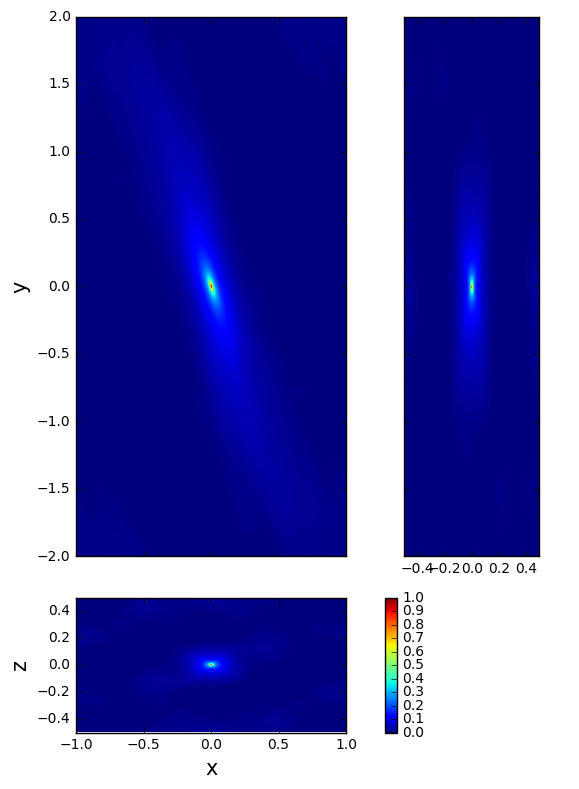

In [415]:
plot_3slice((ccorr_jw),dmin=0,dmax=1,yslice=504,xslice=512,zslice=255,cmap='jet')

In [312]:
# jin = np.sqrt(j2)-np.average(np.sqrt(j2))
# ac_jturb = calc_correlation(jin,auto=True)
jin = np.sqrt(j2u)-np.average(np.sqrt(j2u))
# ac_jchan = calc_correlation(jin,auto=True)

jin1 = np.sqrt(w2u)-np.average(np.sqrt(w2u))
ccorr = calc_correlation(jin1,jin,auto=False)

* autocorrelation of $j$ at t=40

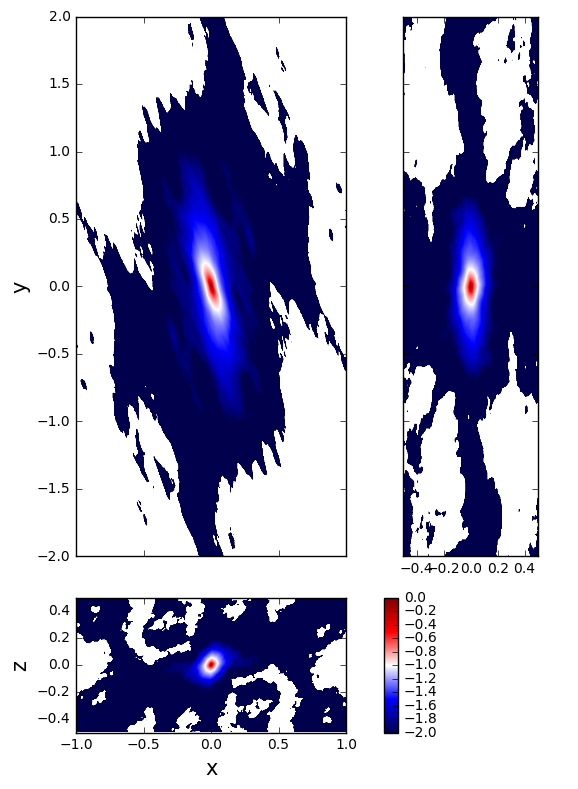

In [320]:
plot_3slice(np.log10(ac_jturb),dmin=-2,dmax=0,yslice=504,xslice=512,zslice=255,cmap='seismic')

* autocorrelation of $j$ at t=45

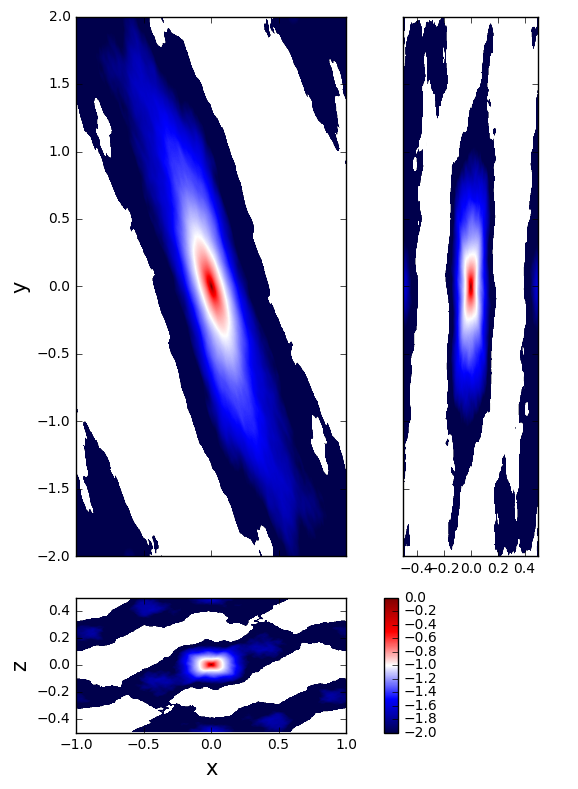

In [319]:
plot_3slice(np.log10(ac_jchan),dmin=-2,dmax=0,yslice=504,xslice=512,zslice=255,cmap='seismic')

* cross-correlation $j\circ \omega$

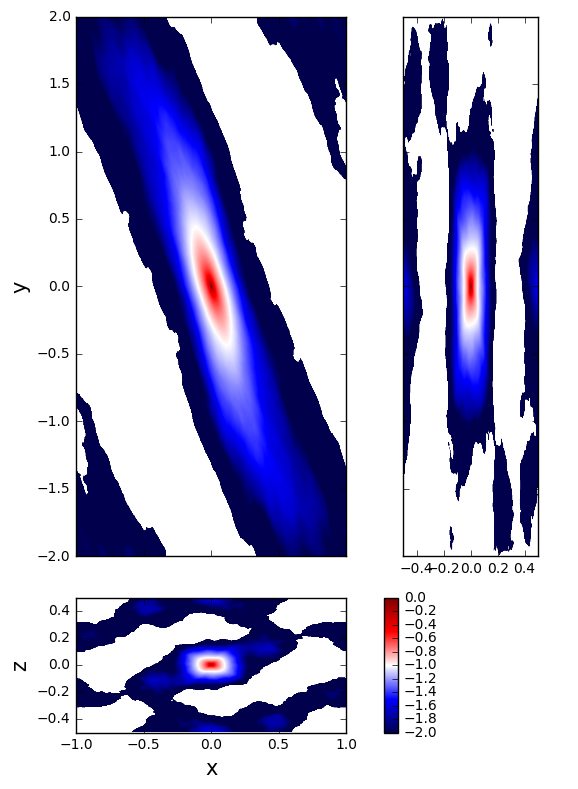

In [322]:
plot_3slice(np.log10(ccorr),dmin=-2,dmax=0,yslice=504,xslice=512,zslice=255,cmap='seismic')

# 3 current sheet statistics
* $\varepsilon_{\eta} \equiv \eta j^2$, $\varepsilon_{\eta,sh}\equiv \eta j_{sh}^2$
* $\mathcal{E}_{tot} \equiv \mathcal{E}_{\eta} + \mathcal{E}_{\nu}$  total energy dissipation rate
* $\mathcal{E}_{\eta} \equiv \int \varepsilon_{\eta} dV $ total Ohmic dissipation
* $\mathcal{E}_{\eta,sh} \equiv \int \varepsilon_{\eta,sh} dV_{sh}$ total Ohmic dissipation integrated over all current sheets
* $\langle\varepsilon_{\eta,sh}\rangle \equiv \int \eta j_{sh}^2 dV_{sh} /\int dV_{sh}$ the volume averaged dissipation rate over all current sheets; 
* $\langle\varepsilon_{\eta}\rangle \equiv \int \eta j^2 dV /\int dV $ volume averaged dissipation over the whole box
* $\theta_{\eta} \equiv \int \varepsilon_{\eta,sh} dv_{sh}$ total Ohmic dissipation integrated over a single current sheet
* $\langle\varepsilon_{\eta,sh}\rangle_i \equiv \int \varepsilon_{\eta,sh} dv_{sh} /\int dv_{sh}$ the volume averaged dissipation rate due to Ohmic dissipation of a single current sheet; 


Similarly, we have
* $\mathcal{E}_{\nu} \equiv \int \nu \omega^2 dV $ approximated viscous dissipation
* $\mathcal{E}_{\nu,sh} \equiv \int \eta \omega_{sh}^2 dV_{sh}$ total viscous dissipation integrated over all vorticity sheets
* $\varepsilon_{\nu,sh} \equiv \int \eta \omega_{sh}^2 dV_{sh} /\int dV_{sh}$ the volume averaged dissipation rate due to Ohmic dissipation over all current sheets; 

In [2]:
# %matplotlib notebook
# %matplotlib notebook
# import matplotlib.gridspec as gridspec
# import matplotlib.pyplot as plt
# import matplotlib
# import numpy as np


# def plot_jhist(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,ntime):
#     nframe = 2
#     nplot  = 3
#     matplotlib.rcParams['figure.figsize'] = (12, 12.0*nframe/nplot)
#     fig = plt.figure()
#     fraction=0.046;pad=0.04
#     gs = gridspec.GridSpec(2, 3)
#     # calc dissipation rate per sheet for normalization or weighted average
#     ncelltot= float(np.sum(np.array(ncells)))
#     diss_sheet = np.array(ncells)*np.array(diss)
#     disstot= float(np.sum(diss_sheet))
#     for i in np.arange(6):
#       if (i==0):
#         hdata = np.array(size)[:,0]
#         vmin=-2; vmax=0.5  #in log10
#         nbins = 100
#         xlab = r'$\lambda/H$'
#         print 'non-weighted averaged (lambda,xi,l) = (',np.average(np.array(size)[:,0]),' ,',\
#                                            np.average(np.array(size)[:,1]),' ,',\
#                                            np.average(np.array(size)[:,2]),')'
#         print 'vol-weighted averaged (lambda,xi,l) = (',np.sum(np.array(size)[:,0]*np.array(ncells))/ncelltot,' ,',\
#                                            np.sum(np.array(size)[:,1]*np.array(ncells))/ncelltot,' ,',\
#                                            np.sum(np.array(size)[:,2]*np.array(ncells))/ncelltot,')'      
#         print 'dis-weighted averaged (lambda,xi,l) = (',np.sum(np.array(size)[:,0]*diss_sheet)/disstot,' ,',\
#                                            np.sum(np.array(size)[:,1]*diss_sheet)/disstot,' ,',\
#                                            np.sum(np.array(size)[:,2]*diss_sheet)/disstot,')'
#         index,coef=-3.2,1e-2
#       if (i==1):
#         hdata = np.array(size)[:,0]
#         vmin=-3;vmax=1
#         nbins = 100
#         xlab1 = r'$\xi$'
#         xlab2 =r'$l$'
#         xlab = r'$\lambda$'
#         hdata1 = np.array(size)[:,1]
#         hdata2 = np.array(size)[:,2]
#         index,coef=-3.0,1e-2
#       if (i==2):
#         hdata = (theta)
#         vmin = np.log10(np.min(hdata))
#         vmax = np.log10(np.max(hdata))
#         nbins = 100
#         xlab = r'$\theta_{\eta}/\mathcal{E}_{\eta}$'
#         print 'average theta/E_eta = ', np.average(hdata)
#         index,coef=-2.0,1e-5
#       if (i==3):
#         hdata = (np.array(jmaxnorm))
#         vmin = np.log10(2) #np.log10(np.min(hdata))
#         vmax = np.log10(20) #np.log10(np.max(hdata))
#         nbins=100
#         xlab = r'$j_{max}/j_{rms}$'
#         print 'average j_max/j_rms = ',np.average(hdata)
#       if (i==4):
#         hdata = np.array(dissnorm)
#         vmin = np.log10(5) #np.log10(np.min(hdata))
#         vmax = np.log10(50) #np.log10(np.max(hdata))
#         nbins = 100
#         xlab = r'$\langle\varepsilon_{\eta,sh}\rangle_i /\langle\varepsilon_{\eta}\rangle$'
#         print 'average epsilon = ', np.average(hdata)
#       if (i==5):
#         hdata = np.array(ncells)*dv #/((x[1]-x[0])**3)
#         #vmin = -3; vmax = 0
#         vmin = np.log10(np.min(hdata))
#         vmax = np.log10(np.max(hdata))
#         nbins = 100
#         xlab = r'$v_{sh}/V$'
#         print 'average volume fraction per sheet = ',np.average(hdata)/8.0
#         print 'dis-weighted average volume fraction per sheet = ',np.average(hdata*diss_sheet)\
#                                                              /8.0/np.average(diss_sheet)
#         print 'average volume fraction for all sheets = ',np.sum(hdata)/float(ntime)/8.0
#         print 'time averaged number of current sheets = ', len(ncells)/float(ntime)
#         #print 'dis-weighted average volume fraction for all sheets = ',np.sum(hdata*diss_sheet)\
#         #                                                        /float(ntime)/8.0/(disstot)

#       hist, bins = np.histogram(hdata, bins=np.logspace(vmin,vmax,nbins),density=1)
#       center = 10**((np.log10(bins[:-1])+np.log10(bins[1:]))/2)
#       if (i==1):
#          hist1, bins1 = np.histogram(hdata1, bins=np.logspace(vmin,vmax,nbins),density=1)
#          hist2, bins2 = np.histogram(hdata2, bins=np.logspace(vmin,vmax,nbins),density=1)
      
#       fig.add_subplot(gs[i])
#       if (i< 3): 
#         plt.plot(center,hist,'k-',label=xlab)
#         #n, bins, patches = plt.hist(hdata, bins=np.logspace(vmin,vmax,nbins), \
#         #                            normed=1, facecolor='green', alpha=0.5,label=xlab)
#         if i==1:
#           plt.plot(center,hist1,'b-',label=xlab1)
#           plt.plot(center,hist2,'g-',label=xlab2)
#           #n, bins, patches = plt.hist(hdata1, bins=np.logspace(vmin,vmax,nbins), \
#           #                          normed=1, facecolor='blue', alpha=0.35,label=xlab1)
#           plt.legend(loc=1,fontsize=20)
#           xlab = r'$(\lambda,\xi,l)/H$'
#         #plt.text(vmin,7000,'total counts: '+str(len(hdata)),size=20,color='g')
#         plt.plot(center,coef*center**index,'k:')
#       else:
#         plt.plot(center,hist,'k-')
#         #n, bins, patches = plt.hist(hdata, bins=np.logspace(vmin,vmax,nbins), normed=1, facecolor='blue', alpha=0.5)

#       plt.xlabel(xlab,size=20)
#       plt.ylabel('probability density',size=20)
#       plt.xlim([10**vmin,10**vmax])
#       plt.gca().set_xscale("log")
#       plt.gca().set_yscale("log",nonposy='clip')
#       #if(i==5):
#       #  plt.xlim([1e4,10**4.3])

#     plt.tight_layout()
    

In [3]:
# ############################################
# import matplotlib.gridspec as gridspec

# def plot_jcorr(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=4e-5,ntime=21,project=np.array([1,0,0])):
#     nframe = 3
#     nplot  = 3
#     matplotlib.rcParams['figure.figsize'] = (10, 8.0*nframe/nplot)
#     fig = plt.figure()
#     fraction=0.046;pad=0.04
#     gs = gridspec.GridSpec(nframe, nplot)
#     mask = (theta > disscut)
#     # calc dissipation rate per sheet for normalization or weighted average
#     ncelltot= float(np.sum(np.array(ncells)))
#     diss_sheet = np.array(ncells)*np.array(diss)
#     disstot= float(np.sum(diss_sheet))
    
#     for i in np.arange(9):
#     #######################################
#     # (1) orientation
#     #######################################
#       if (i==0):
#         vec2d = np.array(orient)[mask,0]#np.cross(np.array(orient)[mask,0],project)
#         hdata_x = vec2d[:,2]
#         hdata_y = vec2d[:,1]
#         xlab = r'$\hat{\lambda}$'
#         ylab = r'$\hat{\xi}$'
#         xmin,xmax = -1,1
#         ymin,ymax = -1,1
#       if (i==1):
#         vec2d = np.array(orient)[mask,1]
#         hdata_x = vec2d[:,2]
#         hdata_y = vec2d[:,1]
#         xlab = r'$\hat\lambda$'
#         ylab = r'$\hat{l}$'
#         xmin,xmax = -1,1
#         ymin,ymax = -1,1
#       if (i==2):
#         vec2d = np.array(orient)[mask,2]
#         hdata_x = vec2d[:,2]
#         hdata_y = vec2d[:,1]
#         xlab = r'$\hat\xi$'
#         ylab = r'$\hat{l}$'
#         xmin,xmax = -1,1
#         ymin,ymax = -1,1
#     #######################################
#     # (2) 2d histogram of sheet dimensions
#     #######################################
#       if (i==3):
#         hdata_x = np.array(size)[:,0]
#         hdata_y = np.array(size)[:,1]
#         xlab = r'$\lambda$'
#         ylab = r'$\xi$'
#         xmin,xmax = -3,1
#         ymin,ymax = -3,1
#         nbin = 100
#       if (i==4):
#         hdata_x = np.array(size)[:,0]
#         hdata_y = np.array(size)[:,2]
#         xlab = r'$\lambda$'
#         ylab = r'$l$'
#         xmin,xmax = -3,1
#         ymin,ymax = -3,1
#         nbin = 100
#       if (i==5):
#         hdata_x = np.array(size)[:,1]
#         hdata_y = np.array(size)[:,2]
#         xlab = r'$\xi$'
#         ylab = r'$l$'
#         xmin,xmax = -3,1
#         ymin,ymax = -3,1
#         nbin = 100
#     #######################################
#     # (3) dissipation below
#     #######################################
#       if (i==6):
#         hdata_x = np.array(size)[:,0]
#         hdata_y = np.array(theta)
#         xlab = r'$\lambda$'
#         ylab = r'$\theta_{\eta}/\mathcal{E}_{\eta}$'
#         ymin = np.log10(np.min(hdata_y))
#         ymax = np.log10(np.max(hdata_y))
#         xmin,xmax = -3,1
#         nbin = 100
#       if (i==7):
#         hdata_x = np.array(size)[:,1]
#         hdata_y = np.array(theta)
#         xlab = r'$\xi$'
#         ylab = r'$\theta_{\eta}/\mathcal{E}_{\eta}$'
#         ymin = np.log10(np.min(hdata_y))
#         ymax = np.log10(np.max(hdata_y))
#         xmin,xmax = -3,1
#         nbin = 100
#       if (i==8):
#         hdata_x = np.array(size)[:,2]
#         hdata_y = np.array(theta)
#         xlab = r'$\l$'
#         ylab = r'$\theta_{\eta}/\mathcal{E}_{\eta}$'
#         ymin = np.log10(np.min(hdata_y))
#         ymax = np.log10(np.max(hdata_y))
#         xmin,xmax = -3,1
#         nbin = 100
        
#       fig.add_subplot(gs[i],aspect='equal')  
     
#       if i<3:
#         plt.scatter(hdata_x,hdata_y,s=0.02, marker = '.' )
#         plt.ylim([ymin,ymax])
#         plt.xlim([xmin,xmax])
#         plt.xlabel(xlab,size=20)
#         plt.ylabel(ylab,size=20)
#         if i==0: # add tilt angle measured in Zhdankin paper -17.5degree
#             tilt = -17.5/180.*np.pi
#             rx,ry = 2.*np.sin(tilt),2.*np.cos(tilt)
#             plt.plot([rx,-rx],[ry,-ry],'k:')
#       elif i<6:
#         hst,xe,ye = np.histogram2d(hdata_x,hdata_y,bins=[np.logspace(xmin,xmax,nbin),\
#                                                          np.logspace(ymin,ymax,nbin)],\
#                                                          normed=True, weights=diss_sheet)
#         xx,yy = np.meshgrid(xe,ye)
#         loghst = np.log10(hst+1e-12)
#         plt.pcolormesh(xx,yy,loghst,vmin=-2,vmax=3)
#         print 'min/max of hst = ',np.min(loghst),np.max(loghst)
#         plt.colorbar(pad=pad,fraction=fraction)
#         plt.xscale("log")
#         plt.yscale("log")
#         plt.xlim([10**xmin,10**xmax])
#         plt.ylim([10**ymin,10**ymax])
#         plt.xlabel(xlab,size=20)
#         plt.ylabel(ylab,size=20)
#         if i==3:
#             index,coef=1.0,3
#             plt.plot(xe,coef*xe**index,'k:')
#       #plt.title(r'$\mathrm{Histogram\ of\ d_i:}$')
#       else:
#         hst,xe,ye = np.histogram2d(hdata_x,hdata_y,bins=[np.logspace(xmin,xmax,nbin),\
#                                                          np.logspace(ymin,ymax,nbin)],\
#                                                          normed=True)
#         xx,yy = np.meshgrid(xe,ye)
#         loghst = np.log10(hst+1e-12)
#         plt.pcolormesh(xx,yy,loghst,vmin=-3,vmax=9)
#         print 'min/max of hst = ',np.min(loghst),np.max(loghst)
#         plt.colorbar(pad=pad,fraction=fraction)
#         plt.xscale("log")
#         plt.yscale("log")
#         plt.xlim([10**xmin,10**xmax])
#         plt.ylim([10**ymin,10**ymax])
#         plt.xlabel(xlab,size=20)
#         plt.ylabel(ylab,size=20)
#         if i==6:
#             index,coef=2.0,1e-3
#             plt.plot(xe,coef*xe**index,'k:')
        
#     plt.tight_layout()
    

#        # linear regression
#       #n_abovezero = np.min([len(hdata_x[hdata_x > 0]),len(hdata_y[hdata_y > 0])])
#       #clean_data = np.log10(np.array(zip(hdata_x[:n_abovezero],hdata_y[:n_abovezero])))
#       #print clean_data
#       #coeff = np.polyfit(clean_data[:,0], clean_data[:,1], 1)
#       #print coeff
#       #break
#       #yfit = 10**(coeff[0]*clean_data[:,0]+coeff[1])
#       #ax.plot(clean_data[:,0],yfit,'r-')

In [4]:
# # script to get big Epsilon normalized with total dissipation
# import cPickle as pickle

# def get_path(targname='x2y4z1r64pmre4000'):
#   direname='/tigress/jiming/reconnect/athena/bin/'
#   targname=targname+'/'
#   return direname+targname

# def get_normtheta(targ,ts,te,tstride,eta=2.5e-4):
#   direname = get_path(targ)
#   # 1. load the volume averaged data
#   fname = direname+'Unstra.out2.jth.tab'
#   dtype = np.dtype([('time', 'f8'), ('jth2', 'f8'),('jsh2','f8'),('jrms2','f8')])
#   ahist = np.loadtxt(fname, dtype=dtype, usecols=(0,1,2,3))
#   tt = ahist['time']
#   jrms2 = ahist['jrms2']
#   jsh2  = ahist['jsh2']
#   # pick out ts to te 
#   for i in np.arange(len(tt)):
#     if ts == int(tt[i]):
#       istart = i
#   tt = tt[istart:]
#   jrms2 = jrms2[istart:]
#   jsh2  = jsh2[istart:]
#   jrms = np.sqrt(jrms2)
#   print '<epsilon_{eta,sh}>/<epsilon_{eta}> = ',np.average(jsh2/jrms2)
#   # 2. now load current sheets for each frame
#   # for each sheet we calc total dissipation
#   # and normalize it with  jrms^2
#   basename='jprop.'
#   appdname='.p'
#   first_time = True
#   for i in np.arange(ts,te,tstride):
#     fname = direname+basename+str(i).zfill(5)+appdname
#     ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
#     if i != int(tt[i-ts]):
#         print 'at t = ',tt[i-ts]
#         return 0
#     else:
        
#         # sum(eta jsh^2)/ sum(eta jrms2) dissipation rate per sheet normalized
#         # with rms dissipation.equivalently it's theta normalized with 
#         # instantaneous total dissipation (although the number of grid cells not included here)
#         diss =np.array(diss)/eta
#         ncells = np.array(ncells)
#         if first_time:
#           dissnorm = diss/jrms2[i-ts]
#           theta = diss*ncells/jrms2[i-ts]
#           jmaxnorm = np.array(jmax)/jrms[i-ts]
#           first_time = False
#         else:
#           dissnorm = np.hstack((dissnorm,diss/jrms2[i-ts]))
#           theta = np.hstack((theta,diss*ncells/jrms2[i-ts]))
#           jmaxnorm = np.hstack((jmaxnorm,np.array(jmax)/jrms[i-ts]))
# #         print 'at t = ',tt[i-ts]
# #         print 'jsh2 from pickled file: ',np.sum(diss*ncells)/float(np.sum(ncells))
# #         print 'jsh2 from tabulat file:',jsh2[i-ts]
# #         print 'jrms2 from tabulat file:',jrms2[i-ts]
#   return dissnorm,theta,jmaxnorm     
# #   nbin = 100; nt = te-ts+1
# #   jth2 = np.zeros(nbin)
# #   cdfj2 = np.zeros(nbin)
# #   cdfvol = np.zeros(nbin)
# # theta1 = get_normtheta('x2y4z1r64pm1re4000',50,51,1)
# # theta2 = get_normtheta('x2y4z1r64pm1re4000',50,101,1)


# 3.1 current sheets in different runs
## 64/H  pm1re4000 (under resolved)

time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  8.34843444783
non-weighted averaged (l,xi,lambda,aspect) = ( 0.425971917782  , 0.133505119096  , 0.0206965358361 , 5.62731511348 )
vol-weighted averaged (l,xi,lambda,aspect) = ( 1.48019670224  , 0.404715896489  , 0.0299227104771 ,  12.9670365442 )
dis-weighted averaged (l,xi,lambda,aspect) = ( 1.58616534508  , 0.442103005862  , 0.0303271583329 ,  14.0453744535 )
average theta/E_eta =  0.00174506769385
average j_max/j_rms =  3.12238662743
average epsilon =  6.6507093885
average volume fraction per sheet =  0.000216175740867
dis-weighted average volume fraction per sheet =  0.00186243556085
average volume fraction for all sheets =  0.029416855718
time averaged number of current sheets =  136.078431373


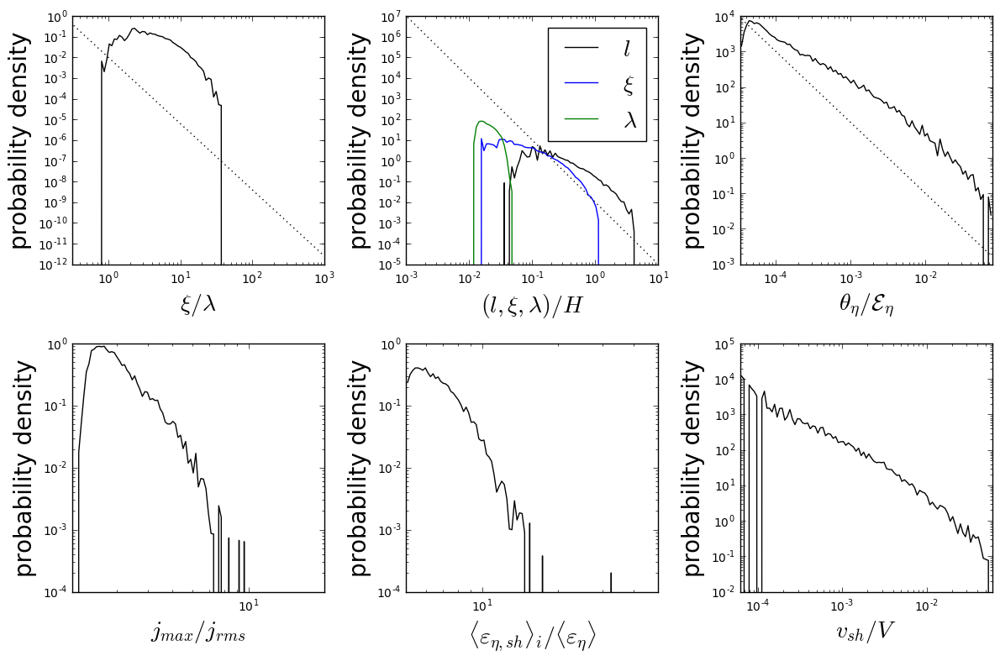

In [87]:

# import cPickle as pickle
# import athena_read as ath


# fdir = '/tigress/jiming/reconnect/athena/bin/'
# fname=fdir+'x2y4z1r64pm1re4000/Unstra.out2.00000.athdf'
# t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
# dx=data['x1f'][1]-data['x1f'][0]
# dy=data['x2f'][1]-data['x2f'][0]
# dz=data['x3f'][1]-data['x3f'][0]
# dv = dx*dy*dz
# ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))

# matplotlib.rcParams['figure.figsize'] = (12, 10)

# fname = fdir+'x2y4z1r64pm1re4000/jprop_ts=50_te=101.p'

# ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
# theta = get_normtheta('x2y4z1r64pm1re4000',50,101,1)
# theta /=float(ngridpts)
# plot_jhist(ncells,jmax,diss,size,orient,theta,50)

import cPickle as pickle
import athena_read as ath
import csheet3d 
from csheet3d import plot_jhist
from csheet3d import plot_jcorr
from csheet3d import get_normtheta

fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r64pm1re4000/Unstra.out2.00000.athdf'
t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
dx=data['x1f'][1]-data['x1f'][0]
dy=data['x2f'][1]-data['x2f'][0]
dz=data['x3f'][1]-data['x3f'][0]
dv = dx*dy*dz
ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))
fname = fdir+'x2y4z1r64pm1re4000/jprop_ts=50_te=101.p'
fname = fdir+'x2y4z1r64pm1re4000/jprop_thick_ts=50_te=101.p'


matplotlib.rcParams['figure.figsize'] = (12, 10)

ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
dissnorm,theta,jmaxnorm = get_normtheta('x2y4z1r64pm1re4000',50,101,1,eta=2.5e-4,thick=True)
theta /=float(ngridpts)
plot_jhist(dv,ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,51)

non-weighted averaged (\hat{l}) = ( 0.228544258889  , -0.555740945989  , 0.799324416417 )
vol-weighted averaged (\hat{l}) = ( -0.354568029886  , 0.133364844311  , 0.925470329338 )
dis-weighted averaged (\hat{l}) = ( -0.280123559986  , 0.578312081266  , 0.766215327308 )
non-weighted averaged (\hat{xi}) = ( 0.96802468999  , 0.243760260612  , -0.059237951649 )
vol-weighted averaged (\hat{xi}) = ( 0.945164729159  , 0.299780107601  , 0.129597537943 )
dis-weighted averaged (\hat{xi}) = ( 0.947955723581  , 0.275005142787  , 0.160474663332 )
non-weighted averaged (\hat{\lambda}) = ( 0.378974443962  , -0.0229037674551  , 0.925123661064 )
vol-weighted averaged (\hat{\lambda}) = ( -0.642161019643  , -0.295090958112  , 0.707495972633 )
dis-weighted averaged (\hat{\lambda}) = ( -0.68916516301  , -0.247521628227  , 0.681017196298 )


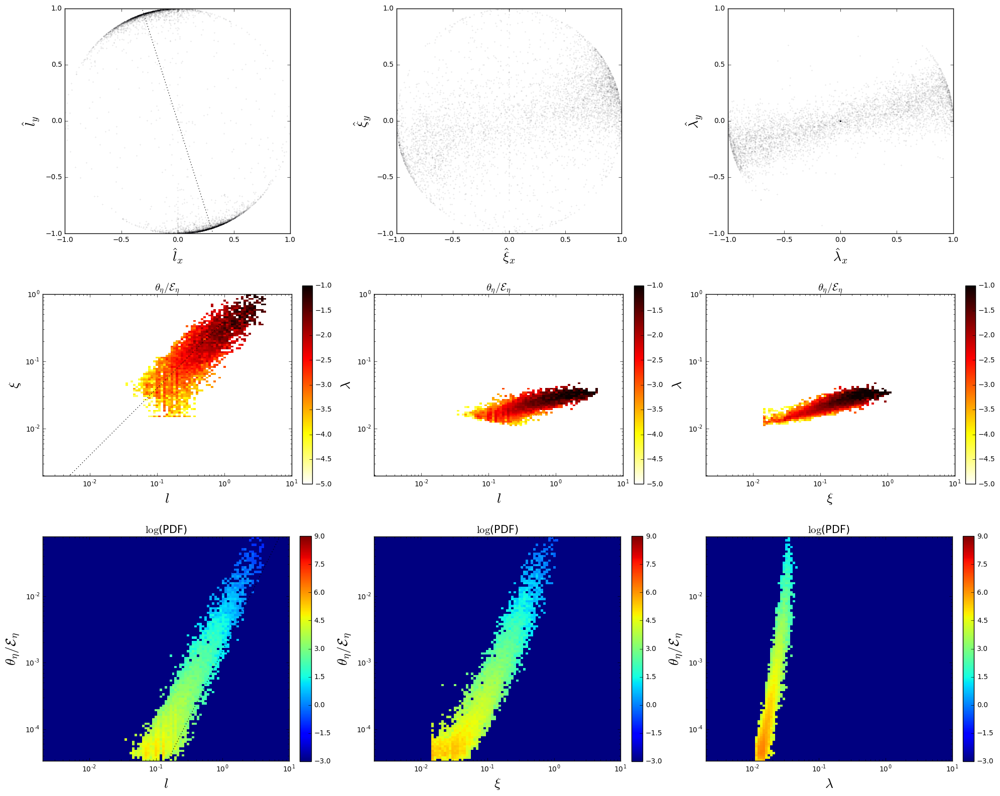

In [22]:
plot_jcorr(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=1e-4,ntime=21,cmap='hot_r')

# 128/H  Pm1Re4000

time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  10.8341616951
non-weighted averaged (l,xi,lambda,aspect) = ( 0.262552506061  , 0.0940537936976  , 0.011656145674 , 6.73228607124 )
vol-weighted averaged (l,xi,lambda,aspect) = ( 1.27000850547  , 0.38246285914  , 0.019222107556 ,  18.9715613733 )
dis-weighted averaged (l,xi,lambda,aspect) = ( 1.3811199392  , 0.418354905357  , 0.0195943126074 ,  20.5139545298 )
average theta/E_eta =  0.000678247828684
average j_max/j_rms =  3.35568385022
average epsilon =  7.79941660058
average volume fraction per sheet =  6.47723451295e-05
dis-weighted average volume fraction per sheet =  0.00101533139086
average volume fraction for all sheets =  0.0233459852583
time averaged number of current sheets =  360.431372549


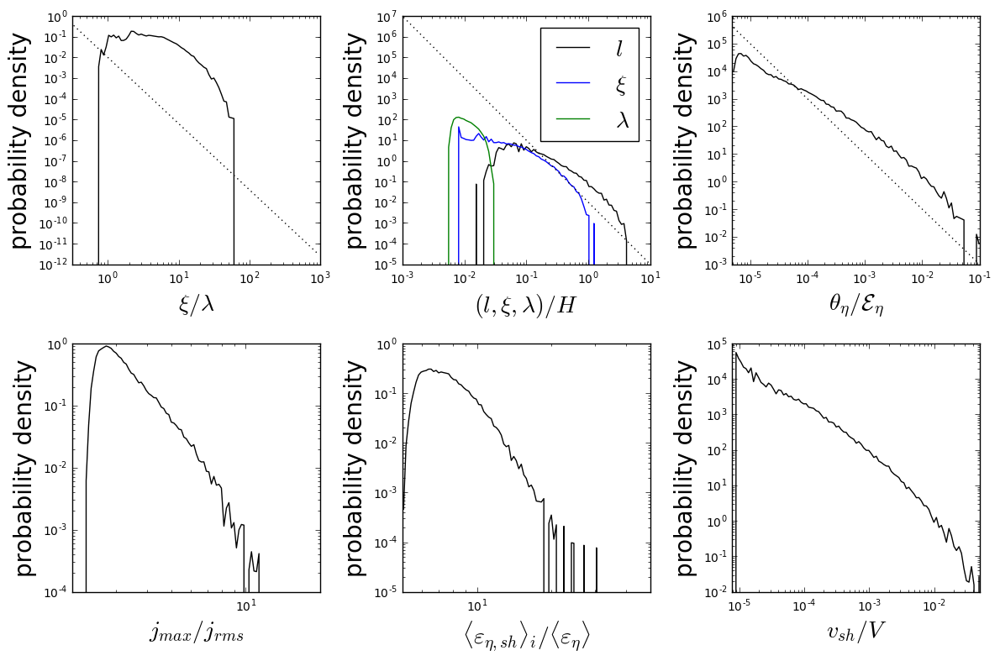

In [266]:
import cPickle as pickle
import athena_read as ath
import csheet3d 
from csheet3d import plot_jhist
from csheet3d import plot_jcorr
from csheet3d import get_normtheta

fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r128pm1re4000/Unstra.out2.00000.athdf'
t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
dx=data['x1f'][1]-data['x1f'][0]
dy=data['x2f'][1]-data['x2f'][0]
dz=data['x3f'][1]-data['x3f'][0]
dv = dx*dy*dz
ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))
fname = fdir+'x2y4z1r128pm1re4000/jprop_ts=50_te=101.p'
fname = fdir+'x2y4z1r128pm1re4000/jprop_thick_ts=50_te=101.p'
#fname = fdir+'x2y4z1r128pm1re4000/jprop_null_ts=50_te=101.p'

matplotlib.rcParams['figure.figsize'] = (12, 10)

ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
dissnorm,theta,jmaxnorm = get_normtheta('x2y4z1r128pm1re4000',50,101,1,eta=2.5e-4,thick=True) #,null=True)
theta /=float(ngridpts)
plot_jhist(dv,ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,51)

non-weighted averaged (\hat{l}) = ( 0.366290858628  , -0.647894008334  , 0.66788049893 )
vol-weighted averaged (\hat{l}) = ( 0.269900889758  , -0.926371913018  , 0.262656788374 )
dis-weighted averaged (\hat{l}) = ( 0.227576427929  , -0.8741176221  , 0.429100631771 )
non-weighted averaged (\hat{xi}) = ( 0.976618339929  , 0.193843200396  , -0.0929593017052 )
vol-weighted averaged (\hat{xi}) = ( 0.922383532494  , 0.266448338226  , -0.279667484776 )
dis-weighted averaged (\hat{xi}) = ( 0.923180965353  , 0.261164507451  , -0.282010647418 )
non-weighted averaged (\hat{\lambda}) = ( 0.558967226806  , 0.0400524177511  , 0.828221856261 )
vol-weighted averaged (\hat{\lambda}) = ( 0.493979190957  , 0.0619631073735  , -0.86726301214 )
dis-weighted averaged (\hat{\lambda}) = ( 0.462482309441  , 0.0691985568978  , -0.883924020025 )


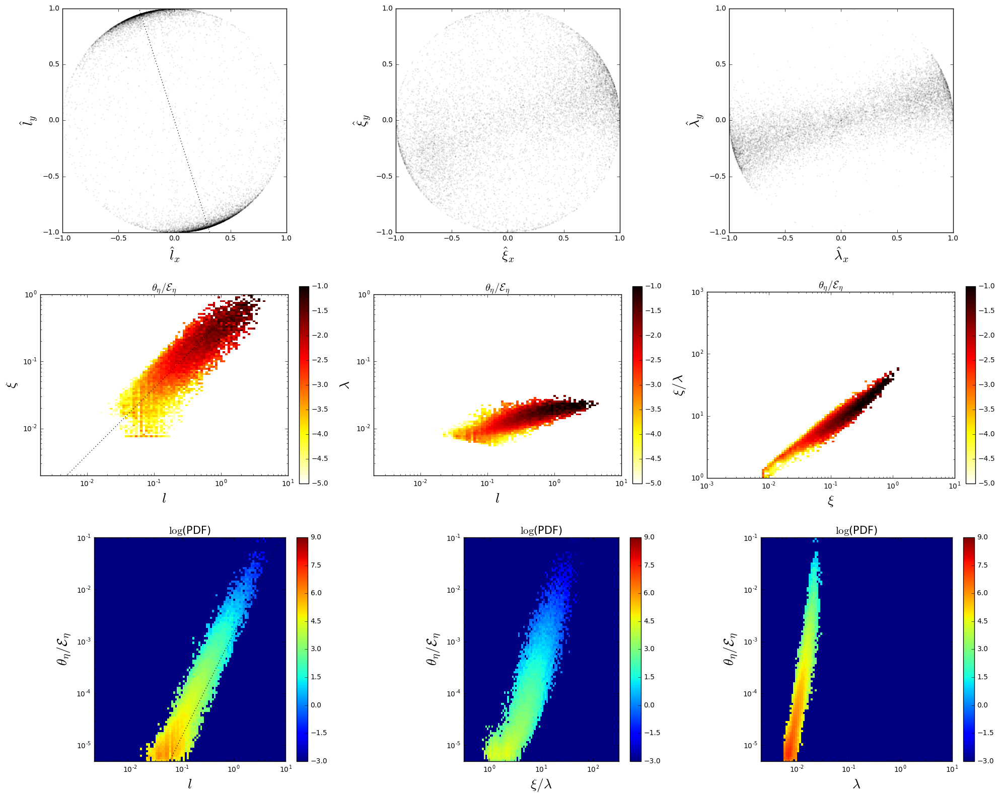

In [267]:
plot_jcorr(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=5e-5,ntime=21,cmap='hot_r')


time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  10.8341616951
non-weighted averaged (l,xi,lambda,aspect) = ( 0.83990100001  , 0.264683475875  , 0.0173364617924 , 14.4441132261 )
vol-weighted averaged (l,xi,lambda,aspect) = ( 1.75965907616  , 0.496342422784  , 0.0209677477291 ,  23.4315924785 )
dis-weighted averaged (l,xi,lambda,aspect) = ( 1.81749753321  , 0.520605891991  , 0.0209717637773 ,  24.5892676714 )
average theta/E_eta =  0.00452975919925
average j_max/j_rms =  4.86372505969
average epsilon =  9.98840038735
average volume fraction per sheet =  0.000392942152773
dis-weighted average volume fraction per sheet =  0.00148743317712
average volume fraction for all sheets =  0.0128592245682
time averaged number of current sheets =  32.7254901961


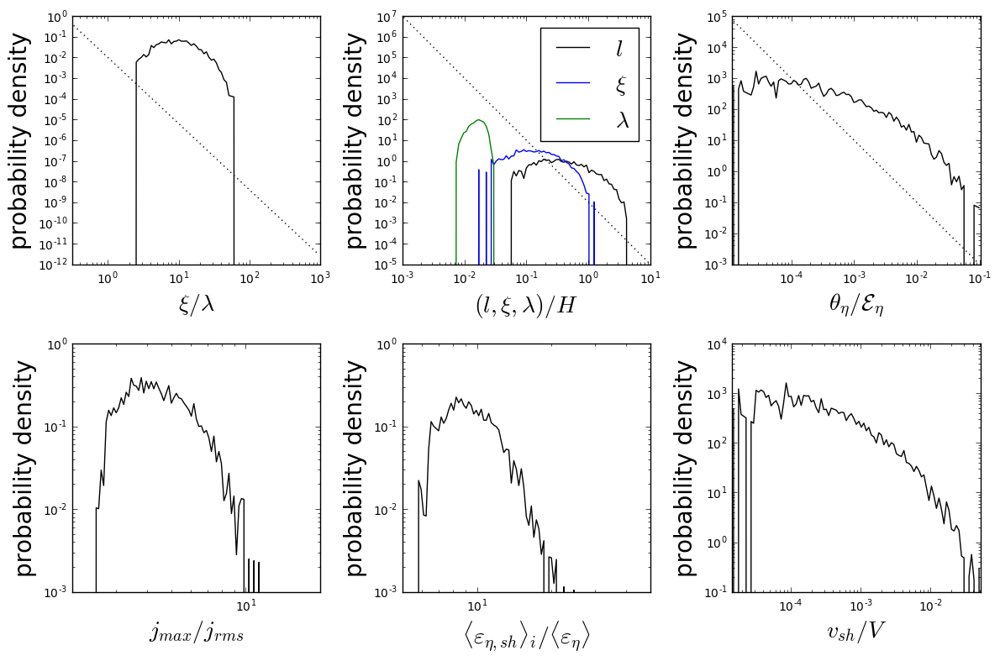

In [263]:
import cPickle as pickle
import athena_read as ath
import csheet3d 
from csheet3d import plot_jhist
from csheet3d import plot_jcorr
from csheet3d import get_normtheta

fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r128pm1re4000/Unstra.out2.00000.athdf'
t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
dx=data['x1f'][1]-data['x1f'][0]
dy=data['x2f'][1]-data['x2f'][0]
dz=data['x3f'][1]-data['x3f'][0]
dv = dx*dy*dz
ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))
fname = fdir+'x2y4z1r128pm1re4000/jprop_ts=50_te=101.p'
fname = fdir+'x2y4z1r128pm1re4000/jprop_thick_ts=50_te=101.p'
fname = fdir+'x2y4z1r128pm1re4000/jprop_null_ts=50_te=101.p'

matplotlib.rcParams['figure.figsize'] = (12, 10)

ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
dissnorm,theta,jmaxnorm = get_normtheta('x2y4z1r128pm1re4000',50,101,1,eta=2.5e-4,null=True)
theta /=float(ngridpts)
plot_jhist(dv,ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,51)

In [264]:
print theta.shape
print np.array(size).shape
print np.array(jmax).shape

(1669,)
(1669, 3)
(1669,)


non-weighted averaged (\hat{l}) = ( 0.374451505098  , -0.913880155953  , 0.156872976909 )
vol-weighted averaged (\hat{l}) = ( 0.299766371967  , -0.949470882449  , 0.092979382769 )
dis-weighted averaged (\hat{l}) = ( 0.261845762471  , -0.945056581575  , 0.195716259667 )
non-weighted averaged (\hat{xi}) = ( 0.959324480771  , 0.265946028588  , -0.0947061269005 )
vol-weighted averaged (\hat{xi}) = ( 0.865501022085  , 0.272653422251  , -0.420200062001 )
dis-weighted averaged (\hat{xi}) = ( 0.878807452503  , 0.270385530647  , -0.393178237245 )
non-weighted averaged (\hat{\lambda}) = ( 0.780791061806  , 0.565613516914  , -0.265417910641 )
vol-weighted averaged (\hat{\lambda}) = ( 0.517557785588  , 0.129231705249  , -0.845832787811 )
dis-weighted averaged (\hat{\lambda}) = ( 0.607112509546  , 0.155490455515  , -0.779254206916 )


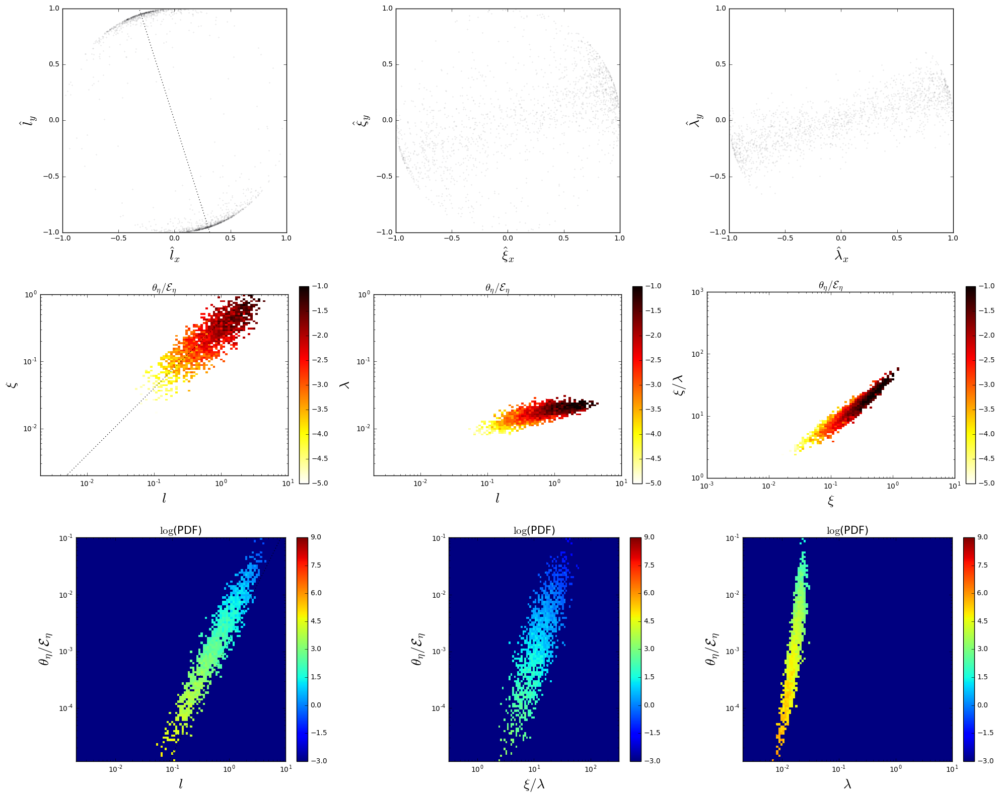

In [265]:
plot_jcorr(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=5e-5,ntime=21,cmap='hot_r')


# 256/H Pm1Re4000

time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  12.7273111652
non-weighted averaged (l,xi,lambda,aspect) = ( 0.195202384577  , 0.0742748251412  , 0.00751050450294 , 7.95967950187 )
vol-weighted averaged (l,xi,lambda,aspect) = ( 1.11140102016  , 0.354510563806  , 0.0141590024884 ,  23.8828880312 )
dis-weighted averaged (l,xi,lambda,aspect) = ( 1.22982092894  , 0.387309847344  , 0.0145038648795 ,  25.7237203902 )
average theta/E_eta =  0.000358052907884
average j_max/j_rms =  3.54261847915
average epsilon =  8.69474531767
average volume fraction per sheet =  2.89138212188e-05
dis-weighted average volume fraction per sheet =  0.000627070953512
average volume fraction for all sheets =  0.0200221327697
time averaged number of current sheets =  692.476190476


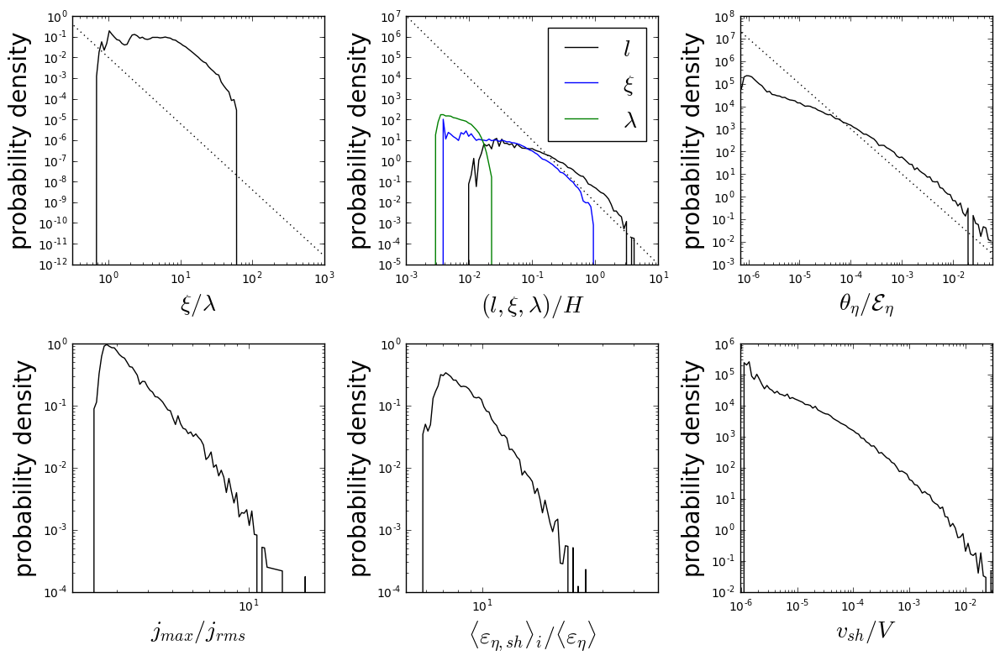

In [85]:
import cPickle as pickle
import athena_read as ath
import csheet3d 
from csheet3d import plot_jhist
from csheet3d import plot_jcorr
from csheet3d import get_normtheta

fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r256pm1re4000/Unstra.out2.00000.athdf'
t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
dx=data['x1f'][1]-data['x1f'][0]
dy=data['x2f'][1]-data['x2f'][0]
dz=data['x3f'][1]-data['x3f'][0]
dv = dx*dy*dz
ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))
fname = fdir+'x2y4z1r256pm1re4000/jprop_ts=30_te=51.p'
fname = fdir+'x2y4z1r256pm1re4000/jprop_thick_ts=30_te=51.p'


matplotlib.rcParams['figure.figsize'] = (12, 10)

ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
dissnorm,theta,jmaxnorm = get_normtheta('x2y4z1r256pm1re4000',30,51,1,eta=2.5e-4,thick=True)
theta /=float(ngridpts)
plot_jhist(dv,ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,21)

non-weighted averaged (\hat{l}) = ( 0.240019496034  , -0.822921950306  , 0.514966120466 )
vol-weighted averaged (\hat{l}) = ( 0.207204992467  , -0.952541600919  , 0.223003564133 )
dis-weighted averaged (\hat{l}) = ( 0.109163926437  , -0.959976786073  , 0.257929849699 )
non-weighted averaged (\hat{xi}) = ( 0.980979499542  , 0.190967820726  , -0.0347924262705 )
vol-weighted averaged (\hat{xi}) = ( 0.949677488706  , 0.298838153479  , 0.0938532123632 )
dis-weighted averaged (\hat{xi}) = ( 0.941502323482  , 0.311991833463  , 0.127414562474 )
non-weighted averaged (\hat{\lambda}) = ( 0.64832795338  , 0.0743571146269  , 0.757721508452 )
vol-weighted averaged (\hat{\lambda}) = ( -0.148749551994  , 0.0569435931944  , 0.987234013786 )
dis-weighted averaged (\hat{\lambda}) = ( -0.307906901324  , -0.013238409325  , 0.951324384548 )


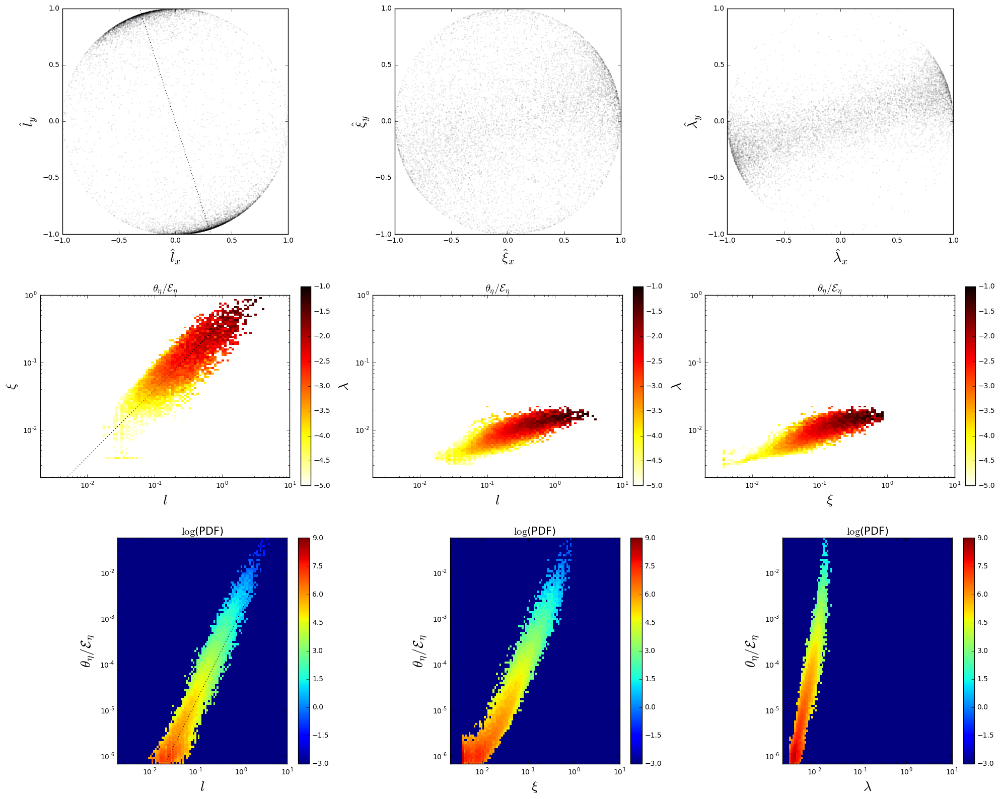

In [34]:
plot_jcorr(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=1e-5,ntime=21,cmap='hot_r')

## 512/H Pm1Re4000

time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  14.0920973336
non-weighted averaged (l,xi,lambda,aspect) = ( 0.162290026086  , 0.0640434029664  , 0.00565965351459 , 8.93978466316 )
vol-weighted averaged (l,xi,lambda,aspect) = ( 1.07022002627  , 0.353884109769  , 0.0120910021543 ,  28.1265356361 )
dis-weighted averaged (l,xi,lambda,aspect) = ( 1.16815660295  , 0.38266262175  , 0.0120922244624 ,  30.9255563232 )
average theta/E_eta =  6.1589727799e-05
average j_max/j_rms =  3.73965785618
average epsilon =  2.388342232
average volume fraction per sheet =  1.78904508101e-05
dis-weighted average volume fraction per sheet =  0.000488510560263
average volume fraction for all sheets =  0.0180951970805
time averaged number of current sheets =  1011.44444444


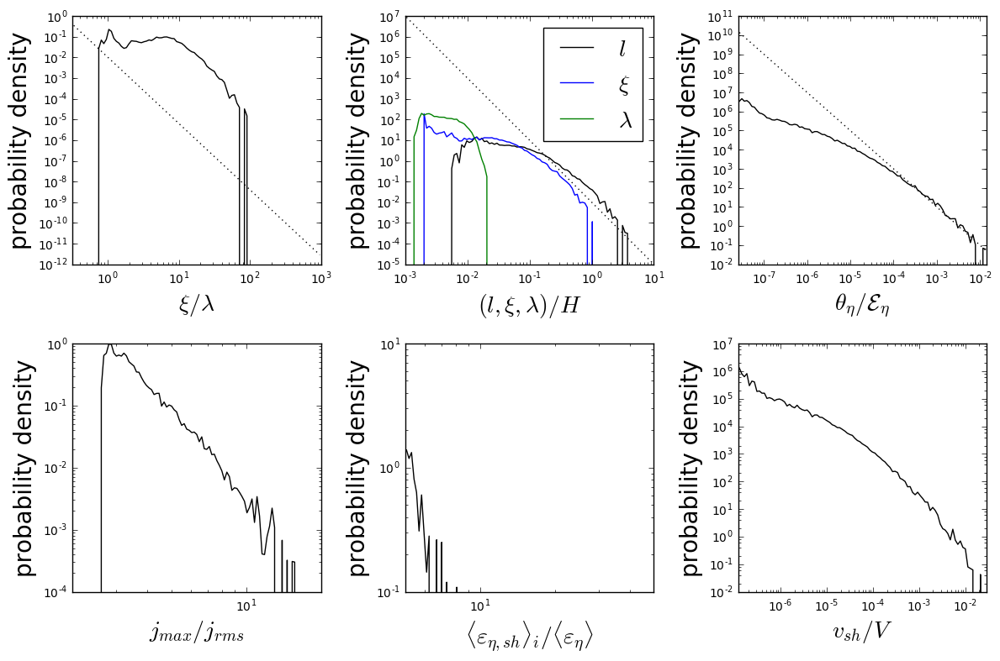

In [84]:
import cPickle as pickle
import athena_read as ath
import csheet3d 
from csheet3d import plot_jhist
from csheet3d import plot_jcorr
from csheet3d import get_normtheta

fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re4000/Unstra.out2.00000.athdf'
t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
dx=data['x1f'][1]-data['x1f'][0]
dy=data['x2f'][1]-data['x2f'][0]
dz=data['x3f'][1]-data['x3f'][0]
dv = dx*dy*dz
ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))
fname = fdir+'x2y4z1r512pm1re4000/jprop_ts=10_te=19.p'
fname = fdir+'x2y4z1r512pm1re4000/jprop_thick_ts=10_te=19.p'


matplotlib.rcParams['figure.figsize'] = (12, 10)

ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
dissnorm,theta,jmaxnorm = get_normtheta('x2y4z1r512pm1re4000',10,19,1,eta=2.5e-4,thick=True)
theta /=float(ngridpts)
plot_jhist(dv,ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,9)

non-weighted averaged (\hat{l}) = ( 0.070319120802  , -0.450364096869  , 0.890071570999 )
vol-weighted averaged (\hat{l}) = ( -0.00102117288778  , 0.888283880715  , 0.459293701751 )
dis-weighted averaged (\hat{l}) = ( 0.289581576621  , 0.705283431609  , 0.647084068402 )
non-weighted averaged (\hat{xi}) = ( 0.997037820052  , 0.0615315110388  , -0.0461460565545 )
vol-weighted averaged (\hat{xi}) = ( 0.943178613353  , -0.0749761905734  , -0.32371696613 )
dis-weighted averaged (\hat{xi}) = ( 0.563675409997  , -0.0277418638594  , -0.825530387784 )
non-weighted averaged (\hat{\lambda}) = ( 0.782576797482  , 0.113201555504  , 0.612175598888 )
vol-weighted averaged (\hat{\lambda}) = ( -0.569276225906  , 0.128579606263  , 0.812029472046 )
dis-weighted averaged (\hat{\lambda}) = ( -0.335644897046  , 0.0517953181809  , 0.940563526882 )


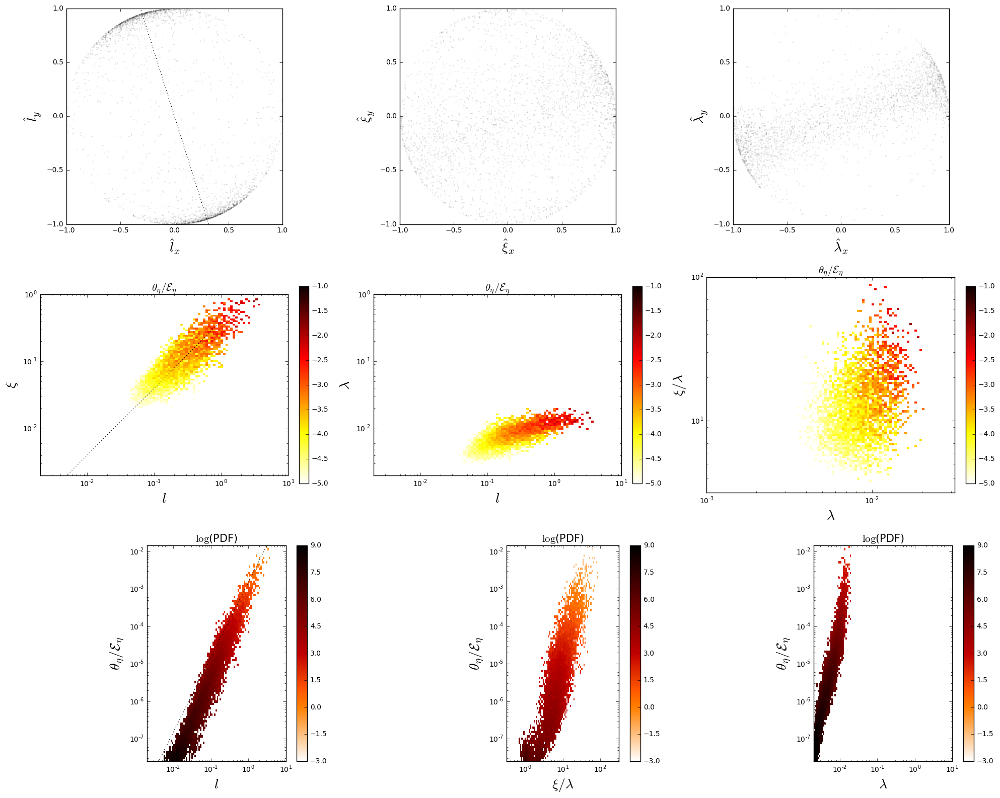

In [73]:
plot_jcorr(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=1e-5,ntime=21,cmap='hot_r')

# 256/H Pm1Re8000

time =  0.0
(26684,) (26684,) (26684,) (26684, 3, 3)
[debug] tt= [ 30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.
  45.  46.  47.  48.  49.  50.]
<epsilon_{eta,sh}>/<epsilon_{eta}> =  14.4264899244
(26684,) (26684,) (26684,)
non-weighted averaged (l,xi,lambda,aspect) = ( 0.142641156448  , 0.0558713817211  , 0.00607103347107 , 7.37107904641 )
vol-weighted averaged (l,xi,lambda,aspect) = ( 1.14918918118  , 0.366538386673  , 0.0112165137453 ,  30.6633615806 )
dis-weighted averaged (l,xi,lambda,aspect) = ( 1.29103805697  , 0.419513877295  , 0.0111773822302 ,  35.7286462178 )
average theta/E_eta =  0.000194430114433
average j_max/j_rms =  3.68154947528
average epsilon =  9.64948625004
average volume fraction per sheet =  1.43085298592e-05
dis-weighted average volume fraction per sheet =  0.000577849052958
average volume fraction for all sheets =  0.0181813719411
time averaged number of current sheets =  1270.66666667


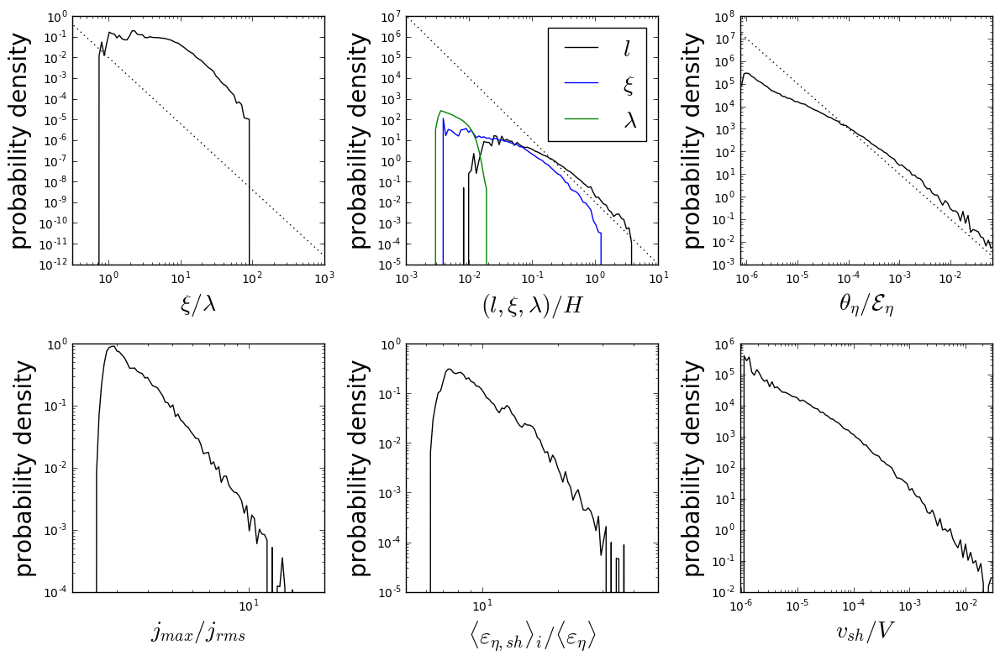

In [177]:
import cPickle as pickle
import athena_read as ath
import csheet3d 
from csheet3d import plot_jhist
from csheet3d import plot_jcorr
from csheet3d import get_normtheta


fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r256pm1re8000/Unstra.out2.00000.athdf'
t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
dx=data['x1f'][1]-data['x1f'][0]
dy=data['x2f'][1]-data['x2f'][0]
dz=data['x3f'][1]-data['x3f'][0]
dv = dx*dy*dz
ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))
fname = fdir+'x2y4z1r256pm1re8000/jprop_ts=30_te=51.p'
fname = fdir+'x2y4z1r256pm1re8000/jprop_thick_ts=30_te=51.p'


matplotlib.rcParams['figure.figsize'] = (12, 10)

ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
print np.shape(ncells),np.shape(jmax),np.shape(diss),np.shape(orient)
dissnorm,theta,jmaxnorm = get_normtheta('x2y4z1r256pm1re8000',30,51,1,eta=1.25e-4,thick=True)
print np.shape(dissnorm),np.shape(theta),np.shape(jmaxnorm)

theta /=float(ngridpts)
plot_jhist(dv,ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,21)

In [178]:
print np.shape(ncells), np.shape(jmax)
print np.shape(jmaxnorm),np.shape(diss)
print np.shape(size),np.shape(theta)

(26684,) (26684,)
(26684,) (26684,)
(26684, 3) (26684,)


non-weighted averaged (\hat{l}) = ( 0.508245227807  , -0.599538891685  , 0.618255534362 )
vol-weighted averaged (\hat{l}) = ( 0.024011472174  , -0.864226209498  , 0.502530106581 )
dis-weighted averaged (\hat{l}) = ( 0.175907644547  , -0.980928755962  , 0.0826757299153 )
non-weighted averaged (\hat{xi}) = ( 0.982683825063  , 0.162187110049  , -0.0895982214898 )
vol-weighted averaged (\hat{xi}) = ( 0.9578811937  , 0.281200049365  , 0.0582250031519 )
dis-weighted averaged (\hat{xi}) = ( 0.956376108132  , 0.291909887783  , -0.0115480392009 )
non-weighted averaged (\hat{\lambda}) = ( 0.428149335317  , 0.0435488371044  , 0.902658099977 )
vol-weighted averaged (\hat{\lambda}) = ( -0.578812123006  , -0.0820007686268  , 0.811327554201 )
dis-weighted averaged (\hat{\lambda}) = ( -0.245449240565  , -0.0308119859675  , 0.968919651894 )


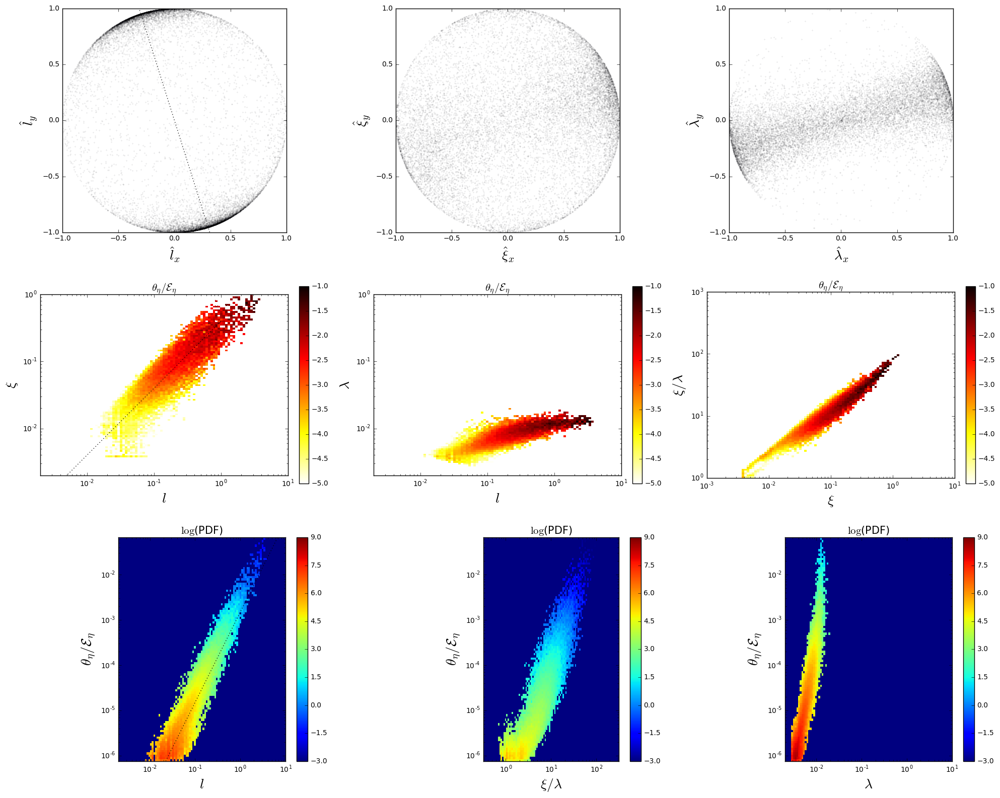

In [179]:
plot_jcorr(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=1e-5,ntime=21,cmap='hot_r')

# 256/H adiabatic run

time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  11.8209468909
non-weighted averaged (l,xi,lambda,aspect) = ( 0.155492192656  , 0.0596508140546  , 0.00613852938633 , 7.65839822104 )
vol-weighted averaged (l,xi,lambda,aspect) = ( 1.03933578346  , 0.354897817914  , 0.0117637335227 ,  28.3332118865 )
dis-weighted averaged (l,xi,lambda,aspect) = ( 1.13431797633  , 0.390504508548  , 0.0120494422343 ,  30.7195780571 )
average theta/E_eta =  0.000189775668491
average j_max/j_rms =  3.41431317366
average epsilon =  8.34321047773
average volume fraction per sheet =  1.62514629648e-05
dis-weighted average volume fraction per sheet =  0.000508589863792
average volume fraction for all sheets =  0.0211609525385
time averaged number of current sheets =  1302.0952381


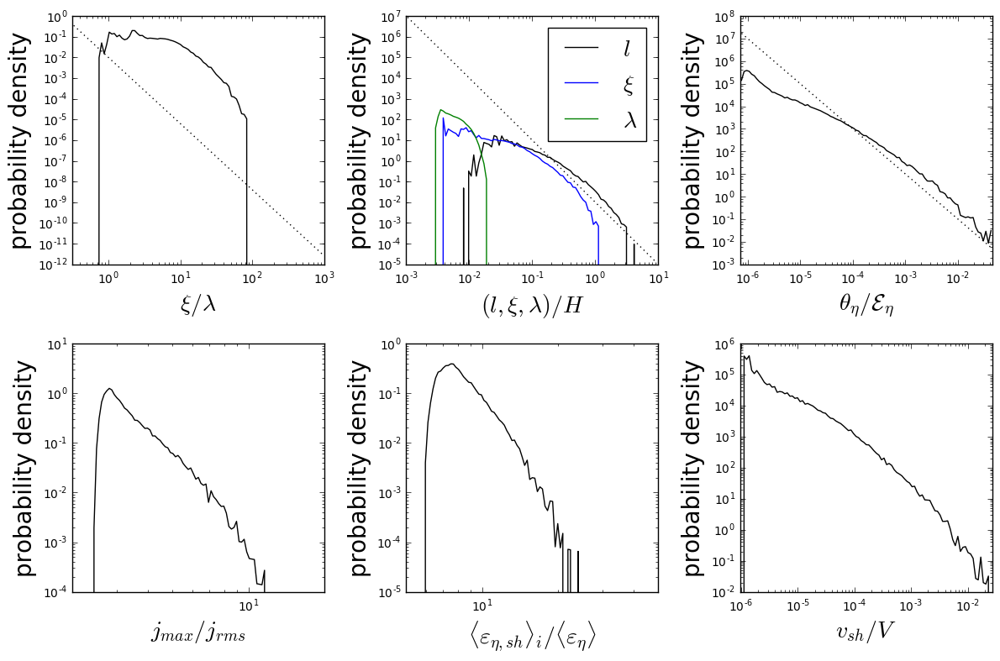

In [80]:
import cPickle as pickle
import athena_read as ath
import csheet3d 
from csheet3d import plot_jhist
from csheet3d import plot_jcorr
from csheet3d import get_normtheta


fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'adb.r256.new/Unstra.out2.00000.athdf'
t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
dx=data['x1f'][1]-data['x1f'][0]
dy=data['x2f'][1]-data['x2f'][0]
dz=data['x3f'][1]-data['x3f'][0]
dv = dx*dy*dz
ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))
fname = fdir+'adb.r256.new/jprop_ts=10_te=31.p'
fname = fdir+'adb.r256.new/jprop_thick_ts=10_te=31.p'


matplotlib.rcParams['figure.figsize'] = (12, 10)

ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
dissnorm,theta,jmaxnorm = get_normtheta('adb.r256.new',10,31,1,eta=1.25e-4)
theta /=float(ngridpts)
plot_jhist(dv,ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,21)

non-weighted averaged (\hat{l}) = ( 0.464058214772  , -0.624025900257  , 0.628682470816 )
vol-weighted averaged (\hat{l}) = ( -0.504646175998  , 0.855670243773  , 0.114719967622 )
dis-weighted averaged (\hat{l}) = ( -0.498602145805  , 0.861374840671  , 0.0971045007097 )
non-weighted averaged (\hat{xi}) = ( 0.98292601823  , 0.181554337795  , -0.0299076096455 )
vol-weighted averaged (\hat{xi}) = ( 0.955711873708  , 0.292629661751  , -0.0313479746978 )
dis-weighted averaged (\hat{xi}) = ( 0.960515099515  , 0.277422786962  , -0.0211504344851 )
non-weighted averaged (\hat{\lambda}) = ( 0.551783038959  , 0.0425220450641  , 0.832902967698 )
vol-weighted averaged (\hat{\lambda}) = ( 0.855572419385  , 0.0889341021181  , -0.509986824013 )
dis-weighted averaged (\hat{\lambda}) = ( 0.870842819068  , 0.0894479132933  , -0.483354792347 )


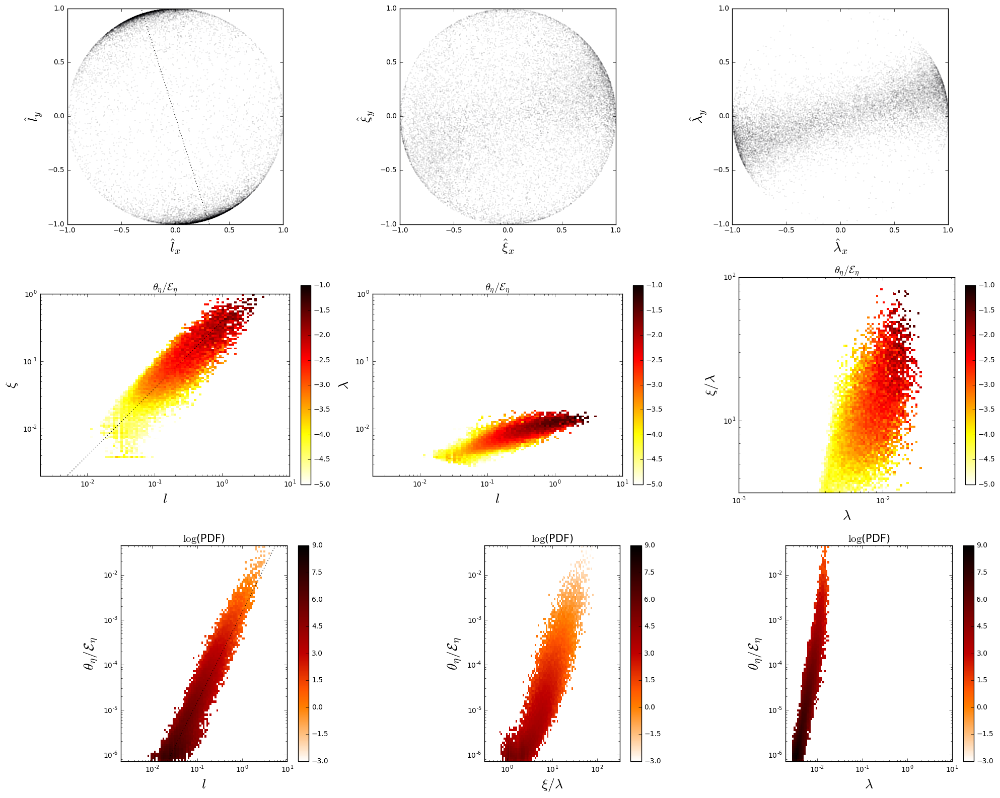

In [81]:
plot_jcorr(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=1e-5,ntime=21,cmap='hot_r')

# 512/H Pm1Re8000

time =  0.0
[debug] tt= [ 30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.  42.  43.  44.
  45.  46.  47.  48.]
<epsilon_{eta,sh}>/<epsilon_{eta}> =  19.5333787297
non-weighted averaged (l,xi,lambda,aspect) = ( 0.102669837375  , 0.0417284889309  , 0.00376777290055 , 8.42343392412 )
vol-weighted averaged (l,xi,lambda,aspect) = ( 0.93364599481  , 0.326644739802  , 0.00813141605215 ,  38.1201518372 )
dis-weighted averaged (l,xi,lambda,aspect) = ( 1.09540810736  , 0.382024610513  , 0.00791554111001 ,  46.7489035394 )
average theta/E_eta =  0.000106187618025
average j_max/j_rms =  4.15942232314
average epsilon =  12.3182933637
average volume fraction per sheet =  5.84847311713e-06
dis-weighted average volume fraction per sheet =  0.00031334808687
average volume fraction for all sheets =  0.0130213329716
time averaged number of current sheets =  2226.45


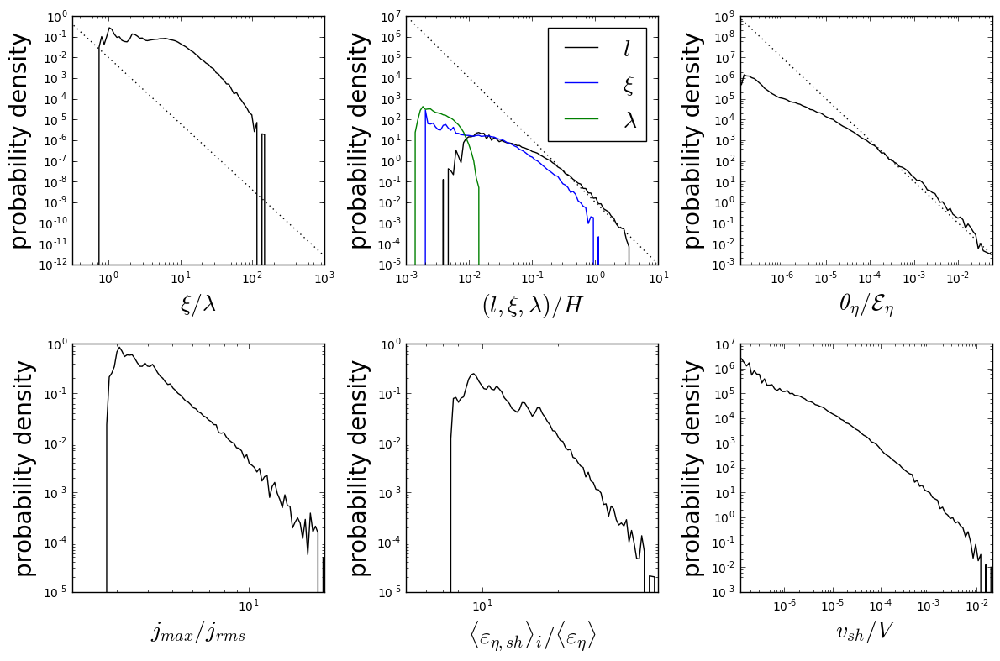

In [175]:
import cPickle as pickle
import athena_read as ath
import csheet3d 
from csheet3d import plot_jhist
from csheet3d import plot_jcorr
from csheet3d import get_normtheta


fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re8000/Unstra.out2.00000.athdf'
t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
dx=data['x1f'][1]-data['x1f'][0]
dy=data['x2f'][1]-data['x2f'][0]
dz=data['x3f'][1]-data['x3f'][0]
dv = dx*dy*dz
ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))
fname = fdir+'x2y4z1r512pm1re8000/jprop_ts=30_te=49.p'
fname = fdir+'x2y4z1r512pm1re8000/jprop_thick_ts=30_te=49.p'


matplotlib.rcParams['figure.figsize'] = (12, 10)

ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
dissnorm,theta,jmaxnorm = get_normtheta('x2y4z1r512pm1re8000',30,49,1,eta=1.25e-4,thick=True)
theta /=float(ngridpts)
plot_jhist(dv,ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,20)


non-weighted averaged (\hat{l}) = ( 0.565873456245  , -0.376606435243  , 0.73345403704 )
vol-weighted averaged (\hat{l}) = ( -0.759932502906  , -0.229608098213  , 0.608097617379 )
dis-weighted averaged (\hat{l}) = ( -0.533117929681  , -0.829863571458  , 0.16465638712 )
non-weighted averaged (\hat{xi}) = ( 0.993972804371  , 0.108208628546  , 0.017577169279 )
vol-weighted averaged (\hat{xi}) = ( 0.984154638702  , 0.131323924532  , 0.119137206475 )
dis-weighted averaged (\hat{xi}) = ( 0.9863668898  , 0.115893933868  , 0.116828741319 )
non-weighted averaged (\hat{\lambda}) = ( 0.590170895522  , 0.0652161131438  , 0.804639778202 )
vol-weighted averaged (\hat{\lambda}) = ( 0.490275787118  , -0.0510955923542  , 0.870068326632 )
dis-weighted averaged (\hat{\lambda}) = ( -0.0798718780804  , -0.0908007086481  , 0.992660926198 )


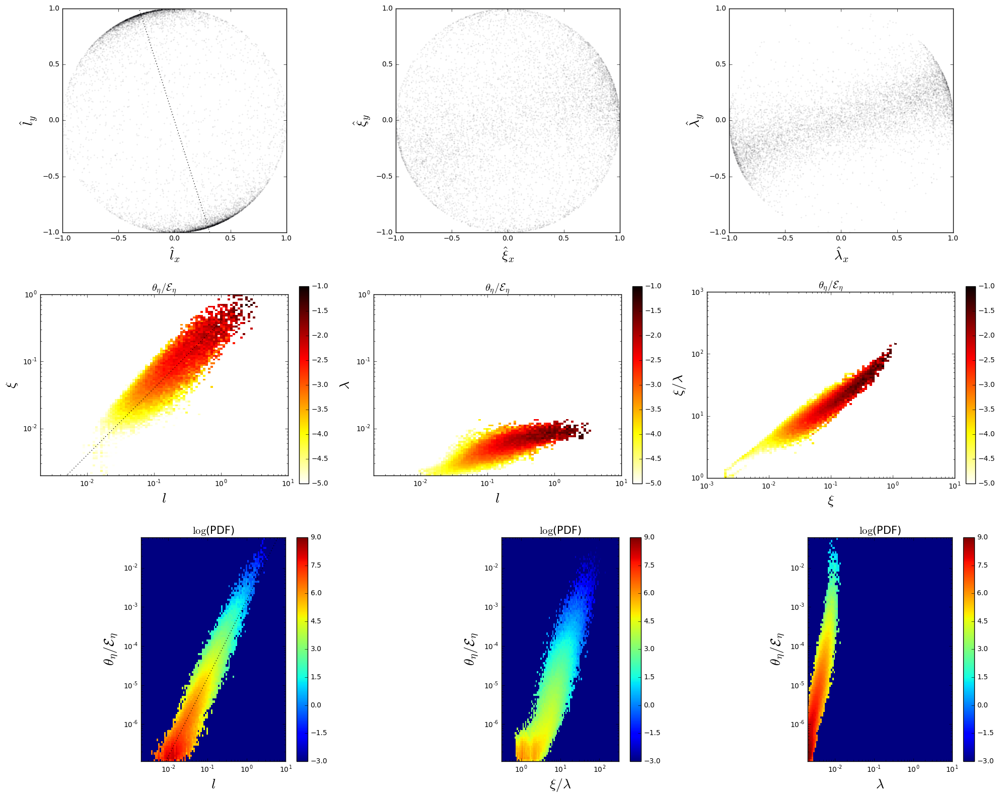

In [176]:
plot_jcorr(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=5e-5,ntime=20,cmap='hot_r')

# 512/H Pm1Re16000

time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  21.9122454566
non-weighted averaged (l,xi,lambda,aspect) = ( 0.0690876998242  , 0.0288724892742  , 0.0029198924097 , 7.52407812722 )
vol-weighted averaged (l,xi,lambda,aspect) = ( 0.909399829798  , 0.347026264358  , 0.00599079864107 ,  53.6722391921 )
dis-weighted averaged (l,xi,lambda,aspect) = ( 1.08471174643  , 0.400428879852  , 0.00605048749373 ,  62.5411203789 )
reach size2 loop
average theta/E_eta =  5.05199844281e-05
average j_max/j_rms =  4.3449170172
average epsilon =  13.7276038454
average volume fraction per sheet =  2.37638222624e-06
dis-weighted average volume fraction per sheet =  0.000258571289653
average volume fraction for all sheets =  0.0116676972476
time averaged number of current sheets =  4909.85714286


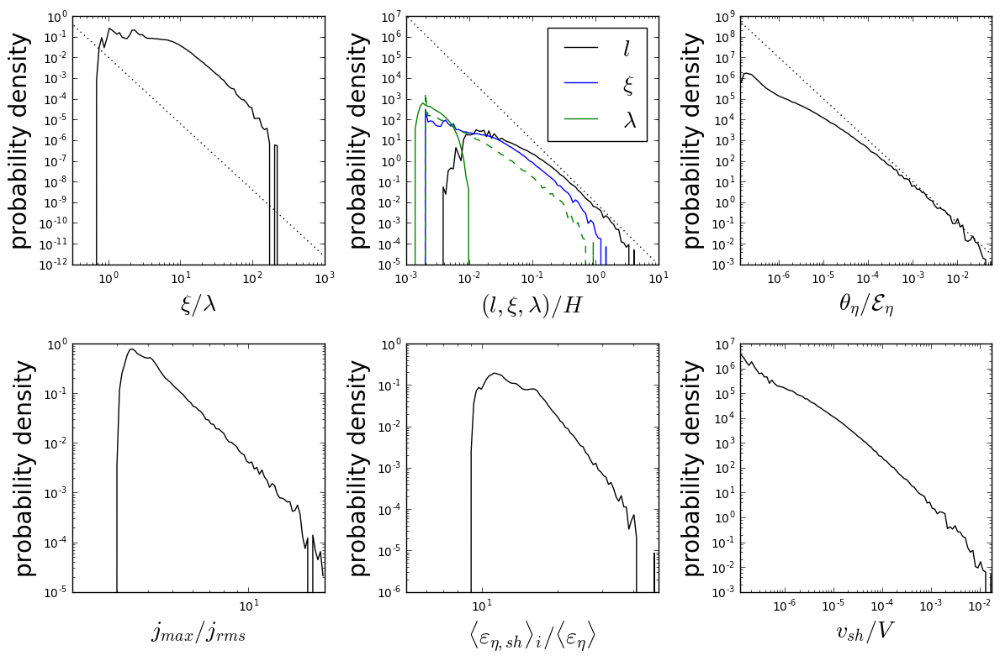

In [271]:
import cPickle as pickle
import athena_read as ath
import csheet3d 
from csheet3d import plot_jhist
from csheet3d import plot_jcorr
from csheet3d import get_normtheta


fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00000.athdf'
t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
dx=data['x1f'][1]-data['x1f'][0]
dy=data['x2f'][1]-data['x2f'][0]
dz=data['x3f'][1]-data['x3f'][0]
dv = dx*dy*dz

matplotlib.rcParams['figure.figsize'] = (12, 10)


ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))
fname = fdir+'x2y4z1r512pm1re16000/jprop_ts=30_te=51.p'
ncells,jmax,diss,size2,orient = pickle.load( open(fname, "rb" ) )

fname = fdir+'x2y4z1r512pm1re16000/jprop_thick_ts=30_te=51.p'


ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
dissnorm,theta,jmaxnorm = get_normtheta('x2y4z1r512pm1re16000',
                                        30,51,1,eta=6.25e-5,thick=True)
theta /=float(ngridpts)
plot_jhist(dv,ncells,jmax,jmaxnorm,diss,dissnorm,size,
           orient,theta,21,size2=size2)
#plt.savefig('pdf_re16000.png', format='png', dpi=300)

reach size2 loop
average theta/E_eta =  5.05199844281e-05


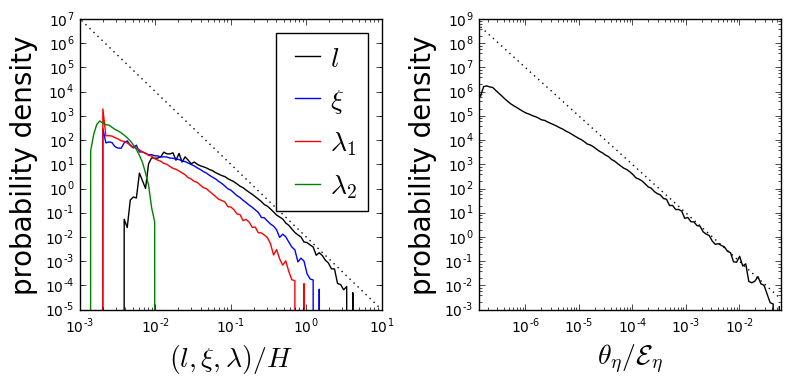

In [62]:
from csheet3d import plot_jhist_2panel

plot_jhist_2panel(dv,ncells,jmax,jmaxnorm,diss,dissnorm,size,
           orient,theta,21,size2=size2)
plt.savefig('pdf_re16000_2panel.png', format='png', dpi=300)

non-weighted averaged (\hat{l}) = ( 0.631007240184  , -0.462337709962  , 0.622955620236 )
vol-weighted averaged (\hat{l}) = ( 0.189185774839  , -0.950691378456  , 0.245753220789 )
dis-weighted averaged (\hat{l}) = ( 0.173410107223  , -0.954308447327  , 0.243360477631 )
non-weighted averaged (\hat{xi}) = ( 0.993651908732  , 0.109249577833  , -0.0268405293467 )
vol-weighted averaged (\hat{xi}) = ( 0.98853223839  , 0.140989272992  , 0.054092869808 )
dis-weighted averaged (\hat{xi}) = ( 0.991773211513  , 0.126515973985  , -0.0194834609877 )
non-weighted averaged (\hat{\lambda}) = ( 0.423969277906  , 0.0261902455608  , 0.905297808696 )
vol-weighted averaged (\hat{\lambda}) = ( -0.41409919792  , -0.196556316233  , -0.888756135748 )
dis-weighted averaged (\hat{\lambda}) = ( -0.320670696188  , -0.110317214785  , -0.9407446076 )


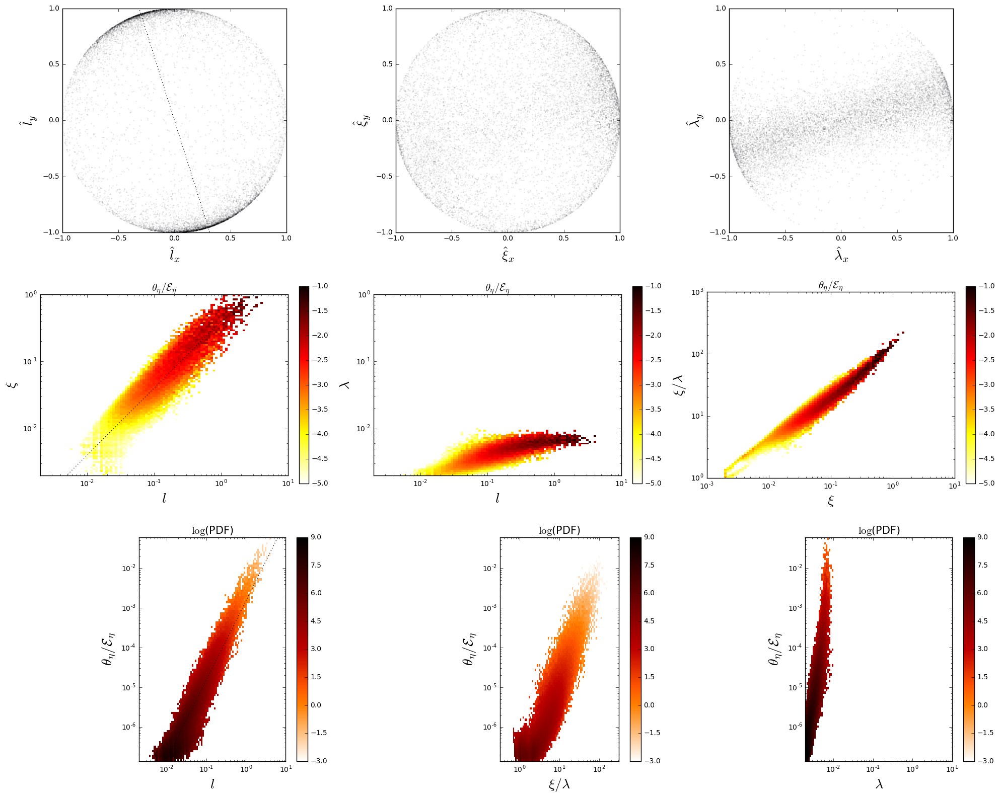

In [95]:
from csheet3d import plot_jcorr
from csheet3d import plot_exx
plot_jcorr(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=5e-5,ntime=21,cmap='hot_r')
#hst,xe,ye,xx,yy= plot_exx(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=5e-5,ntime=21,cmap='hot_r')
plt.savefig('corr_re16000.png', format='png', dpi=300)

In [272]:
size0=size
theta0=theta

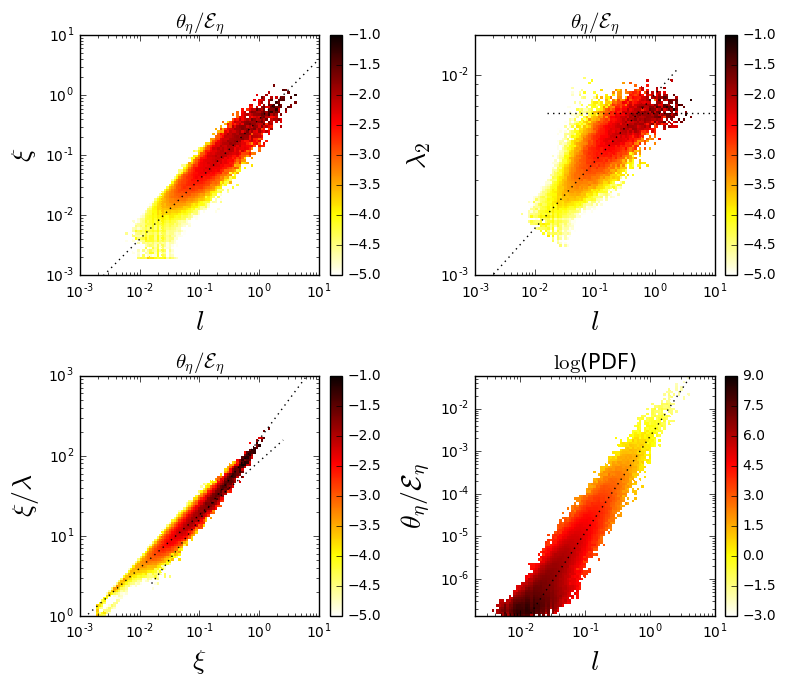

In [12]:
from csheet3d import plot_jcorr_4panel
plot_jcorr_4panel(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=5e-5,ntime=21,cmap='hot_r')
#hst,xe,ye,xx,yy= plot_exx(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=5e-5,ntime=21,cmap='hot_r')
plt.savefig('corr_re16000_4panel_new.png', format='png', dpi=300)

## sheets with null pts

time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  21.9122454566
non-weighted averaged (l,xi,lambda,aspect) = ( 0.335799534767  , 0.139379198905  , 0.00500632405172 , 24.7782086685 )
vol-weighted averaged (l,xi,lambda,aspect) = ( 1.2874197944  , 0.476623884813  , 0.00656708578856 ,  71.3968083243 )
dis-weighted averaged (l,xi,lambda,aspect) = ( 1.40927245499  , 0.507660301422  , 0.00645215569598 ,  77.7333557334 )
reach size2 loop
average theta/E_eta =  0.000794860545562
average j_max/j_rms =  7.28901202844
average epsilon =  18.774478142
average volume fraction per sheet =  3.35302405235e-05
dis-weighted average volume fraction per sheet =  0.000358973348153
average volume fraction for all sheets =  0.00719143825323
time averaged number of current sheets =  214.476190476


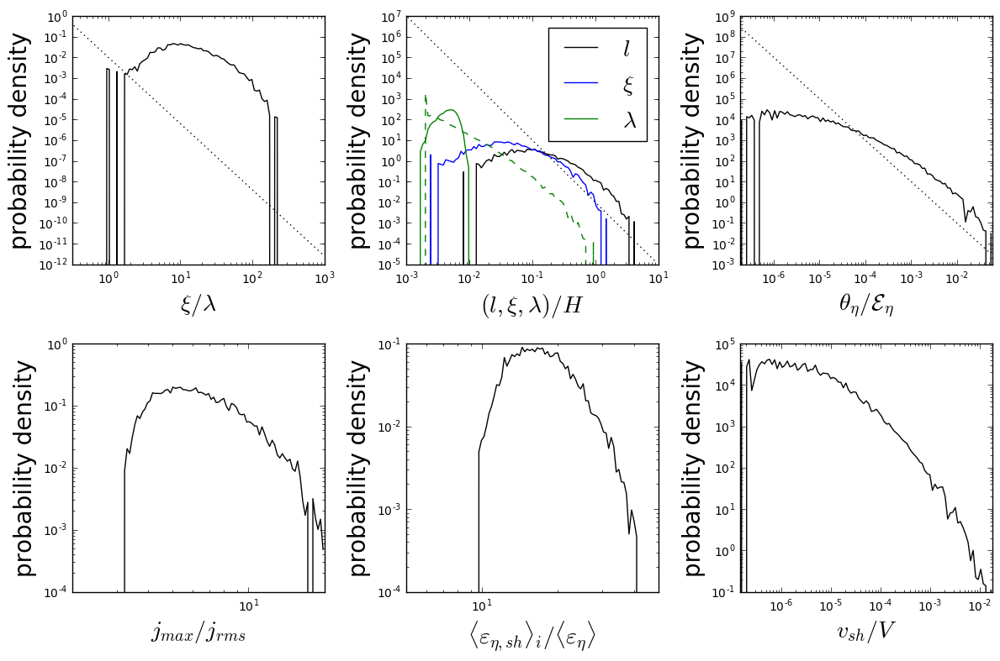

In [284]:
import cPickle as pickle
import athena_read as ath
import csheet3d 
from csheet3d import plot_jhist
from csheet3d import plot_jcorr
from csheet3d import get_normtheta


fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00000.athdf'
t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
dx=data['x1f'][1]-data['x1f'][0]
dy=data['x2f'][1]-data['x2f'][0]
dz=data['x3f'][1]-data['x3f'][0]
dv = dx*dy*dz

matplotlib.rcParams['figure.figsize'] = (12, 10)


ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))
# fname = fdir+'x2y4z1r512pm1re16000/jprop_ts=30_te=51.p'
# ncells,jmax,diss,size2,orient = pickle.load( open(fname, "rb" ) )

fname = fdir+'x2y4z1r512pm1re16000/jprop_null_ts=30_te=51.p'


ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
dissnorm,theta,jmaxnorm = get_normtheta('x2y4z1r512pm1re16000',
                                        30,51,1,eta=6.25e-5,null=True)
theta /=float(ngridpts)
plot_jhist(dv,ncells,jmax,jmaxnorm,diss,dissnorm,size,
           orient,theta,21,size2=size2)
#plt.savefig('pdf_re16000.png', format='png', dpi=300)

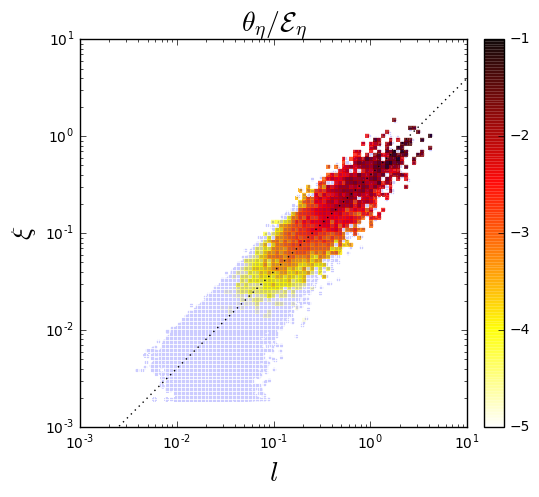

In [309]:
from csheet3d import plot_jcorr_null
plot_jcorr_null(size0,theta0,size,theta,cmap='bone_r',cmap1='hot_r')
#hst,xe,ye,xx,yy= plot_exx(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=5e-5,ntime=21,cmap='hot_r')
plt.savefig('null_nonull.png', format='png', dpi=300)

# 256/H ideal

(0.001, 5)

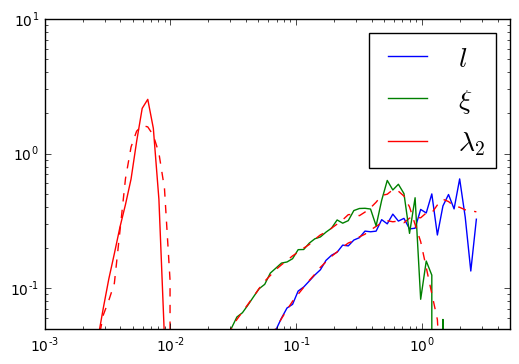

In [93]:
# plt.plot(xe[1:],np.sum(hst*yy[1:,1:],axis=1))
# plt.xscale('log')
# plt.yscale('log')
# plt.ylim([0.1,10])
# plt.xlim([1e-3,3])
# # plt.imshow(np.log10(1e-12+hst),origin='lower',cmap='hot_r',vmin=-5,vmax=-1)
# plt.plot(np.sum(hst))
import savgol as sg
fname = fdir+'x2y4z1r512pm1re16000/jprop_thick_ts=30_te=51.p'
matplotlib.rcParams['figure.figsize'] = (6, 4)

ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
ncelltot= float(np.sum(np.array(ncells)))
diss_sheet = np.array(ncells)*np.array(diss)
disstot= float(np.sum(diss_sheet))

vmin,vmax,nbins = -3,0.5,80
length= (np.array(size))[:,0]
hist, bins = np.histogram(length, bins=np.logspace(vmin,vmax,nbins),
                            density=True,weights=diss_sheet)
#print bins
center = 10**((np.log10(bins[:-1])+np.log10(bins[1:]))/2)
plt.plot(center[:-1],hist[:-1]*center[:-1],label=r'$l$')
plt.plot(center[:-1],sg.savitzky_golay(hist[:-1]*center[:-1],11,3),'r--')

length= (np.array(size))[:,1]
hist, bins = np.histogram(length, bins=np.logspace(vmin,vmax,nbins),
                            density=True,weights=diss_sheet)
#print bins
center = 10**((np.log10(bins[:-1])+np.log10(bins[1:]))/2)
plt.plot(center[:-1],hist[:-1]*center[:-1],label=r'$\xi$')
plt.plot(center[:-1],sg.savitzky_golay(hist[:-1]*center[:-1],11,3),'r--')


#vmin,vmax,nbins = -4,-2,100
length= (np.array(size))[:,2]
hist, bins = np.histogram(length, bins=np.logspace(vmin,vmax,nbins),
                            density=True,weights=diss_sheet)
#print bins
center = 10**((np.log10(bins[:-1])+np.log10(bins[1:]))/2)
plt.plot(center[:-1],hist[:-1]*center[:-1],label=r'$\lambda_2$')
plt.plot(center[:-1],sg.savitzky_golay(hist[:-1]*center[:-1],11,3),'r--')

plt.legend(fontsize=20,loc=1)
plt.xscale('log')
plt.yscale('log')
plt.ylim([5e-2,10])
plt.xlim([1e-3,5])

time =  0.0
58855
<epsilon_{eta,sh}>/<epsilon_{eta}> =  15.1507425092
non-weighted averaged (l,xi,lambda,aspect) = ( 0.094995528228  , 0.0394633789048  , 0.00499190605475 , 6.41199372723 )
vol-weighted averaged (l,xi,lambda,aspect) = ( 0.946289888567  , 0.365761977439  , 0.00864429091082 ,  39.1646898529 )
dis-weighted averaged (l,xi,lambda,aspect) = ( 1.06520976007  , 0.417337375117  , 0.00885548544912 ,  44.4436261916 )
average theta/E_eta =  8.71750196702e-05
average j_max/j_rms =  3.80855160806
average epsilon =  10.352012846
average volume fraction per sheet =  5.85991060999e-06
dis-weighted average volume fraction per sheet =  0.00043632957273
average volume fraction for all sheets =  0.0164230970929
time averaged number of current sheets =  2802.61904762


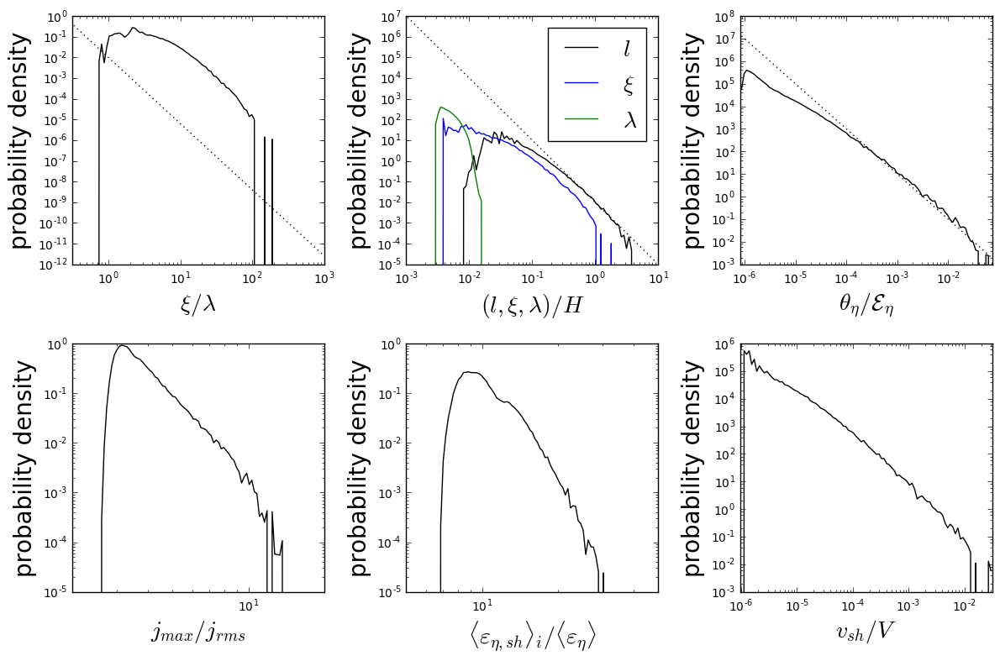

In [88]:
import cPickle as pickle
import athena_read as ath
import csheet3d 
from csheet3d import plot_jhist
from csheet3d import plot_jcorr
from csheet3d import get_normtheta


fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r256ideal/Unstra.out2.00000.athdf'
t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
dx=data['x1f'][1]-data['x1f'][0]
dy=data['x2f'][1]-data['x2f'][0]
dz=data['x3f'][1]-data['x3f'][0]
dv = dx*dy*dz
ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))
fname = fdir+'x2y4z1r256ideal/jprop_ts=30_te=51.p'
fname = fdir+'x2y4z1r256ideal/jprop_thick_ts=30_te=51.p'


matplotlib.rcParams['figure.figsize'] = (12, 10)

ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
print len(ncells)
dissnorm,theta,jmaxnorm = get_normtheta('x2y4z1r256ideal',30,51,1,eta=1.25e-4)
theta /=float(ngridpts)
plot_jhist(dv,ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,21)
plt.savefig('pdf_ideal256.png', format='png', dpi=300)

In [54]:
print np.average(np.array(ncells))

387.10738255


non-weighted averaged (\hat{l}) = ( 0.453896773713  , -0.469077016787  , 0.757591229579 )
vol-weighted averaged (\hat{l}) = ( 0.183410428617  , -0.944138844475  , 0.273792726398 )
dis-weighted averaged (\hat{l}) = ( 0.132799007181  , -0.933753739703  , 0.332367834307 )
non-weighted averaged (\hat{xi}) = ( 0.988920259641  , 0.12787193219  , -0.0754021818551 )
vol-weighted averaged (\hat{xi}) = ( 0.980798435146  , 0.194932291837  , 0.00598591806023 )
dis-weighted averaged (\hat{xi}) = ( 0.980681408362  , 0.195556135692  , -0.00466616393554 )
non-weighted averaged (\hat{\lambda}) = ( 0.402068819694  , 0.0108899374514  , 0.915544686781 )
vol-weighted averaged (\hat{\lambda}) = ( -0.0373025429809  , 0.0325713095568  , 0.998773062352 )
dis-weighted averaged (\hat{\lambda}) = ( -0.169945715843  , -0.00341819531196  , 0.985447497134 )


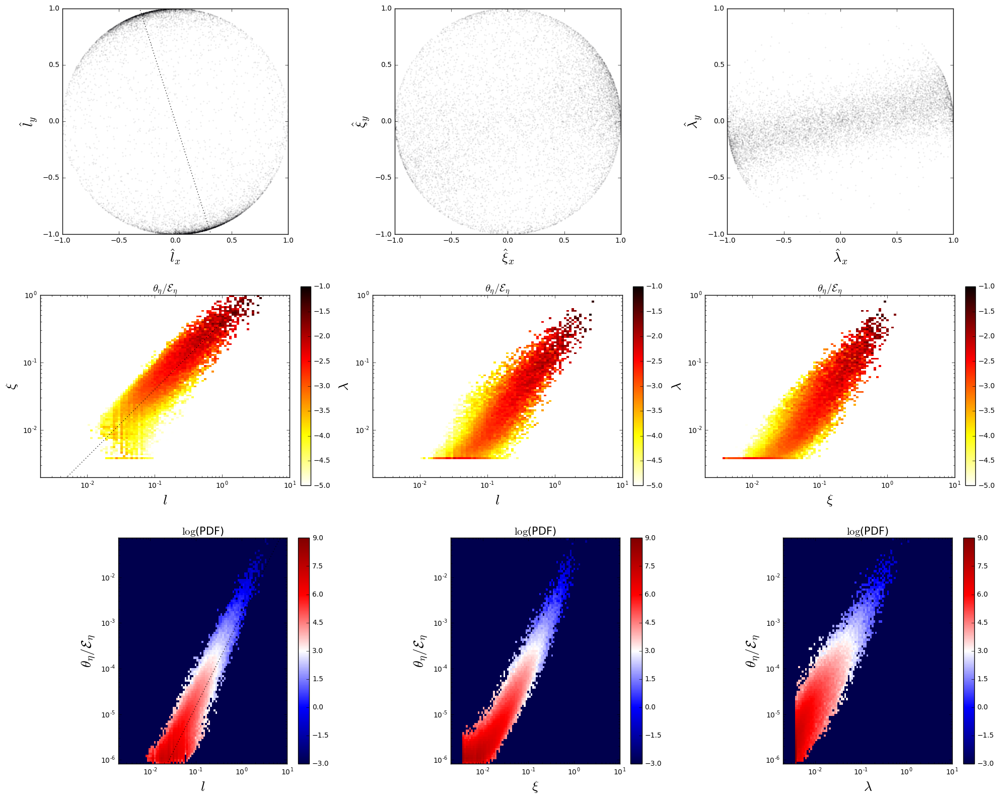

In [46]:
from csheet3d import plot_jcorr
plot_jcorr(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=5e-5,ntime=21,cmap='hot_r')

## exploring the effect of sheet cut-off size 
* above analysis are done for all sheets greater than 8 cells
* study with individual snapshot from r512pm1re16000 show that varying that selection criterion does not affect the overall distribution of current sheets

time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  16.6559567947
non-weighted averaged (lambda,xi,l) = ( 0.0759128806198  , 0.0328860464144  , 0.00960237488351 )
vol-weighted averaged (lambda,xi,l) = ( 0.92566043524  , 0.378074406472  , 0.16938832877 )
dis-weighted averaged (lambda,xi,l) = ( 1.03510297154  , 0.420826225164  , 0.190808465439 )
average theta/E_eta =  4.48838247502e-05
average j_max/j_rms =  3.94967670016
average epsilon =  11.0496902561
average volume fraction per sheet =  2.69292207682e-06
dis-weighted average volume fraction per sheet =  0.000292238813538
average volume fraction for all sheets =  0.000709136146897
time averaged number of current sheets =  263.333333333


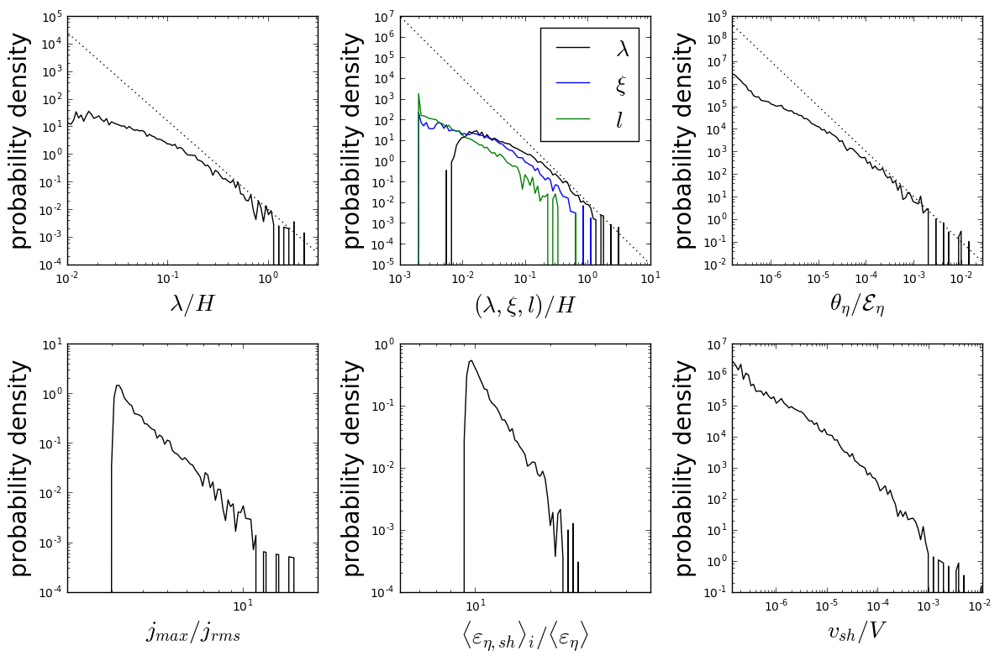

In [100]:
%matplotlib inline
fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00000.athdf'
t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
dx=data['x1f'][1]-data['x1f'][0]
dy=data['x2f'][1]-data['x2f'][0]
dz=data['x3f'][1]-data['x3f'][0]
dv = dx*dy*dz
fname = fdir+'x2y4z1r512pm1re16000/prop_nlim=8/jprop.00050.p'
ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))



matplotlib.rcParams['figure.figsize'] = (12, 10)

ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
dissnorm,theta,jmaxnorm = get_normtheta('x2y4z1r512pm1re16000',50,51,1,eta=6.25e-5)
theta /=float(ngridpts)
plot_jhist(dv,ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,21)

time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  16.6559567947
non-weighted averaged (lambda,xi,l) = ( 0.0428016962939  , 0.0179519155405  , 0.0058803986845 )
vol-weighted averaged (lambda,xi,l) = ( 0.922863515456  , 0.376928076358  , 0.168877550001 )
dis-weighted averaged (lambda,xi,l) = ( 1.03332924433  , 0.420102875006  , 0.190482058651 )
average theta/E_eta =  4.48838247502e-05
average j_max/j_rms =  3.94967670016
average epsilon =  11.0496902561
average volume fraction per sheet =  1.38681898699e-06
dis-weighted average volume fraction per sheet =  0.000291733741289
average volume fraction for all sheets =  0.000711306062325
time averaged number of current sheets =  512.904761905


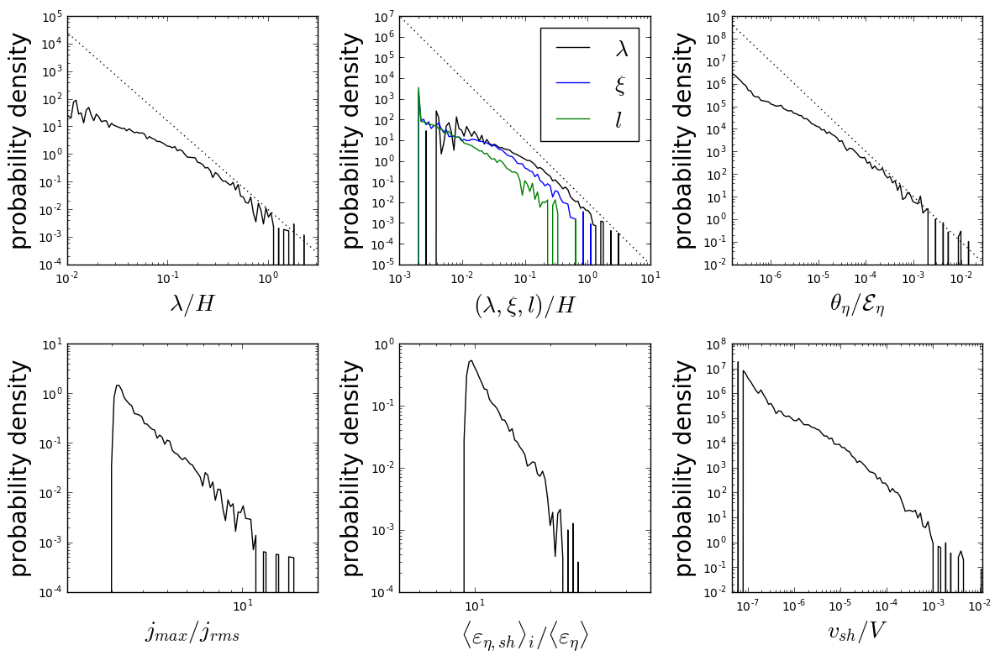

In [101]:
fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00000.athdf'
t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
dx=data['x1f'][1]-data['x1f'][0]
dy=data['x2f'][1]-data['x2f'][0]
dz=data['x3f'][1]-data['x3f'][0]
dv = dx*dy*dz
fname = fdir+'x2y4z1r512pm1re16000/jprop.00050_nlim=3.p'
ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))



matplotlib.rcParams['figure.figsize'] = (12, 10)

ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
dissnorm,theta,jmaxnorm = get_normtheta('x2y4z1r512pm1re16000',50,51,1,eta=6.25e-5)
theta /=float(ngridpts)
plot_jhist(dv,ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,21)

<!--
 A few averages
 $\bar{A}\equiv \frac{ \int A dt } {  \int dt}$; $\langle A \rangle \equiv \frac{\int A dv}{\int dv}$
 
 * $\langle\overline\epsilon\rangle_{sh}\simeq 0.59, 0.590,0.931$
 * $\langle \overline{(\lambda,\xi,l)} \rangle \simeq (0.448,0.141,0.048),(0.275,0.099,0.031),(0.202,0.077,0.0234) $
 * $\langle \overline{j_{max}}\rangle\simeq 38.2,57.6,72.7$
 * $\langle \overline{v_{sheet}/v_{tot}}\rangle\simeq 0.00374,0.0238,0.0673$  volume ratio of all sheets and whole box
 -->

## 3.2 comparison of various runs

time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  10.8341616951
time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  12.7273111652
time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  14.0920973336
time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  14.4264899244
time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  19.5333787297
time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  21.9122454566
time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  15.1507425092
time =  0.0
<epsilon_{eta,sh}>/<epsilon_{eta}> =  11.8209468909


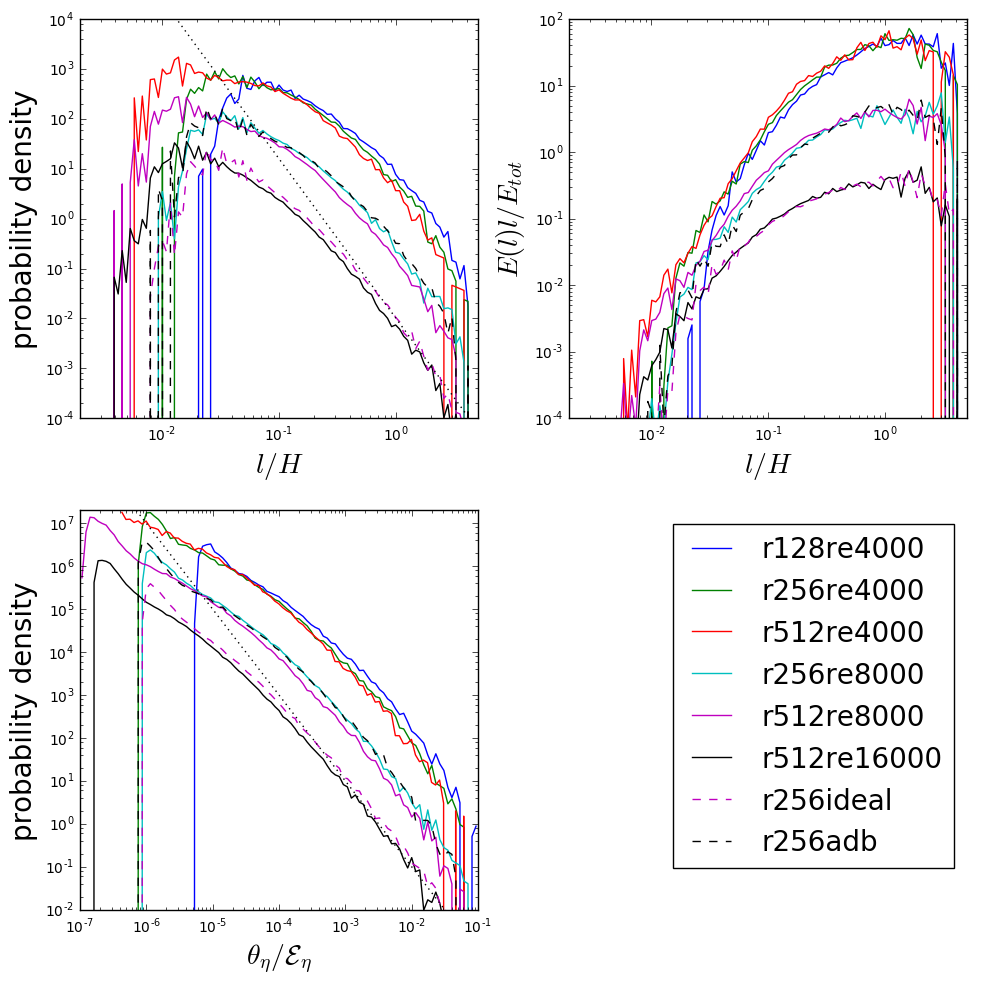

In [122]:
import cPickle as pickle
import athena_read as ath
import csheet3d 
from csheet3d import plot_jhist
from csheet3d import plot_jcorr
from csheet3d import get_normtheta

targlist=[  'x2y4z1r64pm1re4000', 'x2y4z1r128pm1re4000',\
            'x2y4z1r256pm1re4000','x2y4z1r256pm1re8000',\
            'x2y4z1r512pm1re8000','x2y4z1r512pm1re16000',\
            'x2y4z1r256ideal','adb.r256']

targlist=[ 'x2y4z1r128pm1re4000',\
            'x2y4z1r256pm1re4000',\
            'x2y4z1r512pm1re4000','x2y4z1r256pm1re8000',\
            'x2y4z1r512pm1re8000','x2y4z1r512pm1re16000',\
            'x2y4z1r256ideal','adb.r256.new']
fdir = '/tigress/jiming/reconnect/athena/bin/'
ntarg = len(targlist)
count = 0
first_time = True
for targ in targlist:
    # prepare theta
    fname=fdir+targ+'/Unstra.out2.00000.athdf'
    t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
    dx=data['x1f'][1]-data['x1f'][0]
    dy=data['x2f'][1]-data['x2f'][0]
    dz=data['x3f'][1]-data['x3f'][0]
    dv = dx*dy*dz
    ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))
    if targ[7:9]=='64' or targ[7:10]=='128':
        fname = fdir+targ+ '/jprop_ts=50_te=101.p'
        ts,te = 50,101
    elif targ=='x2y4z1r512pm1re8000':
        fname = fdir+targ+ '/jprop_ts=30_te=49.p'
        ts,te=30,49
    elif targ=='x2y4z1r512pm1re4000':
        fname = fdir+targ+ '/jprop_thick_ts=10_te=19.p'
        ts,te=10,19
    elif targ[0:8]=='adb.r256':
        fname = fdir+targ+ '/jprop_ts=10_te=31.p'
        ts,te=10,31
    else:
        fname = fdir+targ+'/jprop_ts=30_te=51.p'
        ts,te=30,51
        
    if targ[-4:]=='4000':
        eta,mp,xmp = 2.5e-4,100,1 #100
    elif targ[-4:]=='8000':
        eta,mp,xmp = 1.25e-4,10,1 #2**(0.6) #10
    elif targ[-5:]=='16000':
        eta,mp,xmp = 6.25e-5,1,1 #4**(0.6)
    elif targ[-5:]=='ideal':
        eta,mp,xmp = 1.25e-4,1,1
    elif targ[0:8] =='adb.r256':
        eta,mp,xmp = 1.25e-4,10,1#2**(0.6)
    else:
        eta,mp,xmp = 6.25e-5,1,1
        
    thick=False
    if targ=='x2y4z1r512pm1re4000':
        thick=True
    ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
    dissnorm,theta,jmaxnorm = get_normtheta(targ,ts,te,1,eta=eta,thick=thick)
    theta /=float(ngridpts)
    # compute pdf of size[0]
    vmin1,vmax1,nbin=-2.7,0.7,100
    hdata = np.array(size)[:,0]
    hist1, bins1 = np.histogram(hdata, bins=np.logspace(vmin1,vmax1,nbin),density=1)
    # compute pdf of theta
    vmin2,vmax2,nbin=-7,-1,100
    hdata = theta
    hist2, bins2 = np.histogram(hdata, bins=np.logspace(vmin2,vmax2,nbin),density=1)
    # compute pdf of size[0]*E
    vmin1,vmax1,nbin=-2.7,0.7,100
    hdata = np.array(size)[:,0]
    hist3, bins3 = np.histogram(hdata, bins=np.logspace(vmin1,vmax1,nbin),density=1,weights=theta)
    if first_time:
        center1 = 10**((np.log10(bins1[:-1])+np.log10(bins1[1:]))/2)
        hist_lamb = np.zeros([len(center1),ntarg])
        center2 = 10**((np.log10(bins2[:-1])+np.log10(bins2[1:]))/2)
        hist_theta = np.zeros([len(center2),ntarg])
        center3 = 10**((np.log10(bins3[:-1])+np.log10(bins3[1:]))/2)
        hist_exx = np.zeros([len(center3),ntarg])
        mplier = np.zeros([ntarg])
        xmplier = np.zeros([ntarg])
        first_time = False
    hist_lamb[:,count] = hist1[:]
    hist_theta[:,count]= hist2[:]
    hist_exx[:,count] = hist3[:]
    mplier[count] = mp
    xmplier[count] = xmp
    count +=1

    
#linewidth = [0.75,1.5,3,3,4.5,4.5]  #width for various resolution
linestyle = ['-','-','-','-','-','-','--','--'] # linestyle to show various Re
ctable = ['b', 'g', 'r', 'c', 'm', 'k', 'm', 'k']
label=['r128re4000','r256re4000','r512re4000',
      'r256re8000','r512re8000','r512re16000',
      'r256ideal','r256adb']
matplotlib.rcParams['figure.figsize'] = (10,10)    
plt.subplot(2,2,1)
for i in np.arange(count):
  plt.plot(center1*xmplier[i],hist_lamb[:,i]*mplier[i],
           linestyle[i]+ctable[i],label=label[i])

plt.xlabel(r'$l/H$',size=20)
plt.ylabel('probability density',size=20)
plt.xlim([10**vmin1,10**vmax1])
plt.ylim([10**(-4),10**4])
plt.xscale("log")
plt.yscale("log")
index,coef=-3.2,1e-2
plt.plot(center1,coef*center1**index,'k:')
#plt.legend(fontsize=10,loc=1)


plt.subplot(2,2,2)
for i in np.arange(count):
  plt.plot(center3*xmplier[i],hist_exx[:,i]*center3*mplier[i],
           linestyle[i]+ctable[i],label=label[i])

plt.xlabel(r'$l/H$',size=20)
plt.ylabel('$E(l)l/E_{tot}$',size=20)
plt.xlim([10**vmin1,10**vmax1])
plt.ylim([10**(-4),10**2])
plt.xscale("log")
plt.yscale("log")
index,coef=-3.2,1e-2
#plt.plot(center1,coef*center1**index,'k:')
#plt.legend(fontsize=10,loc=2)


plt.subplot(2,2,3)
for i in np.arange(count):
  if i==2:
#     fac = (center2/1e-5)**0.4
#     fac[center2<1e-5]=1.0
#     data = hist_theta[:,i]
#     data[data<]
    plt.plot(center2*xmplier[i]*4,hist_theta[:,i]*mplier[i]*0.25,
             linestyle[i]+ctable[i],label=label[i])
  else: 
    plt.plot(center2*xmplier[i],hist_theta[:,i]*mplier[i],
             linestyle[i]+ctable[i],label=label[i])

plt.xlabel(r'$\theta_{\eta}/\mathcal{E}_{\eta}$',size=20)
plt.ylabel('probability density',size=20)
plt.xlim([10**vmin2,10**vmax2])
plt.ylim([10**(-2),2*10**(7)])
index,coef=-2.0,1e-5
plt.plot(center2,coef*center2**index,'k:')
plt.xscale("log")
plt.yscale("log")

plt.subplot(2,2,4)
for i in np.arange(count):
  if targlist[i]=='adb.r256.new':
    plt.plot(center2[0:1]*xmplier[i],hist_theta[0:1,i]*mplier[i],
             linestyle[i]+ctable[i],label='r256adb')
  else:
    plt.plot(center2[0:1],hist_theta[0:1,i]*mplier[i],
             linestyle[i]+ctable[i],label=label[i])
plt.xlim([10**(vmin2-10),10**(vmax2+10)])
plt.ylim([10**(-13),10**(17)])
plt.xscale("log")
plt.yscale("log")
plt.axis('off')
plt.legend(fontsize=20,loc=1)
# plt.xlabel(r'$\theta_{\eta}/\mathcal{E}_{\eta}$',size=20)
# plt.ylabel('probability density',size=20)

# index,coef=-2.0,1e-5
# plt.plot(center2,coef*center2**index,'k:')

plt.tight_layout()

plt.savefig('pdf_all.png', format='png', dpi=300)

## PDF for channel vs non-channel phases

36
<epsilon_{eta,sh}>/<epsilon_{eta}> =  18.6246905892
40
<epsilon_{eta,sh}>/<epsilon_{eta}> =  19.6375349534
48
<epsilon_{eta,sh}>/<epsilon_{eta}> =  19.0176325337
50
<epsilon_{eta,sh}>/<epsilon_{eta}> =  16.6559567947
34
<epsilon_{eta,sh}>/<epsilon_{eta}> =  25.4708774359
38
<epsilon_{eta,sh}>/<epsilon_{eta}> =  27.2169813044
45
<epsilon_{eta,sh}>/<epsilon_{eta}> =  29.9606697208
46
<epsilon_{eta,sh}>/<epsilon_{eta}> =  29.9092764124


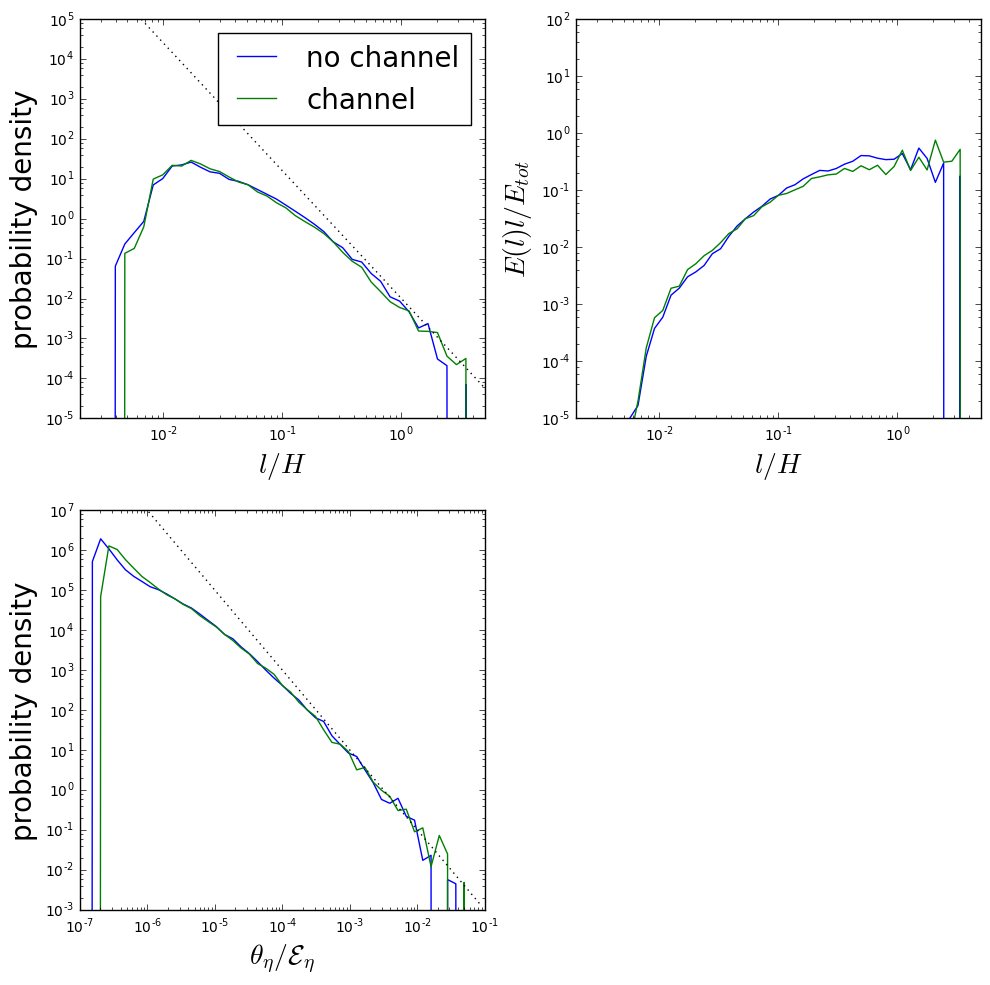

In [301]:
%matplotlib inline

targlist=['x2y4z1r64pm1re4000','x2y4z1r128pm1re4000','x2y4z1r256pm1re4000',\
           'x2y4z1r256pm1re8000','x2y4z1r512pm1re8000',\
           'x2y4z1r512pm1re16000']# 'x2y4z1r512pm1re4000'

direname='/tigress/jiming/reconnect/athena/bin/'
basename='/jprop.'

first_time=True
ntarg=2
count = 0
targ = 'x2y4z1r512pm1re16000'
nochlist = [36,40,48,50]#[30,31,32,36,40,48,49,50]
chlist = [34,38,45,46]
#for i in [35,40,41,44,45,46]:
for i in nochlist+chlist:
    print i
    fname = direname+targ+'/'+basename+str(i).zfill(5)+'.p'
    ncells,jmax,diss,size,orient = pickle.load(open(fname,"rb"))
    dissnormed,theta,jmaxnorm = get_normtheta(targ,i,i+1,1,eta=6.25e-5)
    ngridpts = 1024*512*1008
    theta /=float(ngridpts)
    # compute pdf of size[0]
    vmin1,vmax1,nbin=-3,0.9,50
    hdata = np.array(size)[:,0]
    hist1, bins1 = np.histogram(hdata, bins=np.logspace(vmin1,vmax1,nbin),density=1)
    # compute pdf of theta
    vmin2,vmax2,nbin=-7,-1,50
    hdata = theta
    hist2, bins2 = np.histogram(hdata, bins=np.logspace(vmin2,vmax2,nbin),density=1)
    # compute Exx
    vmin1,vmax1,nbin=-2.7,0.7,50
    hdata = np.array(size)[:,0]
    hist3, bins3 = np.histogram(hdata, bins=np.logspace(vmin1,vmax1,nbin),density=1,weights=theta)
    if first_time:
        center1 = 10**((np.log10(bins1[:-1])+np.log10(bins1[1:]))/2)
        hist_lamb = np.zeros([len(center1),ntarg])
        center2 = 10**((np.log10(bins2[:-1])+np.log10(bins2[1:]))/2)
        hist_theta = np.zeros([len(center2),ntarg])
        center3 = 10**((np.log10(bins3[:-1])+np.log10(bins3[1:]))/2)
        hist_exx = np.zeros([len(center3),ntarg])
        first_time = False
    if count < 4:
      hist_lamb[:,0] += hist1[:]
      hist_theta[:,0] += hist2[:]
      hist_exx[:,0] += hist3[:]
    else:
      hist_lamb[:,1] += hist1[:]
      hist_theta[:,1] += hist2[:]
      hist_exx[:,1] += hist3[:]
    count +=1
    
matplotlib.rcParams['figure.figsize'] = (10,10)    
plt.subplot(2,2,1)
label=['no channel','channel']
for i in np.arange(ntarg):
  if i==0:
    navg = 4.0
  else:
    navg = 4.0
  plt.plot(center1,hist_lamb[:,i]/navg,label=label[i])

plt.xlabel(r'$l/H$',size=20)
plt.ylabel('probability density',size=20)
plt.xlim([10**vmin1,10**vmax1])
plt.ylim([10**(-5),10**5])
plt.xscale("log")
plt.yscale("log")
index,coef=-3.2,1e-2
plt.plot(center1,coef*center1**index,'k:')
plt.legend(fontsize=20,loc=1)

plt.subplot(2,2,2)
for i in np.arange(ntarg):
  if i==0:
    navg = 4.0
  else:
    navg = 4.0
  plt.plot(center3,hist_exx[:,i]/navg*center3,label=label[i])

plt.xlabel(r'$l/H$',size=20)
plt.ylabel('$E(l)l/E_{tot}$',size=20)
plt.xlim([10**vmin1,10**vmax1])
plt.ylim([10**(-5),10**2])
plt.xscale("log")
plt.yscale("log")
#index,coef=-3.2,1e-2
#plt.plot(center1,coef*center1**index,'k:')

plt.subplot(2,2,3)
for i in np.arange(ntarg):
  if i==0:
    navg = 4.0
  else:
    navg = 4.0
  plt.plot(center2,hist_theta[:,i]/navg,label=targlist[i])

plt.xlabel(r'$\theta_{\eta}/\mathcal{E}_{\eta}$',size=20)
plt.ylabel('probability density',size=20)
plt.xlim([10**vmin2,10**vmax2])
plt.ylim([10**(-3),10**(7)])
index,coef=-2.0,1e-5
plt.plot(center2,coef*center2**index,'k:')
plt.xscale("log")
plt.yscale("log")


plt.tight_layout()


plt.savefig('pdf_chanel.png', format='png', dpi=300)

# 4 vortex sheet analysis

## 4.1 statistics similar to sec 3
## 4.2 compressible flow
$\rho\partial_t e + \rho (\vec{v}\cdot\nabla)e = -p\nabla\cdot \vec{v} + \Phi$


where dissipation function 

$\Phi = 2\rho\nu E_{ij} E^{ij} -\frac{2}{3}\rho \nu (\nabla\cdot \vec{v})^2$, and 

$E_{ij} \equiv \frac{1}{2}(\partial_i v_j + \partial_j v_i)$ is the rate of strain

Using equality $2E_{ij}E^{ij} = \omega^2 + 2(\nabla\vec{v}):(\nabla\vec{v})$, we have dissipation

$\Phi = \mu\omega^2 + 2\mu[(\nabla\vec{v}):(\nabla\vec{v})-\frac{1}{3}(\nabla\cdot \vec{v})^2]$, where $\mu=\rho\nu$

After write it out,

$\Phi = \mu\left\{\omega^2 + 2[(\partial_x v_x)^2+(\partial_y v_y)^2+(\partial_z v_z)^2
+2(\partial_x v_y)(\partial_y v_x)+2(\partial_z v_y)(\partial_y v_z) + 2(\partial_x v_z)(\partial_z v_x)] -\frac{2}{3}(\nabla\cdot \vec{v})^2\right\}$

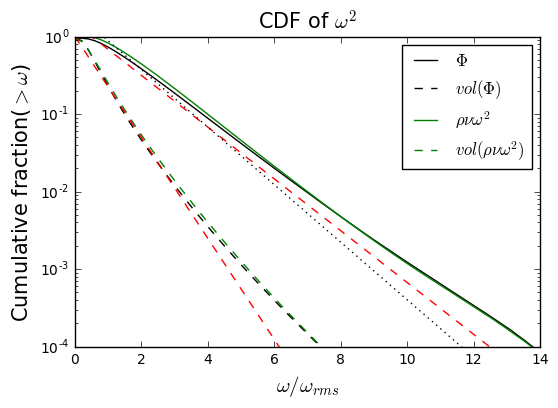

In [26]:
%matplotlib inline

targlist=['x2y4z1r64pm1re4000','x2y4z1r128pm1re4000','x2y4z1r256pm1re4000',\
           'x2y4z1r256pm1re8000','x2y4z1r512pm1re8000',\
           'x2y4z1r512pm1re16000']# 'x2y4z1r512pm1re4000'

direname='/tigress/jiming/reconnect/athena/bin/'
basename='/Unstra.out2.'
## draw vorticity sheet cdf
appdname='.athdf.vcdf2.tab'

count = 0
for targ in targlist[-1:]:
  ts,te,tstride = 30,50,1
  label = targ[6:]
  if targ == 'x2y4z1r64pm1re4000':
    ts,te,tstride = 50,100,1
  if targ == 'x2y4z1r128pm1re4000':
    ts,te,tstride = 50,100,1
  if targ == 'x2y4z1r256pm1re8000':
    ts,te,tstride = 50,100,1
  if targ == 'x2y4z1r512pm1re8000':
    ts,te,tstride = 30,48,1
  if targ == 'x2y4z1r512pm1re4000':
    ts,te,tstride = 10,19,1
  #print targ,ts,te,tstride
  nbin = 100; nt = te-ts+1
  jth2 = np.zeros(nbin)
  cdfj2 = np.zeros(nbin)
  cdfvol = np.zeros(nbin)
  cdfj2w2 = np.zeros(nbin)
  cdfvolw2 = np.zeros(nbin)
  for i in np.arange(ts,te,tstride):
    fname = direname+targ+'/'+basename+str(i).zfill(5)+appdname
    dtype1 = np.dtype([('jth2', 'f8'), ('cdfj2', 'f8'),('cdfj2w2','f8'),('cdfvol','f8'),('cdfvolw2','f8')])
    ahist = np.loadtxt(fname, dtype=dtype1, usecols=(0,1,2,3,4))
    cdfj2 += ahist['cdfj2']
    cdfvol += ahist['cdfvol']
    cdfj2w2 += ahist['cdfj2w2']
    cdfvolw2 += ahist['cdfvolw2']

  jth = (ahist['jth2'])**0.5
  cdfj2 /= float(nt)
  cdfvol /= float(nt)
  cdfj2w2 /= float(nt)
  cdfvolw2 /= float(nt)
  plt.plot(jth,cdfj2,'k-', label=r'$\Phi$')
  plt.plot(jth,cdfvol,'k--',label=r'$vol(\Phi)$')
  plt.plot(jth,cdfj2w2,'g-',label=r'$\rho\nu\omega^2$')
  plt.plot(jth,cdfvolw2,'g--',label=r'$vol(\rho\nu\omega^2)$')
  count +=1
    
plt.yscale('log')
plt.xlim([0,14])
plt.ylim([1e-4,1])
plt.plot(jth,np.exp(-(jth-0.5)/1.3),'r--')
plt.plot(jth,np.exp(-(jth*1.5)),'r--')
plt.plot(jth,np.exp(-(jth-0.85)/1.17),'k:')
plt.title('CDF of $\omega^2$',fontsize=15)
plt.xlabel(r'$\omega/\omega_{rms}$',fontsize=15)
plt.ylabel('Cumulative fraction'+r'($>\omega$)',fontsize=15)
plt.legend(loc=1,fontsize=12)


time =  0.0
<epsilon_{nu,sh}>/<epsilon_{nu}> =  12.2215319113
non-weighted averaged (l,xi,lambda) = ( 0.0699468116279  , 0.0269567359846  , 0.00811772996169 )
vol-weighted averaged (l,xi,lambda) = ( 1.09348550909  , 0.372286437333  , 0.196346873681 )
dis-weighted averaged (l,xi,lambda) = ( 1.27631551301  , 0.422061225682  , 0.217757516549 )
average theta/E_nu =  2.70648943243e-05
average w_max/w_rms =  3.34667732006
average epsilon =  8.27141278619
average volume fraction per sheet =  2.26888530692e-06
dis-weighted average volume fraction per sheet =  0.000544075241316
average volume fraction for all sheets =  0.020770348479
time averaged number of current sheets =  9154.42857143


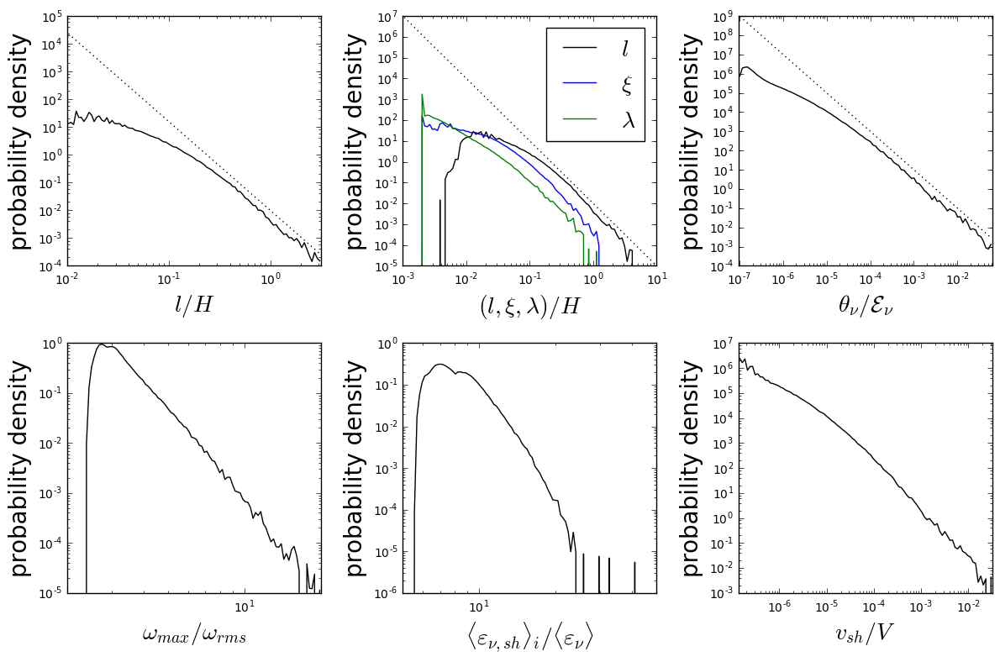

In [80]:
import cPickle as pickle
import athena_read as ath
import csheet3d 
from csheet3d import plot_jhist
from csheet3d import plot_jcorr
from csheet3d import get_normtheta


fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00000.athdf'
#fname=fdir+'x2y4z1r256ideal/Unstra.out2.00000.athdf'
t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
dx=data['x1f'][1]-data['x1f'][0]
dy=data['x2f'][1]-data['x2f'][0]
dz=data['x3f'][1]-data['x3f'][0]
dv = dx*dy*dz
ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))
fname = fdir+'x2y4z1r512pm1re16000/vprop2_ts=30_te=51.p'
#fname = fdir+'x2y4z1r256ideal/vprop2_ts=30_te=51.p'


matplotlib.rcParams['figure.figsize'] = (12, 10)

ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
#dissnorm,theta,jmaxnorm = get_normtheta('x2y4z1r256ideal',30,51,1,eta=1.25e-4,vsheet=True,wth=2)
dissnorm,theta,jmaxnorm = get_normtheta('x2y4z1r512pm1re16000',30,51,1,eta=6.25e-5,vsheet=True,wth=2)
theta /=float(ngridpts)
plot_jhist(dv,ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,21,vsheet=True)
#plt.savefig('pdf_re16000.png', format='png', dpi=300)

non-weighted averaged (\hat{l}) = ( 0.597507922176  , -0.401283092495  , 0.694230626388 )
vol-weighted averaged (\hat{l}) = ( -0.0983405731589  , 0.651977806324  , 0.751833805925 )
dis-weighted averaged (\hat{l}) = ( -0.422391066384  , -0.486407799178  , 0.764848507836 )
non-weighted averaged (\hat{xi}) = ( 0.989843297183  , 0.14121049685  , -0.0164268865605 )
vol-weighted averaged (\hat{xi}) = ( 0.981511140749  , 0.189515645061  , -0.0268272410747 )
dis-weighted averaged (\hat{xi}) = ( 0.978400032283  , 0.197007372689  , -0.062621657074 )
non-weighted averaged (\hat{\lambda}) = ( 0.343983006649  , 0.00384085421558  , 0.938968018079 )
vol-weighted averaged (\hat{\lambda}) = ( 0.0430900956452  , -0.506779135615  , 0.860998345737 )
dis-weighted averaged (\hat{\lambda}) = ( 0.0856861785709  , -0.136387136226  , 0.986942970933 )


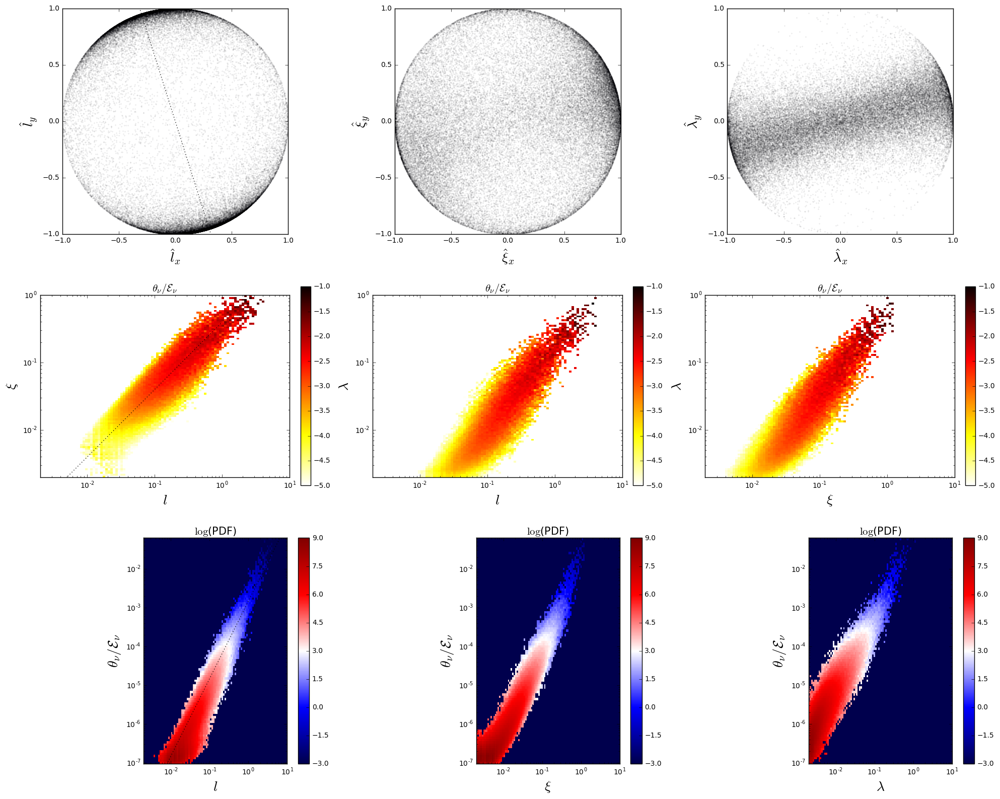

In [78]:
from csheet3d import plot_jcorr
plot_jcorr(ncells,jmax,jmaxnorm,diss,dissnorm,size,orient,theta,disscut=5e-6,ntime=21,cmap='hot_r',vsheet=True)

time =  0.0
<epsilon_{nu,sh}>/<epsilon_{nu}> =  10.853676759
<epsilon_{nu,sh}>/<epsilon_{nu}> =  10.853676759
<epsilon_{nu,sh}>/<epsilon_{nu}> =  12.2215319113


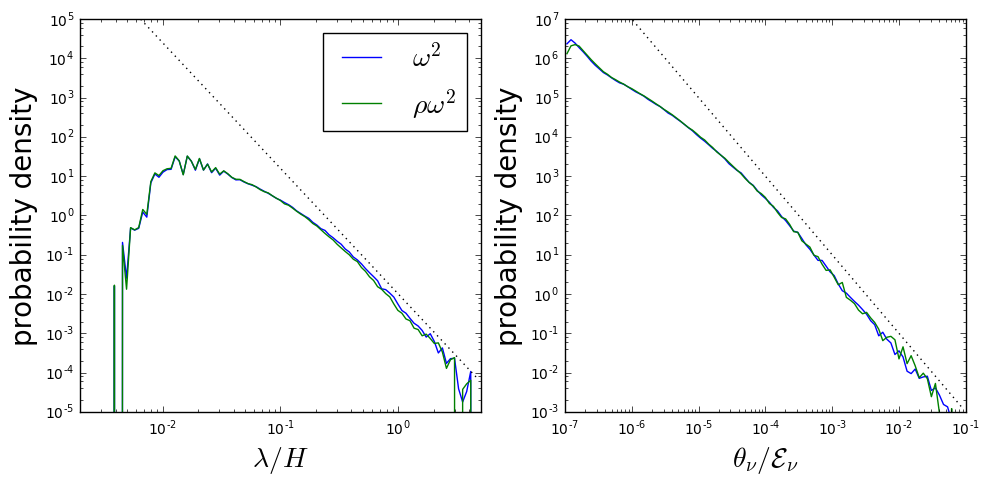

In [53]:
import cPickle as pickle
import athena_read as ath
import csheet3d 
from csheet3d import plot_jhist
from csheet3d import plot_jcorr
from csheet3d import get_normtheta

targ = 'x2y4z1r512pm1re16000/'
fdir = '/tigress/jiming/reconnect/athena/bin/'
ntarg = 2
count = 0
first_time = True
for i in np.arange(ntarg):
    # prepare theta
    if first_time:
      fname=fdir+targ+'/Unstra.out2.00000.athdf'
      t,data = ath.athdf(fname,quantities=['x1f','x2f','x3f'])
      dx=data['x1f'][1]-data['x1f'][0]
      dy=data['x2f'][1]-data['x2f'][0]
      dz=data['x3f'][1]-data['x3f'][0]
      dv = dx*dy*dz
      ngridpts = (len(data['x1f'])-1)*(len(data['x2f']-1))*(len(data['x3f']-1))
      eta = 6.25e-5
      ts,te = 30,51
    fname = fdir+targ+'vprop_ts=30_te=51.p'
    if i ==1:
      fname = fdir+targ+'vprop2_ts=30_te=51.p' 
    ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
    dissnorm,theta,jmaxnorm = get_normtheta(targ,ts,te,1,eta=eta,vsheet=True,wth=1)
    if i==1:
      dissnorm,theta,jmaxnorm = get_normtheta(targ,ts,te,1,eta=eta,vsheet=True,wth=2)
    theta /=float(ngridpts)
    # compute pdf of size[0]
    vmin1,vmax1,nbin=-2.7,0.7,100
    hdata = np.array(size)[:,0]
    hist1, bins1 = np.histogram(hdata, bins=np.logspace(vmin1,vmax1,nbin),density=1)
    # compute pdf of theta
    vmin2,vmax2,nbin=-7,-1,100
    hdata = theta
    hist2, bins2 = np.histogram(hdata, bins=np.logspace(vmin2,vmax2,nbin),density=1)
    if first_time:
        center1 = 10**((np.log10(bins1[:-1])+np.log10(bins1[1:]))/2)
        hist_lamb = np.zeros([len(center1),ntarg])
        center2 = 10**((np.log10(bins2[:-1])+np.log10(bins2[1:]))/2)
        hist_theta = np.zeros([len(center2),ntarg])
        first_time = False
    hist_lamb[:,count] = hist1[:]
    hist_theta[:,count]= hist2[:]
    count +=1

    
#linewidth = [0.75,1.5,3,3,4.5,4.5]  #width for various resolution
#linestyle = [':',':',':','--',':','--','-'] # linestyle to show various Re
#ctable = ['b','g','b','g','g','k']

matplotlib.rcParams['figure.figsize'] = (10,5)    
plt.subplot(1,2,1)
for i in np.arange(count):
  plt.plot(center1,hist_lamb[:,i],label=label[i])

plt.xlabel(r'$\lambda/H$',size=20)
plt.ylabel('probability density',size=20)
plt.xlim([10**vmin1,10**vmax1])
plt.ylim([10**(-5),10**5])
plt.xscale("log")
plt.yscale("log")
index,coef=-3.2,1e-2
plt.plot(center1,coef*center1**index,'k:')
plt.legend(fontsize=20,loc=1)

label=[r'$\omega^2$',r'$\rho\omega^2$']  
plt.subplot(1,2,2)
for i in np.arange(count):
  plt.plot(center2,hist_theta[:,i])

plt.xlabel(r'$\theta_{\nu}/\mathcal{E}_{\nu}$',fontsize=20)
plt.ylabel('probability density',fontsize=20)
plt.xlim([10**vmin2,10**vmax2])
plt.ylim([10**(-3),10**(7)])
index,coef=-2.0,1e-5
plt.plot(center2,coef*center2**index,'k:')
plt.xscale("log")
plt.yscale("log")


plt.tight_layout()

plt.savefig('pdf_vsheet_channel.png', format='png', dpi=300)

# 4 current sheet stability

## 4.1 1d profile
three linecuts( two across current sheets, one across mag island):
[0.443,0,-0.329]-[0.552,0,0.552]; [0.597,-0.15,-0.164]-[0.673,-0.15,-0.499]
[0.562,0,-0.204]-[0.663,0,-0.429]

sheet normal :[-0.68,-0.2,0.705], center: [0.526,0.003,-0.397]

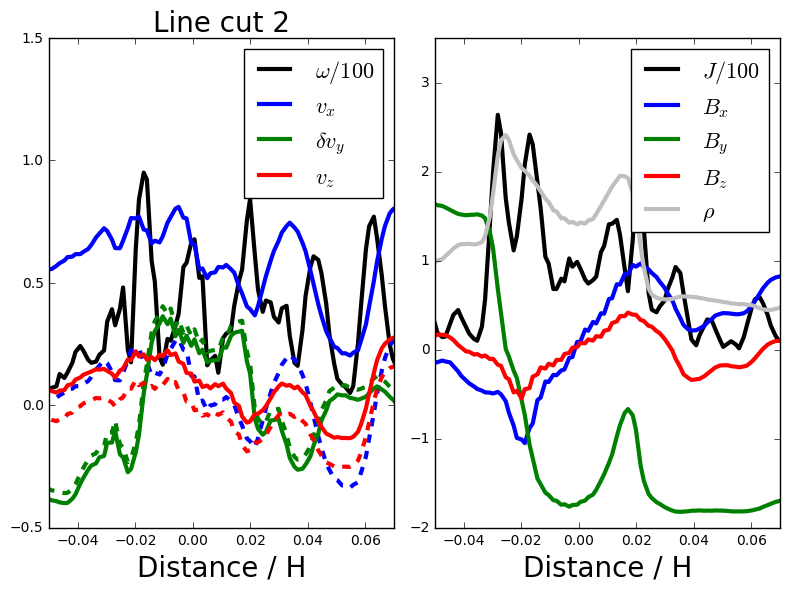

In [118]:
import  numpy as np

def plot_prof1d(fname,xcenter=0.1212,norm=1,remove_mean=False,
                xlim=[-0.05,0.05],ylim1=[-0.6,0.8],ylim2=[-3,3],
               title='Line cut 3'):
#fdir = '/tigress/jiming/reconnect/athena/bin/t45box001'
#fname = fdir+'/prof_y=0.tab'
    dtype = np.dtype([('x', 'f8'), ('val', 'f8')])
    ahist = np.loadtxt(fname, dtype=dtype, usecols=(0,1))
    # variables in order: rho,w,vx,dvy,vz,j,bx,by,bz
    nvar = 9 
    nx = len(ahist)/nvar
    x= ahist['x'][0:nx]
    x -=xcenter
    label=[r'$\rho$',r'$\omega/300$',r'$v_x$',r'$\delta v_y$',r'$v_z$',\
                     r'$J/300$',r'$B_x$',r'$B_y$',r'$B_z$']
    if norm ==3:
         label=[r'$\rho$',r'$\omega/100$',r'$v_x$',r'$\delta v_y$',r'$v_z$',\
                     r'$J/100$',r'$B_x$',r'$B_y$',r'$B_z$']
    clist=['0.75','k','b','g','r','k','b','g','r']
    lw = np.repeat(3,9)

    matplotlib.rcParams['figure.figsize'] = (8,6)    

    prof = np.zeros([nx,nvar])
    prof_1 = np.zeros([nx,3])
    for n in range(nvar):
      istart=nx*n
      iend=istart+nx
      prof[:,n]=ahist['val'][istart:iend]
      #prof[:,n]=savitzky_golay(prof[:,n], 5, 3) # window size 51, polynomial order 3
      #remove the mean of velocity profiles
      if n >1 and n < 5 and remove_mean:
        tmp = np.average(prof[:,n])
        prof_1[:,n-2] = prof[:,n]-tmp
        
    for n in range(nvar):
      if n==1:
        ax1=plt.subplot(1,2,1)
        ylim=ylim1 #[-0.6,0.8]
      if n==5:
        ax2=plt.subplot(1,2,2)
        ylim=ylim2 #[-3,3]
      if n==1 or n==5: # only if across the plasmoid
        plt.plot(x,norm*prof[:,n],color=clist[n],lw=lw[n],label=label[n])
      else:
        plt.plot(x,prof[:,n],color=clist[n],lw=lw[n],label=label[n])
        if n >1 and n < 5 and remove_mean:
          plt.plot(x,prof_1[:,n-2],clist[n]+'--',lw=lw[0])  

      if n==4 or n==8:
        plt.xlim(xlim) #([-0.05,0.05])
        plt.ylim(ylim)
        if n==8: 
          plt.plot(x,prof[:,0],color=clist[0],lw=lw[0],label=label[0])              
          plt.xlabel('Distance / H',fontsize=20)
          loc = 1
        if n==4:
           plt.title(title,fontsize=20)
           plt.xlabel('Distance / H',fontsize=20)
           loc = 1
        #ax1.tick_params(labelbottom='off')
        plt.legend(fontsize=16,loc=loc)
        plt.tight_layout()
        
fdir = '/tigress/jiming/reconnect/athena/bin/t45box001'
# ##  1) plasmoid cut
# fname = fdir+'/prof_plasmoid.tab'
# plot_prof1d(fname,xcenter=0.12,norm=3,remove_mean=True,xlim=[-0.05,0.05],ylim1=[-0.8,1.2], ylim2=[-2.2,3.2],
#            title='Line cut 2')
# plt.savefig('lineout2.png', format='png', dpi=300)

# #  2) current sheet cut y=0 
# fname = fdir+'/prof_y=0.tab'

# plot_prof1d(fname,xcenter=0.1212,norm=1,xlim=[-0.03,0.03],ylim1=[-0.6,1.2], ylim2=[-2,3.2],
#            title='Line cut 1')
# plt.savefig('lineout1.png', format='png', dpi=300)

###  3) current sheet cut y=-0.15
# fname = fdir+'/prof_y=-15.tab'

# plot_prof1d(fname,xcenter=0.1708,norm=1,xlim=[-0.03,0.03],ylim1=[-0.6,1.2], ylim2=[-2,3.2],
#            title='Line cut 3')
# plt.savefig('lineout3.png', format='png', dpi=300)
# #plot_prof1d(fname,xcenter=0.1708)
fname = fdir+'/prof_plasmoid_y=5.tab'
plot_prof1d(fname,xcenter=0.12,norm=3,remove_mean=True,xlim=[-0.05,0.07],\
            ylim1=[-0.5,1.5], ylim2=[-2,3.5],
           title='Line cut 2')
plt.savefig('lineout4.png', format='png', dpi=300)
#plot_prof1d(fname,xcenter=0.1708)

## K-H stability
using VisIt slice+lineout 

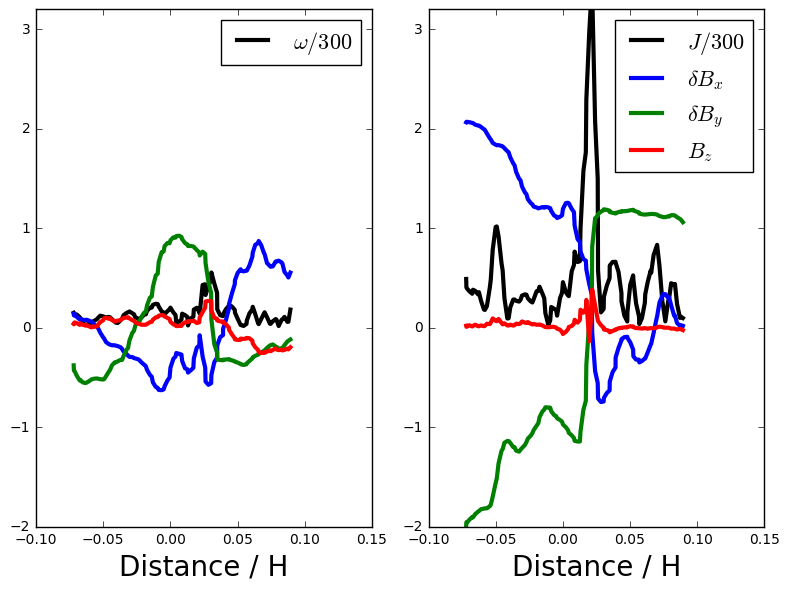

In [35]:
import  numpy as np

matplotlib.rcParams['figure.figsize'] = (8,6) 

def plot_prof(fname,xcenter=0.1212,norm=1,gradient=False,remove_mean=False,bfield=False,Wmag=False, 
                xlim=[-0.05,0.05],ylim1=[-0.6,0.8],ylim2=[-3,3],
               title='Line cut 3'):
#fdir = '/tigress/jiming/reconnect/athena/bin/t45box001'
#fname = fdir+'/prof_y=0.tab'
    dtype = np.dtype([('x', 'f8'), ('val', 'f8')])
    ahist = np.loadtxt(fname, dtype=dtype, usecols=(0,1))
    # variables in order: rho,w,vx,dvy,vz,j,bx,by,bz
    nvar = 9
    nx = len(ahist)/9
    x= ahist['x'][0:nx]
    x -=xcenter
    label=[r'$\rho$',r'$\omega/300$',r'$v_x$',r'$\delta v_y$',r'$v_z$',\
                     r'$J/300$',r'$\delta B_x$',r'$\delta B_y$',r'$B_z$']
    if norm ==3:
         label=[r'$\rho$',r'$\omega/100$',r'$v_x$',r'$\delta v_y$',r'$v_z$',\
                     r'$J/100$',r'$\delta B_x$',r'$\delta B_y$',r'$B_z$']
    clist=['0.75','k','b','g','r','k','b','g','r']
    lw = np.repeat(3,9)

    

    prof = np.zeros([nx,nvar])
    prof_1 = np.zeros([nx,3])
    for n in range(nvar):
      istart=nx*n
      iend=istart+nx
      prof[:,n]=ahist['val'][istart:iend]
      #prof[:,n]=savitzky_golay(prof[:,n], 5, 3) # window size 51, polynomial order 3
      #remove the mean of velocity profiles
      if n >1 and n < 5 and remove_mean:
        tmp = np.average(prof[:,n])
        prof_1[:,n-2] = prof[:,n]-tmp
      if n==1 and Wmag:
        prof[:,n] /=300.
      if n==7:  #remove mean field in By direct
        prof[:,n] -=0.85
      if n==8 and gradient: # replace Bz with dBxy/dz
        theta = np.arctan2(prof[:,7],prof[:,6])
        bxy = prof[:,6]*np.cos(theta)+prof[:,7]*np.sin(theta)
        #print theta
        #print bxy
        prof[:,n] = np.gradient(bxy)*np.sign(theta)
    
    
    
    if bfield:
        nlist = list(np.arange(5,9))+[0]
    else:
        nlist = list(np.arange(0,5))
        
    for n in nlist:
      
      ylim=ylim1 #[-0.6,0.8]
      
      if n==1 or n==5: # only if across the plasmoid
        plt.plot(x,norm*prof[:,n],color=clist[n],lw=lw[n],label=label[n])
      elif n>5:
        plt.plot(x,prof[:,n],clist[n],lw=lw[n],label=label[n])
      else:
        #plt.plot(x,prof[:,n],color=clist[n],lw=lw[n],label=label[n])
        if n >1 and n < 5 and remove_mean:
          plt.plot(x,prof_1[:,n-2],clist[n]+'-',lw=lw[0])  

      #if n==nvar-1:
    plt.xlim(xlim) #([-0.05,0.05])
    plt.ylim(ylim)           
    plt.xlabel('Distance / H',fontsize=20)
        #ax1.tick_params(labelbottom='off')
    plt.legend(fontsize=16,loc=1)
    plt.tight_layout()
        
fdir = '/tigress/jiming/reconnect/athena/bin/t45box002'
# ##  1) plasmoid cut
# fname = fdir+'/prof_plasmoid.tab'
# plot_prof1d(fname,xcenter=0.12,norm=3,remove_mean=True,xlim=[-0.05,0.05],ylim1=[-0.8,1.2], ylim2=[-2.2,3.2],
#            title='Line cut 2')
# plt.savefig('lineout2.png', format='png', dpi=300)

# #  2) current sheet cut y=0 
# fname = fdir+'/prof_y=0.tab'


plt.subplot(1,2,1)
fname = fdir+'/lineout'+str(1).zfill(3)+'.tab'
plot_prof(fname,xcenter=0.072,norm=1,bfield=False,Wmag=True,remove_mean=True,xlim=[-0.1,0.15],ylim1=[-2,3.2], ylim2=[-2,3.2],
      title=' ')

plt.subplot(1,2,2)
plot_prof(fname,xcenter=0.072,norm=1,bfield=True,gradient=True,Wmag=True,xlim=[-0.1,0.15],ylim1=[-2,3.2], ylim2=[-2,3.2],
      title=' ')



plt.savefig('kh_prof_b.png', format='png', dpi=300)

###  3) current sheet cut y=-0.15
# fname = fdir+'/prof_y=-15.tab'

# plot_prof1d(fname,xcenter=0.1708,norm=1,xlim=[-0.03,0.03],ylim1=[-0.6,1.2], ylim2=[-2,3.2],
#            title='Line cut 3')
# plt.savefig('lineout3.png', format='png', dpi=300)
# #plot_prof1d(fname,xcenter=0.1708)

#plot_prof1d(fname,xcenter=0.12,norm=3,remove_mean=True,xlim=[-0.05,0.07],\
#            ylim1=[-0.5,1.5], ylim2=[-2,3.5],
#           title='Line cut 2')
#plt.savefig('lineout4.png', format='png', dpi=300)
#plot_prof1d(fname,xcenter=0.1708)

B 7 = 0.465711830086


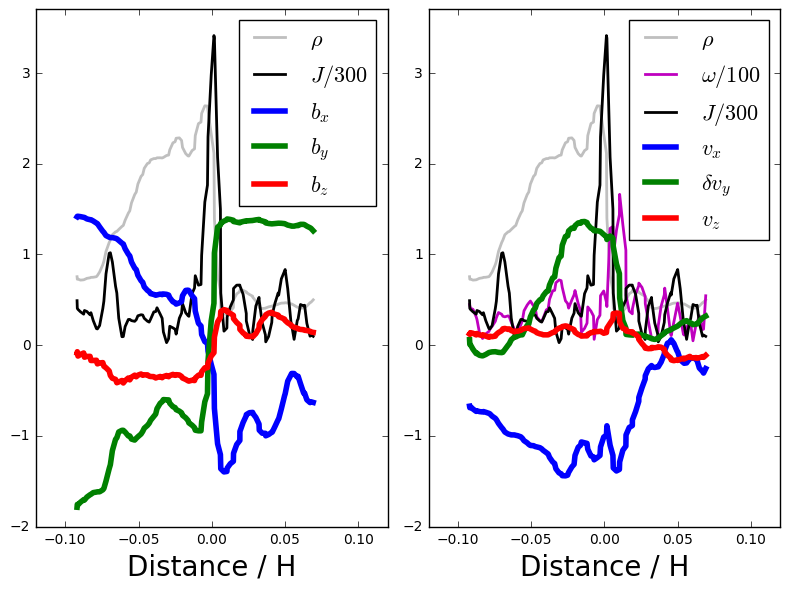

In [216]:
import  numpy as np

matplotlib.rcParams['figure.figsize'] = (8,6)
fdir = '/tigress/jiming/reconnect/athena/bin/t45box002'
fname = fdir+'/lineout'+str(1).zfill(3)+'.tab'
fname = fdir+'/lineout'+str(1).zfill(3)+'.tab'
xcenter=0.092
norm=1
xlim=[-0.12,0.12]
ylim=[-2,3.7]
#ylim2=[-2,3.2]
remove_mean = True
gradient= False

# load the linecut data
dtype = np.dtype([('x', 'f8'), ('val', 'f8')])
ahist = np.loadtxt(fname, dtype=dtype, usecols=(0,1))
# variables in order: rho,w,vx,dvy,vz,j,bx,by,bz
nvar = 9
nx = len(ahist)/9
x= ahist['x'][0:nx]
x -=xcenter

label=[r'$\rho$',r'$\omega/100$',r'$v_x$',r'$\delta v_y$',r'$v_z$',\
                 r'$J/300$',r'$b_x$',r'$ b_y$',r'$b_z$']
if norm ==3:
     label=[r'$\rho$',r'$\omega/100$',r'$v_x$',r'$\delta v_y$',r'$v_z$',\
                 r'$J/100$',r'$B_x$',r'$\delta B_y$',r'$B_z$']
clist=['0.75','m','b','g','r','k','b','g','r']
lw = np.repeat(4,9)

# allocate profile data array
prof = np.zeros([nx,nvar])
# derived array
prof_1 = np.zeros([nx,3])
# load the data into profile arrays
for n in range(nvar):
  istart=nx*n
  iend=istart+nx
  prof[:,n]=ahist['val'][istart:iend]
  #prof[:,n]=savitzky_golay(prof[:,n], 5, 3) # window size 51, polynomial order 3
  #remove the mean of velocity profiles
  if n == 2 and remove_mean:
    #tmp = np.average(prof[:,n])
    #print 'v',n,'=',tmp
    prof[:,n] += 0.0 #0.5
  if n == 3 and remove_mean:
    #tmp = np.average(prof[:,n])
    #print 'v',n,'=',tmp
    prof[:,n] -= 0.0 #0.5
  if n==1:
    prof[:,n] /=100.
  if n==7 and remove_mean:
    tmp = np.average(prof[nx/3:-nx/3,n])
    print 'B',n,'=',tmp
    prof[:,n] -= 0.65 #(tmp)
  if n==6 and remove_mean:
    prof[:,n] -= 0.65 #0.4
  if n==8 and gradient: # replace Bz with dBxy/dz
    theta = np.arctan2(prof[:,7],prof[:,6])
    bxy = prof[:,6]*np.cos(theta)+prof[:,7]*np.sin(theta)
    #print theta
    #print bxy
    #prof[:,n] = np.gradient(bxy)*np.sign(theta)

    


plt.subplot(1,2,1)
for n in [0,5,6,7,8]:
  if n==0 or n==5:
    lw[n] = 2
  plt.plot(x,prof[:,n],color=clist[n],lw=lw[n],label=label[n])
# plot the gradient
#theta = np.arctan2(prof[:,7],prof[:,6])
#bxy =    np.sqrt(prof[:,6]**2+prof[:,7]**2)*np.sign(theta)

#plt.plot(x,np.gradient(bxy,x)/bxy*1e-3,'c-')
#plt.plot(x,np.gradient(bxy,x)/bxy*1e-3,'co')

plt.xlim(xlim) #([-0.05,0.05])
plt.ylim(ylim)           
plt.xlabel('Distance / H',fontsize=20)
    #ax1.tick_params(labelbottom='off')
plt.legend(fontsize=16,loc=1)


plt.subplot(1,2,2)
for n in [0,1,5,2,3,4]:
  if n == 1 or n==0 or n==5:
    lw[1]= 2
  plt.plot(x,prof[:,n],color=clist[n],lw=lw[n],label=label[n])

plt.xlim(xlim) #([-0.05,0.05])
plt.ylim(ylim)           
plt.xlabel('Distance / H',fontsize=20)
    #ax1.tick_params(labelbottom='off')
plt.legend(fontsize=16,loc=1)

plt.tight_layout()


plt.savefig('kh_prof_b.png', format='png', dpi=300)

tr^3/5 ta^2/5= 8.36511642073


(-3, 3)

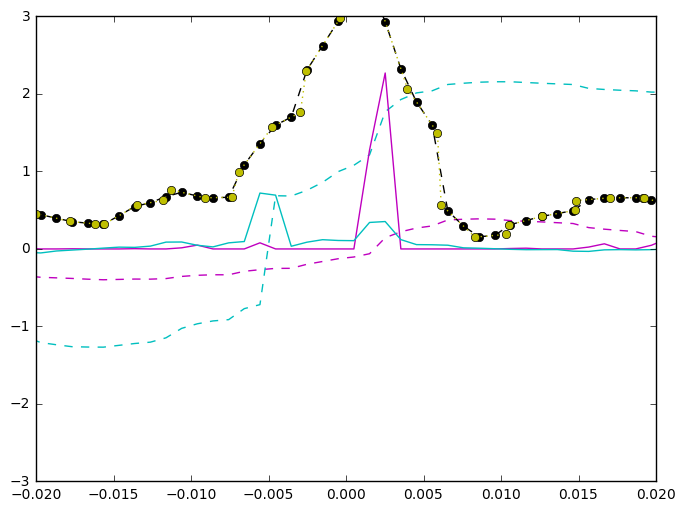

In [203]:
## calculate the growth rate of tearing instability
########################################################
prefactor = 0.548  # [gamma(1/4)/gamma(3/4)/2pi]^4/5
xi = 0.1 # sheet size = width
b0y = 1.0
eta = 1./16000.

# interpolate into higher density grid
xfine = np.linspace(-0.05,0.05,100)
dx = xfine[1]-xfine[0]
jmag = np.interp(xfine,x,prof[:,5])
b_perp = np.interp(xfine,x,prof[:,8])
bx = np.interp(xfine,x,prof[:,6])
by = np.interp(xfine,x,prof[:,7])
theta = np.arctan2(by,bx)
b_para = np.sqrt(bx**2+by**2)*np.sign(theta)


# (1) delta^prime:  the perpendicular component across the sheet 
#delta = np.gradient(b_perp)/dx/b_perp
delta = np.gradient(b_perp,dx)/b_perp
d_delta = np.roll(delta,-1)-np.roll(delta,1)
d_delta[d_delta<0.0] = 0.0

# (2) gradient of the parallel component across the sheet
d_bpara = np.gradient(b_para,dx)

# (3) time scale tau_r^3/5 tau_A^2/5
t_diff = xi**2/eta
t_alf  = xi /np.sqrt(b0y)

print 'tr^3/5 ta^2/5=',t_diff**0.6*t_alf**0.4

tscale = 1.0/t_diff**0.6/t_alf**0.4

plt.plot(xfine,b_perp,'m--')
plt.plot(xfine,b_para,'c--')
#plt.plot(xfine,b_perp)


plt.plot(xfine,d_delta*0.001,'m-')
plt.plot(xfine,d_bpara*0.001,'c-')
plt.plot(xfine,jmag,'k--o')
plt.plot(x,prof[:,5],'y:o')
plt.xlim([-0.02,0.02])
plt.ylim([-3,3])













(-10, 10)

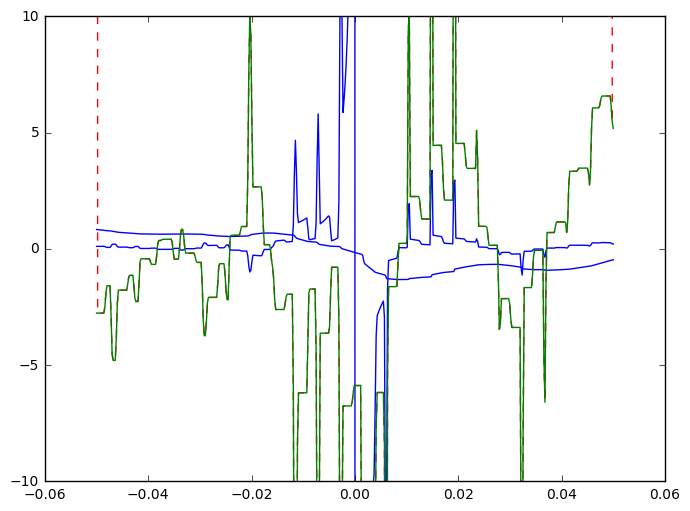

In [113]:
plt.plot(xfine,bx)
plt.plot(xfine,(np.roll(bx,-1)-np.roll(bx,1))/20./dx,'r--')
plt.plot(xfine,np.gradient(bx,xfine),'b-')
plt.plot(xfine,np.gradient(bx,dx)*0.1,'g-')
plt.ylim([-10,10])

## flow map of individual current sheet in the subvolume
* data drew from rst_t40, evolution time is 0.3pi Omega^-1  about one dynamical time

let first track just the largest sheet at beginning.

(100.0, 100000.0)

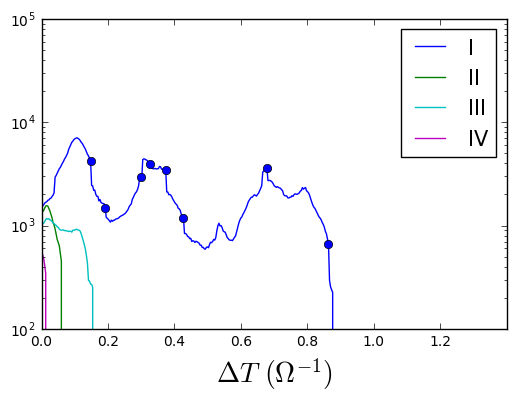

In [23]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline
targ = 'rst_t20'
fname = '/tigress/jiming/reconnect/athena/bin/'+targ+'/box.000.r0.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)

label ='I'
plt.plot(track['time']*np.pi/1000.,track['size'],'b-',label=label)
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'bo')
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'bo')
    
   
fname = '/tigress/jiming/reconnect/athena/bin/'+targ+'/box.000.r1.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)
label = 'II'
plt.plot(track['time']*np.pi/1000.,track['size'],'g-',label=label)
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'o',markersize=8,markeredgewidth=1,markeredgecolor='g',markerfacecolor='None')
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'o',markersize=12,markeredgewidth=1,markeredgecolor='g',
markerfacecolor='None')
    
fname = '/tigress/jiming/reconnect/athena/bin/'+targ+'/box.000.r2.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)
label='III'
plt.plot(track['time']*np.pi/1000.,track['size'],'c-',label=label)
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'co')#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'o',markeredgewidth=1,markeredgecolor='c',
markerfacecolor='None')
    
    
fname = '/tigress/jiming/reconnect/athena/bin/'+targ+'/box.000.r3.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)
label='IV'
plt.plot(track['time']*np.pi/1000.,track['size'],'m-',label=label)
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'mo')#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'o',markeredgewidth=1,markeredgecolor='c',
markerfacecolor='None')
    

    
# fname = '/tigress/jiming/reconnect/athena/bin/'+targ+'/box.000.r1.flow'
# dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
# track = np.loadtxt(fname, dtype=dtype)
# label='2'
# plt.plot(track['time']*np.pi/1000.,track['size'],'g--',label=label)
# for nt,item in enumerate(track['num']):
#     if item == 2:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'g^')#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
#     if item == 3:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'^',markeredgewidth=1,markeredgecolor='c',
# markerfacecolor='None')     
    
    
plt.legend(fontsize=15)
plt.xlabel(r'$\Delta T$'+' '+r'$(\Omega^{-1})$',fontsize=20)
plt.yscale('log')
plt.xlim([0,1.4])
plt.ylim([1e2,1e5])

## temporal statistics


tavg =  0.5675
sizeavg = 14791.6666667
tavg_weighted =  0.630915492958


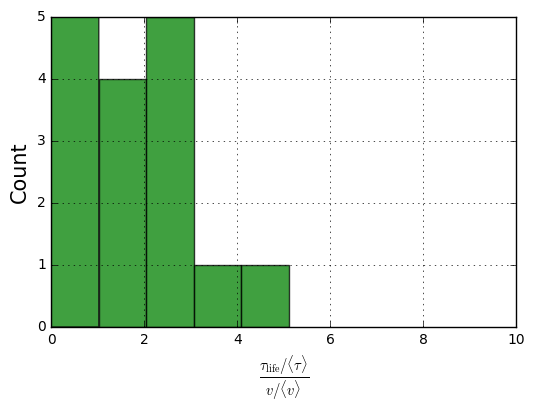

In [69]:
import numpy as np
import matplotlib.mlab as mlab
import matplotlib.pyplot as plt

tlife = np.array([0.15,0.21,0.10,0.88,\
         1.0,0.55,0.9,0.35,\
         1.0,0.6,0.55,0.1,\
         1.0,0.4,0.5,1.0,\
         0.85,1.0,0.7,1.0,\
         0.28,0.12, 0.33,0.05])

size = np.array([8000,2500,1500,1500,\
        35000,15000,9000,8000,\
        20000,6000,6000,5000,\
        10000,3000,3000,2000,\
        35000,32000,25000,20000,\
        48500,25000,25000,9000])


# the histogram of the data
n, bins, patches = plt.hist(tlife/size*np.average(size)/np.average(tlife), 5,\
                            range=[0,5.1], facecolor='green', alpha=0.75)
print 'tavg = ',np.average(tlife)
print 'sizeavg =',np.average(size)
print 'tavg_weighted = ',np.average(tlife*size)/np.average(size)
# add a 'best fit' line
#y = mlab.normpdf( bins, mu, sigma)
#l = plt.plot(bins, y, 'r--', linewidth=1)

plt.xlabel(r'$\frac{\tau_{\rm life}/\langle \tau\rangle}{v/\langle v\rangle}$'\
          ,fontsize=15)
plt.ylabel('Count',fontsize=15)
#plt.title(r'$\mathrm{Histogram\ of\ IQ:}\ \mu=100,\ \sigma=15$')
plt.axis([0, 10, 0, 5])
plt.grid(True)

plt.show()

[   1000.            3162.27766017   10000.           31622.77660168
  100000.        ]
[  2610.15721568   8254.04185268  26101.57215683  82540.4185268 ]
[2 1 1 1 4 3 2 2 3 2 2 2 3 1 1 1 4 4 3 3 4 3 3 2]


(1000.0, 100000.0)

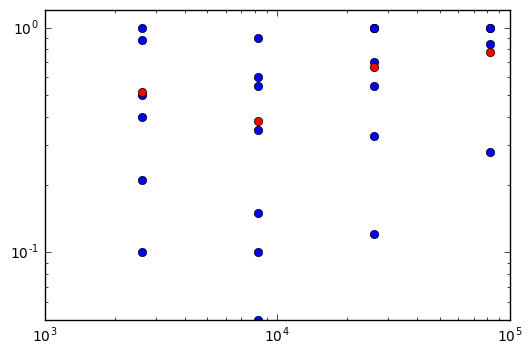

In [67]:



#plot tlife in binned size
nbin = 5
bin_s,bin_e = 10**3,10**5
fbin = np.linspace(np.log10(bin_s),np.log10(bin_e),nbin)
bins = 10**fbin
mids = (bins*10**(np.log10(bin_e)/np.log10(bin_s)/(nbin-1)))[:-1]
print bins
print mids
digitized = np.digitize(size,bins)
print digitized

xx = [mids[i-1] for i in digitized]
plt.plot(xx,tlife,'o')

yy = np.zeros(nbin-1)
nn = np.zeros(nbin-1)
for index,ival in enumerate(digitized):
  yy[ival-1] +=tlife[index]
  nn[ival-1] +=1
    
yy /= nn
plt.plot(mids,yy,'ro')
plt.xscale('log')
plt.yscale('log')
plt.ylim([0,1.2])
plt.xlim([1e3,1e5])
          
    

(0, 0.48)

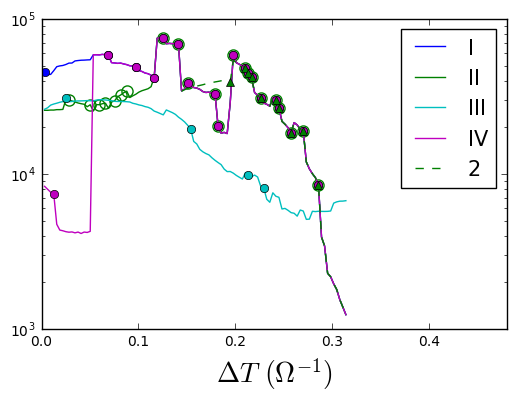

In [129]:
import numpy as np
%matplotlib inline

fname = '/tigress/jiming/reconnect/athena/bin/t45box002/box.000.r0.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)

label ='I'
plt.plot(track['time']*np.pi/1000.,track['size'],'b-',label=label)
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'bo')
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'bo')
    
   
fname = '/tigress/jiming/reconnect/athena/bin/t45box002/box.000.r1.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)
label = 'II'
plt.plot(track['time']*np.pi/1000.,track['size'],'g-',label=label)
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'o',markersize=8,markeredgewidth=1,markeredgecolor='g',markerfacecolor='None')
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'o',markersize=12,markeredgewidth=1,markeredgecolor='g',
markerfacecolor='None')
    
fname = '/tigress/jiming/reconnect/athena/bin/t45box002/box.000.r2.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)
label='III'
plt.plot(track['time']*np.pi/1000.,track['size'],'c-',label=label)
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'co')#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'o',markeredgewidth=1,markeredgecolor='c',
markerfacecolor='None')
    
    
fname = '/tigress/jiming/reconnect/athena/bin/t45box002/box.000.r3.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)
label='IV'
plt.plot(track['time']*np.pi/1000.,track['size'],'m-',label=label)
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'mo')#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'o',markeredgewidth=1,markeredgecolor='c',
markerfacecolor='None')
    
# ##############    
# fname = '/tigress/jiming/reconnect/athena/bin/t45box002/box.045.r0.flow'
# dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
# track = np.loadtxt(fname, dtype=dtype)
# label='1'
# plt.plot(track['time']*np.pi/1000.,track['size'],'b--',label=label)
# for nt,item in enumerate(track['num']):
#     if item == 2:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'b^')#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
#     if item == 3:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'^',markeredgewidth=1,markeredgecolor='c',
# markerfacecolor='None')  
    
fname = '/tigress/jiming/reconnect/athena/bin/t45box002/box.045.r1.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)
label='2'
plt.plot(track['time']*np.pi/1000.,track['size'],'g--',label=label)
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'g^')#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'^',markeredgewidth=1,markeredgecolor='c',
markerfacecolor='None')     
    
# fname = '/tigress/jiming/reconnect/athena/bin/t45box002/box.045.r2.flow'
# dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
# track = np.loadtxt(fname, dtype=dtype)
# label='3'
# plt.plot(track['time']*np.pi/1000.,track['size'],'c--',label=label)
# for nt,item in enumerate(track['num']):
#     if item == 2:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'c^')#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
#     if item == 3:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'^',markeredgewidth=1,markeredgecolor='c',
# markerfacecolor='None') 
    
# fname = '/tigress/jiming/reconnect/athena/bin/t45box002/box.045.r3.flow'
# dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
# track = np.loadtxt(fname, dtype=dtype)
# label='4'
# plt.plot(track['time']*np.pi/1000.,track['size'],'m--',label=label)
# for nt,item in enumerate(track['num']):
#     if item == 2:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'m^')#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
#     if item == 3:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'^',markeredgewidth=1,markeredgecolor='c',
# markerfacecolor='None')  
    
# ##############    
# fname = '/tigress/jiming/reconnect/athena/bin/t45box002/box.075.r0.flow'
# dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
# track = np.loadtxt(fname, dtype=dtype)
# label='1'
# plt.plot(track['time']*np.pi/1000.,track['size'],'b--',label=label)
# for nt,item in enumerate(track['num']):
#     if item == 2:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'b^')#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
#     if item == 3:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'^',markeredgewidth=1,markeredgecolor='c',
# markerfacecolor='None')  
    
# fname = '/tigress/jiming/reconnect/athena/bin/t45box002/box.075.r1.flow'
# dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
# track = np.loadtxt(fname, dtype=dtype)
# label='2'
# plt.plot(track['time']*np.pi/1000.,track['size'],'g--',label=label)
# for nt,item in enumerate(track['num']):
#     if item == 2:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'g^')#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
#     if item == 3:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'^',markeredgewidth=1,markeredgecolor='c',
# markerfacecolor='None')     
    
# fname = '/tigress/jiming/reconnect/athena/bin/t45box002/box.075.r2.flow'
# dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
# track = np.loadtxt(fname, dtype=dtype)
# label='3'
# plt.plot(track['time']*np.pi/1000.,track['size'],'c--',label=label)
# for nt,item in enumerate(track['num']):
#     if item == 2:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'c^')#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
#     if item == 3:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'^',markeredgewidth=1,markeredgecolor='c',
# markerfacecolor='None') 
    
# fname = '/tigress/jiming/reconnect/athena/bin/t45box002/box.075.r3.flow'
# dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
# track = np.loadtxt(fname, dtype=dtype)
# label='4'
# plt.plot(track['time']*np.pi/1000.,track['size'],'m--',label=label)
# for nt,item in enumerate(track['num']):
#     if item == 2:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'m^')#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
#     if item == 3:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'^',markeredgewidth=1,markeredgecolor='c',
# markerfacecolor='None')  

    
plt.legend(fontsize=15)
plt.xlabel(r'$\Delta T$'+' '+r'$(\Omega^{-1})$',fontsize=20)
plt.yscale('log')
plt.xlim([0,0.48])

(0, 0.45)

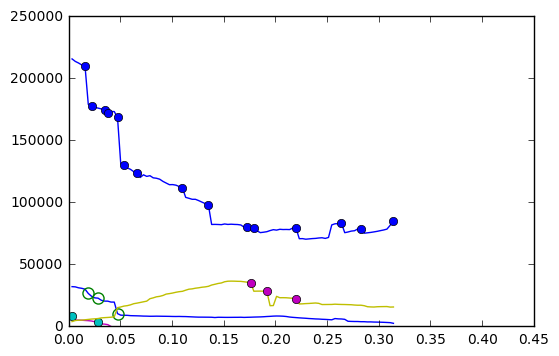

In [126]:
fname = '/tigress/jiming/reconnect/athena/bin/t45box001.comoving/box.000.r0.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)

size = np.array([track['size'][num]+70000 if track['time'][num]<15 else track['size'][num] for num,item in enumerate(track['size']) ])
size[12:14] += 30000
#size = track['size']
dt = np.pi*0.001
plt.plot(track['time']*dt,size,'b-')
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*dt,size[nt],'bo')
    if item == 3:
      plt.plot(track['time'][nt]*dt,size[nt],'bo')
    
    
fname = '/tigress/jiming/reconnect/athena/bin/t45box001.comoving/box.000.r1.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)

plt.plot(track['time']*np.pi/1000.,track['size'])
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'o',markersize=8,markeredgewidth=1,markeredgecolor='g',markerfacecolor='None')
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'o',markersize=12,markeredgewidth=1,markeredgecolor='g',
markerfacecolor='None')
    
fname = '/tigress/jiming/reconnect/athena/bin/t45box001.comoving/box.000.r2.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)

plt.plot(track['time']*np.pi/1000.,track['size'])
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'co')#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'o',markeredgewidth=1,markeredgecolor='c',
markerfacecolor='None')
    
    
fname = '/tigress/jiming/reconnect/athena/bin/t45box001.comoving/box.000.r3.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)

plt.plot(track['time']*np.pi/1000.,track['size'])
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'mo')#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'o',markeredgewidth=1,markeredgecolor='c',
markerfacecolor='None')
    
plt.xlim([0,0.45])

<IPython.core.display.Javascript object>


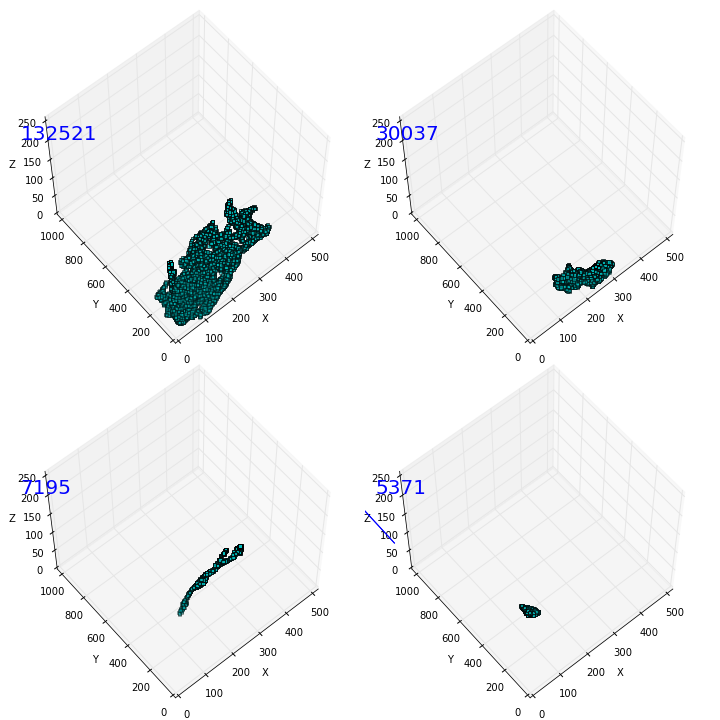

In [114]:
import matplotlib
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.gridspec as gridspec
%matplotlib notebook
%matplotlib notebook
import cPickle as pickle

fname = "/tigress/jiming/reconnect/athena/bin/t45box001.comoving//box.00005.vtk.jlist.p"
jlist_sorted = pickle.load( open(fname, "rb" ) )


#show the first six sheets largest in size
nframe = 2
nplot  = 2
matplotlib.rcParams['figure.figsize'] = (10, 10.0*nframe/nplot)
fig = plt.figure()
fraction=0.046;pad=0.04
xlim = 512 #1024
ylim = 1024 #2048
zlim = 256 #512
stride = 10
gs = gridspec.GridSpec(2, 2)
for i in range(0,4):
  locs = np.array(jlist_sorted[i].keys())
  nlocs = len(locs[:,0])
  ax = fig.add_subplot(gs[i], projection='3d')
  ax.scatter(locs[0:nlocs:stride,2], locs[0:nlocs:stride,1], locs[0:nlocs:stride,0],marker='s',c='c',s=10)
  #ax.plot_surface(locs[:,2], locs[:,1], locs[:,0],rstride=5,cstride=5,color='k')
  #ax.plot_wireframe(locs[:,2],locs[:,1],locs[:,0],rstride=20,
  #                     cstride=20,
  #                     color='DarkSlateBlue',
  #                     linewidth=1,
  #                     antialiased=True)
  ax.set_xlim3d(0, xlim-1)
  ax.set_ylim3d(0, ylim-1)
  ax.set_zlim3d(0, zlim-1)

  ax.set_xlabel('X')
  ax.set_ylabel('Y')
  ax.set_zlabel('Z')
  ax.text(-100, ylim, zlim, str(nlocs), zdir=None,color='b',size=20)
  ax.view_init(elev=60, azim=230)

plt.tight_layout()

(5000.0, 200000.0)

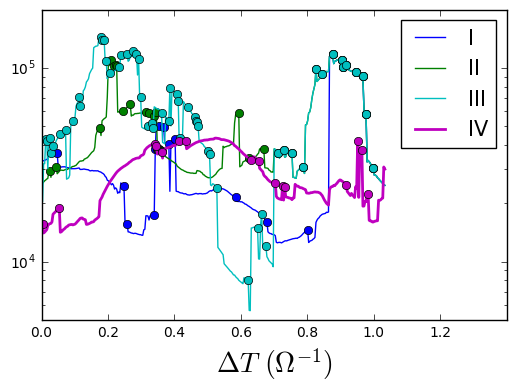

In [19]:
fname = '/tigress/jiming/reconnect/athena/bin/rst_t40/box.000.r0.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)

label ='I'
plt.plot(track['time']*np.pi/1000.,track['size'],'b-',label=label)
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'bo',markersize=6)
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'bo',markersize=6)
    
   
fname = '/tigress/jiming/reconnect/athena/bin/rst_t40/box.000.r1.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)
label = 'II'
plt.plot(track['time']*np.pi/1000.,track['size'],'g-',label=label)
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'go')#,markersize=6,markeredgewidth=1,markeredgecolor='g',markerfacecolor='None')
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'go')#,markersize=6,markeredgewidth=1,markeredgecolor='g',markerfacecolor='None')
    
fname = '/tigress/jiming/reconnect/athena/bin/rst_t40/box.000.r2.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)
label='III'
plt.plot(track['time']*np.pi/1000.,track['size'],'c-',label=label)
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'co',markersize=6)#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'co',markersize=6) #,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
    
    
fname = '/tigress/jiming/reconnect/athena/bin/rst_t40/box.000.r3.flow'
dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
track = np.loadtxt(fname, dtype=dtype)
label='IV'
plt.plot(track['time']*np.pi/1000.,track['size'],'m-',lw=2,label=label)
for nt,item in enumerate(track['num']):
    if item == 2:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'mo',markersize=6)#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
    if item == 3:
      plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'mo',markersize=6) #markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')

# fname = '/tigress/jiming/reconnect/athena/bin/rst_t40/box.000.r4.flow'
# dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
# track = np.loadtxt(fname, dtype=dtype)
# label='V'
# plt.plot(track['time']*np.pi/1000.,track['size'],'y-',label=label)
# for nt,item in enumerate(track['num']):
#     if item == 2:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'yo',markersize=6)#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
#     if item == 3:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'yo',markersize=6) #markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')    



# fname = '/tigress/jiming/reconnect/athena/bin/rst_t40/box.222.r0.flow'
# dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
# track = np.loadtxt(fname, dtype=dtype)

# label ='I'
# plt.plot(track['time']*np.pi/1000.,track['size'],'b--',label=label)
# for nt,item in enumerate(track['num']):
#     if item == 2:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'bo',markersize=6)
#     if item == 3:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'bo',markersize=6)
    
   
# fname = '/tigress/jiming/reconnect/athena/bin/rst_t40/box.222.r1.flow'
# dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
# track = np.loadtxt(fname, dtype=dtype)
# label = 'II'
# plt.plot(track['time']*np.pi/1000.,track['size'],'g--',label=label)
# for nt,item in enumerate(track['num']):
#     if item == 2:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'go')#,markersize=6,markeredgewidth=1,markeredgecolor='g',markerfacecolor='None')
#     if item == 3:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'go')#,markersize=6,markeredgewidth=1,markeredgecolor='g',markerfacecolor='None')
    
# fname = '/tigress/jiming/reconnect/athena/bin/rst_t40/box.222.r2.flow'
# dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
# track = np.loadtxt(fname, dtype=dtype)
# label='III'
# plt.plot(track['time']*np.pi/1000.,track['size'],'c--',label=label)
# for nt,item in enumerate(track['num']):
#     if item == 2:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'co',markersize=6)#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
#     if item == 3:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'co',markersize=6) #,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
    
    
# fname = '/tigress/jiming/reconnect/athena/bin/rst_t40/box.222.r3.flow'
# dtype = np.dtype([('time', 'i'), ('num', 'f8'),('size','f8')])
# track = np.loadtxt(fname, dtype=dtype)
# label='IV'
# plt.plot(track['time']*np.pi/1000.,track['size'],'m--',lw=2,label=label)
# for nt,item in enumerate(track['num']):
#     if item == 2:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'mo',markersize=6)#,markersize=10,markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')
#     if item == 3:
#       plt.plot(track['time'][nt]*np.pi/1000.,track['size'][nt],'mo',markersize=6) #markeredgewidth=1,markeredgecolor='c',markerfacecolor='None')






plt.legend(fontsize=15)
plt.xlabel(r'$\Delta T$'+' '+r'$(\Omega^{-1})$',fontsize=20)
plt.yscale('log')
plt.xlim([0,1.4])
plt.ylim([5e3,2e5])

* t40_rst:  3 mergers; 1 possible self-destructor but last very long > 1 $\Omega^{-1}$. 
* t45box001: 2 mergers, 2 self-destruction
* t45box002: 3 mergers, 1 self-destruction
* 50-70% interaction with other sheets, but only half of them have break the sheets to smaller structures;
* 25-50% self-destruction due to instability like K-H instabiltiy

# appendix

## 1
For given time frame(similar procedures applied to vorticity sheets as well):
   
<font size=2>
`python pspec.py x2y4z1r512pm1re16000 25 41 1 &>log.r512.pspec &
python dump_hist2d.py x2y4z1r512pm1re16000 0 51 >& log.r512.hist &
python cdf_jsheet.py x2y4z1r512pm1re16000 30 51 1 >& log.r512.jcdf &
python cdf_vsheet.py x2y4z1r512pm1re16000 30 51 1 >& log.r512.vcdf &
python main.py x2y4z1r512pm1re16000 30 51 1 >& log.r512.jlist &
python main_vsheet.py x2y4z1r512pm1re16000 30 51 1 >& log.r512.vlist &
python get_jsheet_prop.py x2y4z1r512pm1re16000 30 51 1 6.25e-5,8 >& log.r512.jprop &
python get_j_vsheet_prop.py x2y4z1r512pm1re16000 30 51 1 6.25e-5,8 >& log.r512.vprop &`</font>

(0) try compute power spectra and dump the horizontal/vertical averaged hist file from 3d dumps.

(1) estimate the $j_{th}$ the threshold value for any $j$ above $j_{th}$ which account for 25% of the total dissipation.

(2) save threshold value, volume averaged $\langle j^2\rangle$ for the sheet and whole box  ==>  *basename.jth.tab*

(3) individual jlist, which defined as [jsheet1,jsheet2,...] a list of dictionaries, are saved sepratedly for each frame as   *basename.nnnnn.jlist.p*

(4) get jsheet properties(saved as *jprop.nnnnn.p*) such as, 
* number of cells for given jsheet
* peak current density jmax
* dimension [$\lambda\pm\Delta\lambda$, $\xi\pm\Delta\xi$, $l\pm\Delta l$]
* orientation $\vec{P}$, $\langle j^2\rangle_{sh}$
* dissipation rate $\langle\eta j^2\rangle_{sh}$

Average over several frames:

(1) threshold value $j_{th}$ for identifying jsheet in table: *basename.jth.p*

(2) combined properties of jsheets in all frames: *jprop_ts=nn_te=nn.p*

<!---
Basic calling sequence:
python main.py x2y4z1r128pm1re4000 50 101 1         to get jlist
python main_vsheet.py x2y4z1r128pm1re4000 50 101 1  to get vlist
python get_jsheet_prop.py x2y4z1r128pm1re4000 50 101 1 [2.5e-4] [8]  to get jprop
python get_vsheet_prop.py x2y4z1r128pm1re4000 50 101 1 [2.5e-4] [8]  to get vprop
python pspec.py x2y4z1r512pm1re16000 17 18 1        to get powerspectra
!-->

## 2. threshold values and average dissipation rate

* the threshold exhibits big fluctuations which exactly follows the fluctuation of the stress;  an example of itermittency of mri driven turbulence
* that's why in our analysis, we try to normalized the dissipation with rms values.

9.608308 0.008
avg(work)= 3.6117047337
avg(diss)= 1.93686625275 1.20490820319 0.731958049558
avg(Ekin)=,avg(Emag)= 1.39049319867 3.84336260689
avg(Ekin)=,avg(Emag)= 1.576658846 4.64003239


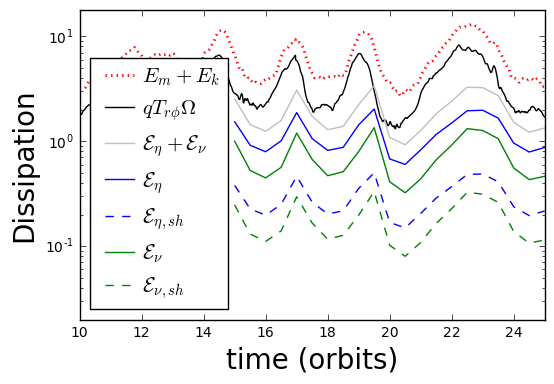

In [195]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
#import athena4_read as ath
import athena_read as ath
from read_hist import read_hist1d,read_hist1d_ek
import cPickle as pickle
%matplotlib inline

fdir =  '/tigress/jiming/reconnect/athena/bin/'

targ = 'x2y4z1r512pm1re16000/'
eta,nu = 1/16000.,1/16000.
vol,ngrid = 2*4*1.0,512*1024*1008
fname = fdir+targ+'Unstra.out2.jth.tab'
dtype1 = np.dtype([('time', 'f8'), ('jth2', 'f8'),\
                   ('jcs2','f8'),('j2','f8')])
jtab = np.loadtxt(fname, dtype=dtype1)
jsh = eta*jtab['jcs2']
jvol = eta*jtab['j2']
#get size info for each given time
ncellstot = np.zeros(21)
for i in np.arange(30,51,1):
    basename='jprop.'
    appdname='.p'
    fname = fdir+targ+basename+str(i).zfill(5)+appdname
    ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
    ncellstot[i-30] = float(np.sum(np.array(ncells)))
    
jsh *= ncellstot*vol/ngrid
jvol *= vol

## vsheet now
fname = fdir+targ+'Unstra.out2.wth.tab'
dtype1 = np.dtype([('time', 'f8'), ('wth2', 'f8'),\
                   ('wcs2','f8'),('w2','f8')])
vtab = np.loadtxt(fname, dtype=dtype1)
#1) w^2 alone
vsh = nu*vtab['wcs2'][0:21]
vvol = nu*vtab['w2'][0:21]
for i in np.arange(30,51,1):
    basename='vprop.'
    appdname='.p'
    fname = fdir+targ+basename+str(i).zfill(5)+appdname
    ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
    ncellstot[i-30] = float(np.sum(np.array(ncells)))
vsh *=ncellstot*vol/ngrid
vvol *= vol

#2) rho w^2 
vsh2 = nu*vtab['wcs2'][21:]
vvol2 = nu*vtab['w2'][21:]
for i in np.arange(30,51,1):
    basename='vprop2.'
    appdname='.p'
    fname = fdir+targ+basename+str(i).zfill(5)+appdname
    ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
    ncellstot[i-30] = float(np.sum(np.array(ncells)))
vsh2 *=ncellstot*vol/ngrid
vvol2 *= vol

time_dis  = np.arange(30,51)/2.

## Now stress work 
fname = fdir+targ+'Unstra.hst'
tt,ek1,ek2,ek3,maxwell,reynolds = read_hist1d_ek(fname)
tt,em1,em2,em3,maxwell,reynolds = read_hist1d(fname)
torb = 2.0*np.pi; pres=1; volume=2*4*1.0
time = tt/torb
work = (maxwell+reynolds)/pres*1.5
emag = (em1+em2+em3)/pres
ekin = (ek1+ek2+ek3)/pres
print np.max(emag),np.min(emag)
fac=1.
plt.plot(time,(emag+ekin-3.)*fac,'r:',label=r'$E_m+E_k$',linewidth=2)
#plt.plot(time,ekin*fac,'c:',label=r'$E_k$',linewidth=2)
plt.plot(time,work*fac,'k-',label=r'$qT_{r\phi}\Omega$')
plt.plot(time_dis,(jvol+vvol)*fac,color='0.75',label=r'$\mathcal{E}_{\eta}+\mathcal{E}_{\nu}$')
plt.plot(time_dis,jvol*fac,'b-',label=r'$\mathcal{E}_{\eta}$')
plt.plot(time_dis,jsh*fac,'b--',label=r'$\mathcal{E}_{\eta,sh}$')
plt.plot(time_dis,vvol*fac,'g-',label=r'$\mathcal{E}_{\nu}$')
#plt.plot(time_dis,vvol2*fac,'y--')
plt.plot(time_dis,vsh*fac,'g--',label=r'$\mathcal{E}_{\nu,sh}$')
#plt.plot(time_dis,vsh2*fac,'r--')


plt.legend(fontsize=15,loc=3,handlelength=2,handletextpad= 0.1)
plt.xlim([10,25])
plt.yscale('log')
plt.ylim([0.02,18])
plt.xlabel('time (orbits)',fontsize=20)
plt.ylabel('Dissipation',fontsize=20)

print "avg(work)=",np.average(work[1500:2500])
print "avg(diss)=",np.average(jvol+vvol),np.average(jvol),np.average(vvol)
print "avg(Ekin)=,avg(Emag)=",np.average(ekin-eshear),np.average(emag)
print "avg(Ekin)=,avg(Emag)=",np.average(ekin[1500:2500]-eshear),np.average(emag[1500:2500])

#plt.savefig('dissipation.png', format='png', dpi=300)


2501
Recovered time shift: -30
(1000,) (1000,)
Recovered time shift: -11


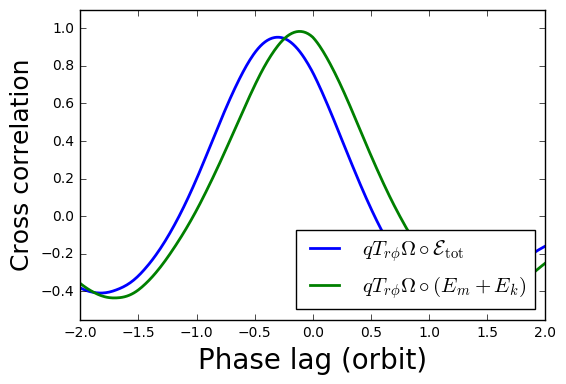

In [189]:
#phase lag
import scipy
from scipy.signal import correlate

# Load datasets, taking mean of 100 values in each table row
print len(work)
A = work[-1000:]
B = np.interp(np.linspace(15,25,1000),np.linspace(15,25,21),jvol+vvol)
nsamples = A.size
# regularize datasets by subtracting mean and dividing by s.d.
A -= A.mean(); A /= A.std()
B -= B.mean(); B /= B.std()
# Find cross-correlation
xcorr = correlate(A, B)
# delta time array to match xcorr
dt = np.arange(1-nsamples, nsamples)
recovered_time_shift = dt[xcorr.argmax()]
print "Recovered time shift: %d" % (recovered_time_shift)
plt.plot(dt/100.,xcorr/1000,lw=2,label=r'$qT_{r\phi}\Omega\circ \mathcal{E}_{\rm tot}$')

## add c-correlation between Em+Ek and work
eshear = 3.0
B = emag[-1000:]+ekin[-1000:]-eshear
print np.shape(A),np.shape(B)
nsamples = A.size
# regularize datasets by subtracting mean and dividing by s.d.
A -= A.mean(); A /= A.std()
B -= B.mean(); B /= B.std()
# Find cross-correlation
xcorr = correlate(A, B)
# delta time array to match xcorr
dt = np.arange(1-nsamples, nsamples)
recovered_time_shift = dt[xcorr.argmax()]
print "Recovered time shift: %d" % (recovered_time_shift)
plt.plot(dt/100.,xcorr/1000,lw=2,label=r'$qT_{r\phi}\Omega\circ (E_m+E_k)$')

plt.xlim([-2,2])
plt.ylim([-0.55,1.1])




plt.xlim([-2,2])
plt.xlabel('Phase lag (orbit)',fontsize=20)
plt.ylabel('Cross correlation',fontsize=18)
plt.legend(fontsize=15,loc=4)
plt.savefig('phase_lag.png', format='png', dpi=300)

### Re=8000 and Re=4000 run energy budget
* Re=16000:avg(work)= 3.6117047337
avg(diss)= 1.93686625275 1.20490820319 0.731958049558
avg(Ekin)=,avg(Emag)= 1.576658846 4.64003239

* Re=8000: avg(work)= 2.26403332206
avg(diss)= 1.2169367908 0.818056960643 0.398879830153
avg(Ekin)=,avg(Emag)= 1.00012693747 2.68887330709

* Re=4000: avg(work)= 1.62180138523
avg(diss)= 0.826016159667 0.586532973829 0.239483185838
avg(Ekin)=,avg(Emag)= 0.80681239644 1.74920250272

* Re=8000 adb:avg(work)= 2.01540491895
avg(diss)= 1.19493189032 0.861887738367 0.333044151954
avg(Ekin)=,avg(Emag)= 0.7773139616 2.4071881239

* r256 ideal:
avg(Ekin)=,avg(Emag)= 1.22158366086, 3.19543845045

*r64re4000:
avg(work)= 1.49862667326
avg(diss)= 0.429871019961 0.307199555885 0.122671464075
avg(Ekin)=,avg(Emag)= 0.60791524972 1.54717011644

*working on x2y4z1r256pm1re4000
6.636665 0.008
avg(work)= 1.52189354348
avg(diss)= 1.18671573046 0.844279835385 0.342435895075
avg(Ekin)=,avg(Emag)= 0.65751577665 1.68588908765

*working on x2y4z1r512pm1re8000
8.808384 0.008
avg(work)= 2.57778773569
avg(diss)= 1.9241996353 1.28638655356 0.637813081736
avg(Ekin)=,avg(Emag)= 1.12137771222 3.14038396356


In [204]:
fdir =  '/tigress/jiming/reconnect/athena/bin/'
targ = 'x2y4z1r256ideal/'
fname = fdir+targ+'Unstra.hst'
tt,ek1,ek2,ek3,maxwell,reynolds = read_hist1d_ek(fname)
tt,em1,em2,em3,maxwell,reynolds = read_hist1d(fname)
ekin = ek1+ek2+ek3 -3.0
emag = em1+em2+em3
print np.average(ekin[1000:2499])
print np.average(emag[1000:2499])

1.30081620961
3.40505254036


working on x2y4z1r256pm1re8000
10.998645 0.008
avg(work)= 2.26403332206
avg(diss)= 1.2169367908 0.818056960643 0.398879830153
avg(Ekin)=,avg(Emag)= 1.00012693747 2.68887330709


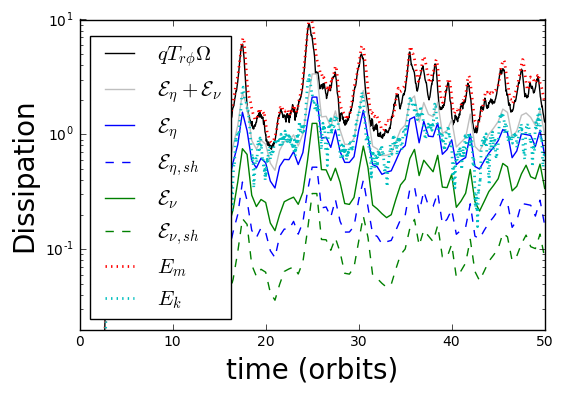

In [274]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
#import athena4_read as ath
import athena_read as ath
from read_hist import read_hist1d,read_hist1d_ek
import cPickle as pickle
%matplotlib inline



targlist=['x2y4z1r64pm1re4000','x2y4z1r128pm1re4000','x2y4z1r256pm1re4000',\
          'x2y4z1r256pm1re8000','x2y4z1r512pm1re8000',\
          'x2y4z1r512pm1re16000']#,'adb.r256.new']
fdir =  '/tigress/jiming/reconnect/athena/bin/'


for targ in targlist[3:4]:
    print "working on "+targ
    ts,te,tstride = 30,51,1
    label = targ[6:]
    if targ == 'x2y4z1r64pm1re4000':
      ts,te,tstride = 50,101,1
      eta,nu=1/4000.,1/4000.
      vol,ngrid = 2*4*1.0,64*128*126
    elif targ == 'x2y4z1r128pm1re4000':
      ts,te,tstride =50,101,1 #50, 100,1 #
      eta,nu=1/4000.,1/4000.
      vol,ngrid = 2*4*1.0,64*128*126*8
    elif targ == 'x2y4z1r256pm1re4000':
      ts,te,tstride = 30,51,1 #
      eta,nu=1/4000.,1/4000.
      vol,ngrid = 2*4*1.0,64*128*126*8*8
    elif targ == 'x2y4z1r256pm1re8000':
      ts,te,tstride = 30,101,1
      eta,nu=1/8000.,1/8000.
      vol,ngrid = 2*4*1.0,64*128*126*8*8
    elif targ == 'x2y4z1r512pm1re8000':
      ts,te,tstride = 30,49,1 
      eta,nu=1/8000.,1/8000.
      vol,ngrid = 2*4*1.0,64*128*126*8*8
    elif targ == 'x2y4z1r512pm1re16000':
      ts,te,tstride = 30,51,1 
      eta,nu=1/16000.,1/16000.
      vol,ngrid = 2*4*1.0,64*128*126*8*8*8
    elif targ == 'adb.r256.new':
      ts,te,tstride = 10,31,1
      label='r256adb'
      eta,nu=1/8000.,1/8000.
      vol,ngrid = 2*4*1.0,64*128*126*8*8
    else:
      print "error input filename"


    fname = fdir+targ+'/Unstra.out2.jth.tab'
    dtype1 = np.dtype([('time', 'f8'), ('jth2', 'f8'),\
                       ('jcs2','f8'),('j2','f8')])
    jtab = np.loadtxt(fname, dtype=dtype1)
    jsh = eta*jtab['jcs2']
    jvol = eta*jtab['j2']
   
    ncellstot = np.zeros(te-ts)
    nt = te-ts
    
    #for i in np.arange(30,101,1):
    for i in np.arange(ts,te,1):
        basename='jprop.'
        appdname='.p'
        fname = fdir+targ+'/'+basename+str(i).zfill(5)+appdname
        ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
        #ncellstot[i-30] = float(np.sum(np.array(ncells)))
        ncellstot[i-ts] = float(np.sum(np.array(ncells)))

    jsh *= ncellstot*vol/ngrid
    jvol *= vol

    ## vsheet now
    fname = fdir+targ+'/Unstra.out2.wth.tab'
    dtype1 = np.dtype([('time', 'f8'), ('wth2', 'f8'),\
                       ('wcs2','f8'),('w2','f8')])
    vtab = np.loadtxt(fname, dtype=dtype1)
    #1) w^2 alone
    #vsh = nu*vtab['wcs2'][0:71]
    #vvol = nu*vtab['w2'][0:71]
    #for i in np.arange(30,101,1):
    vsh = nu*vtab['wcs2'][0:nt]
    vvol = nu*vtab['w2'][0:nt]
    for i in np.arange(ts,te,1):
        basename='vprop.'
        appdname='.p'
        fname = fdir+targ+'/'+basename+str(i).zfill(5)+appdname
        ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
        #ncellstot[i-30] = float(np.sum(np.array(ncells)))
        ncellstot[i-ts] = float(np.sum(np.array(ncells)))
    vsh *=ncellstot*vol/ngrid
    vvol *= vol

    time_dis  = np.arange(ts,te)/2.

    ## Now stress work 
    fname = fdir+targ+'/Unstra.hst'
    tt,ek1,ek2,ek3,maxwell,reynolds = read_hist1d_ek(fname)
    tt,em1,em2,em3,maxwell,reynolds = read_hist1d(fname)
    torb = 2.0*np.pi; pres=1; volume=2*4*1.0
    time = tt/torb
    work = (maxwell+reynolds)/pres*1.5
    emag = (em1+em2+em3)/pres
    ekin = (ek1+ek2+ek3)/pres
    print np.max(emag),np.min(emag)
    fac=1.
    plt.plot(time,work*fac,'k-',label=r'$qT_{r\phi}\Omega$')
    plt.plot(time_dis,(jvol+vvol)*fac,color='0.75',label=r'$\mathcal{E}_{\eta}+\mathcal{E}_{\nu}$')
    plt.plot(time_dis,jvol*fac,'b-',label=r'$\mathcal{E}_{\eta}$')
    plt.plot(time_dis,jsh*fac,'b--',label=r'$\mathcal{E}_{\eta,sh}$')
    plt.plot(time_dis,vvol*fac,'g-',label=r'$\mathcal{E}_{\nu}$')
    #plt.plot(time_dis,vvol2*fac,'y--')
    plt.plot(time_dis,vsh*fac,'g--',label=r'$\mathcal{E}_{\nu,sh}$')
    #plt.plot(time_dis,vsh2*fac,'r--')
    plt.plot(time,emag*fac,'r:',label=r'$E_m$',linewidth=2)
    den0,cs,H= 1.0,1.0,1.0
    eshear = 3.0*den0*cs**2*H**3
    plt.plot(time,(ekin-eshear)*fac,'c:',label=r'$E_k$',linewidth=2)

    plt.legend(fontsize=15,loc=3)
    plt.xlim([0,50])
    plt.yscale('log')
    plt.ylim([0.02,10])
    plt.xlabel('time (orbits)',fontsize=20)
    plt.ylabel('Dissipation',fontsize=20)

    print "avg(work)=",np.average(work[ts*50:5000])
    print "avg(diss)=",np.average(jvol+vvol),np.average(jvol),np.average(vvol)
    print "avg(Ekin)=,avg(Emag)=",np.average(ekin[ts*50:5000]-eshear),np.average(emag[ts*50:5000])



4999
(71,) (71,)
(3500,) (3500,)
Recovered time shift: -31
(3500,) (3500,)
Recovered time shift: -9


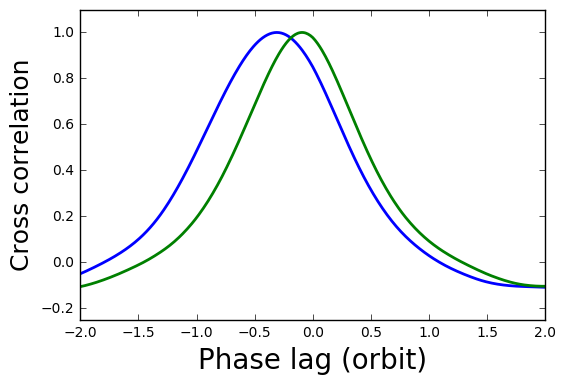

In [174]:
#phase lag
import scipy
from scipy.signal import correlate

# Load datasets, taking mean of 100 values in each table row
print len(work)
A = work[1499:5000]
B = np.interp(np.linspace(14.99,50,3500),np.linspace(15,50,71),jvol+vvol)

#plt.plot(work)
#plt.plot(np.linspace(15,25,1000),B)
print np.shape(jvol),np.shape(vvol)
print np.shape(A),np.shape(B)

nsamples = A.size

# regularize datasets by subtracting mean and dividing by s.d.
A -= A.mean(); A /= A.std()
B -= B.mean(); B /= B.std()

# Find cross-correlation
xcorr = correlate(A, B)

# delta time array to match xcorr
dt = np.arange(1-nsamples, nsamples)

recovered_time_shift = dt[xcorr.argmax()]
print "Recovered time shift: %d" % (recovered_time_shift)

plt.plot(dt/100.,xcorr/np.max(xcorr),lw=2)


## add c-correlation between Em+Ek and work
B = emag[1499:5000]+ekin[1499:5000]-eshear
print np.shape(A),np.shape(B)
nsamples = A.size
# regularize datasets by subtracting mean and dividing by s.d.
A -= A.mean(); A /= A.std()
B -= B.mean(); B /= B.std()
# Find cross-correlation
xcorr = correlate(A, B)
# delta time array to match xcorr
dt = np.arange(1-nsamples, nsamples)
recovered_time_shift = dt[xcorr.argmax()]
print "Recovered time shift: %d" % (recovered_time_shift)
plt.plot(dt/100.,xcorr/np.max(xcorr),lw=2)

plt.xlim([-2,2])
plt.ylim([-0.25,1.1])
plt.xlabel('Phase lag (orbit)',fontsize=20)
plt.ylabel('Cross correlation',fontsize=18)



#plt.savefig('phase_lag.png', format='png', dpi=300)

## energy budget for adiabatic run

6.505613 0.00897799581
avg(work)= 2.01540491895
avg(diss)= 1.19493189032 0.861887738367 0.333044151954
avg(Ekin)=,avg(Emag)= 0.7773139616 2.4071881239


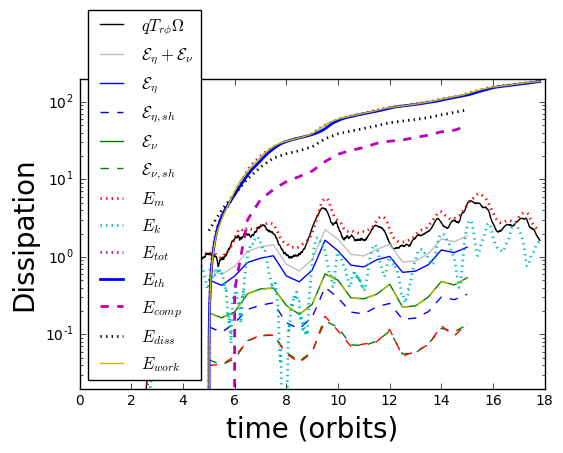

In [200]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
#import athena4_read as ath
import athena_read as ath
from read_hist import read_hist1d,read_hist1d_ek,read_hist1d_energy
import cPickle as pickle
%matplotlib inline

fdir =  '/tigress/jiming/reconnect/athena/bin/'
targ = 'adb.r256.new/'
eta,nu = 1/8000.,1/8000.
vol,ngrid = 2*4*1.0,512*504*256  #512*1024*1008
fname = fdir+targ+'Unstra.out2.jth.tab'
dtype1 = np.dtype([('time', 'f8'), ('jth2', 'f8'),\
                   ('jcs2','f8'),('j2','f8')])
jtab = np.loadtxt(fname, dtype=dtype1)
jsh = eta*jtab['jcs2']
jvol = eta*jtab['j2']
#get size info for each given time
ncellstot = np.zeros(21)
for i in np.arange(10,31,1):
    basename='jprop.'
    appdname='.p'
    fname = fdir+targ+basename+str(i).zfill(5)+appdname
    ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
    ncellstot[i-10] = float(np.sum(np.array(ncells)))
    
jsh *= ncellstot*vol/ngrid
jvol *= vol

## vsheet now
fname = fdir+targ+'Unstra.out2.wth.tab'
dtype1 = np.dtype([('time', 'f8'), ('wth2', 'f8'),\
                   ('wcs2','f8'),('w2','f8')])
vtab = np.loadtxt(fname, dtype=dtype1)
#1) w^2 alone
vsh = nu*vtab['wcs2'][0:42:2]
vvol = nu*vtab['w2'][0:42:2]
for i in np.arange(10,31,1):
    basename='vprop.'
    appdname='.p'
    fname = fdir+targ+basename+str(i).zfill(5)+appdname
    ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
    ncellstot[i-10] = float(np.sum(np.array(ncells)))
vsh *=ncellstot*vol/ngrid
vvol *= vol

#2) rho w^2 
vsh2 = nu*vtab['wcs2'][1:42:2]
vvol2 = nu*vtab['w2'][1:42:2]
for i in np.arange(10,31,1):
    basename='vprop2.'
    appdname='.p'
    fname = fdir+targ+basename+str(i).zfill(5)+appdname
    ncells,jmax,diss,size,orient = pickle.load( open(fname, "rb" ) )
    ncellstot[i-30] = float(np.sum(np.array(ncells)))
vsh2 *=ncellstot*vol/ngrid
vvol2 *= vol

time_dis  = np.arange(10,31)/2.

## Now stress work 
fname = fdir+targ+'Unstra.hst'
tt,ek1,ek2,ek3,maxwell,reynolds = read_hist1d_ek(fname,adb=True)
tt,em1,em2,em3,maxwell,reynolds = read_hist1d(fname,adb=True)
torb = 2.0*np.pi; pres=1; volume=2*4*1.0
time = tt/torb
work = (maxwell+reynolds)*1.5
emag = (em1+em2+em3)
ekin = (ek1+ek2+ek3)
print np.max(emag),np.min(emag)
fac=1.
plt.plot(time,work*fac,'k-',label=r'$qT_{r\phi}\Omega$')
plt.plot(time_dis,(jvol+vvol)*fac,color='0.75',label=r'$\mathcal{E}_{\eta}+\mathcal{E}_{\nu}$')
plt.plot(time_dis,jvol*fac,'b-',label=r'$\mathcal{E}_{\eta}$')
plt.plot(time_dis,jsh*fac,'b--',label=r'$\mathcal{E}_{\eta,sh}$')
plt.plot(time_dis,vvol*fac,'g-',label=r'$\mathcal{E}_{\nu}$')
plt.plot(time_dis,vvol2*fac,'y--')
plt.plot(time_dis,vsh*fac,'g--',label=r'$\mathcal{E}_{\nu,sh}$')
plt.plot(time_dis,vsh2*fac,'r--')

plt.plot(time,emag*fac,'r:',label=r'$E_m$',linewidth=2)
plt.plot(time,(ekin-3)*fac,'c:',label=r'$E_k$',linewidth=2)


# now total energy
tt,ek1,ek2,ek3,em1,em2,em3,etot = read_hist1d_energy(fname)
plt.plot(time,etot*fac-etot[500],'m:',label=r'$E_{tot}$',linewidth=2)

#internal energy: thermalization rate
ein = etot-ek1-ek2-ek3-em1-em2-em3
plt.plot(time,ein*fac-ein[500],'b-',label=r'$E_{th}$',linewidth=2)

#compressive heating
dt = 0.5*torb
emicro = np.cumsum((jvol+vvol)*dt)
ecomp = etot[500:1501:50]-etot[500] - emicro
plt.plot(time_dis,ecomp*fac,'m--',label=r'$E_{comp}$',linewidth=2)
plt.plot(time_dis,emicro*fac,'k:',label=r'$E_{diss}$',linewidth=2)

ework = np.cumsum(work*0.01*torb)
plt.plot(time,ework-ework[500],'y-',label=r'$E_{work}$',linewidth=1)

plt.legend(fontsize=12,loc=3)
#plt.xlim([-5,15])
plt.yscale('log')
plt.ylim([0.02,200])
plt.xlabel('time (orbits)',fontsize=20)
plt.ylabel('Dissipation',fontsize=20)
print "avg(work)=",np.average(work[500:1500])
print "avg(diss)=",np.average(jvol+vvol),np.average(jvol),np.average(vvol)
print "avg(Ekin)=,avg(Emag)=",np.average(ekin[500:1500]-eshear),np.average(emag[500:1500])

#plt.savefig('dissipation.png', format='png', dpi=300)


In [24]:
print time[1000]

10.0000392998


1782
Recovered time shift: -13


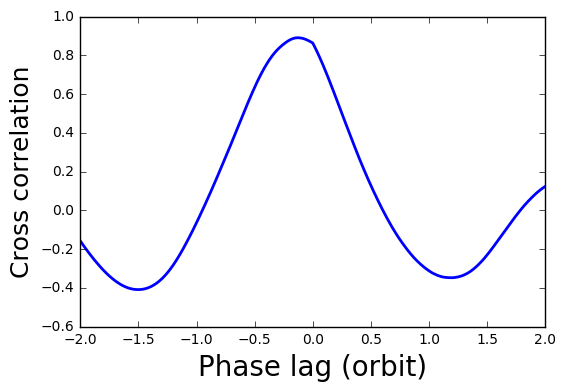

In [29]:
#phase lag
import scipy
from scipy.signal import correlate

# Load datasets, taking mean of 100 values in each table row
print len(work)
A = work[500:1500]
B = np.interp(np.linspace(5,15,1000),np.linspace(5,15,21),jvol+vvol)

#plt.plot(work)
#plt.plot(np.linspace(15,25,1000),B)

nsamples = A.size

# regularize datasets by subtracting mean and dividing by s.d.
A -= A.mean(); A /= A.std()
B -= B.mean(); B /= B.std()

# Find cross-correlation
xcorr = correlate(A, B)

# delta time array to match xcorr
dt = np.arange(1-nsamples, nsamples)

recovered_time_shift = dt[xcorr.argmax()]
print "Recovered time shift: %d" % (recovered_time_shift)

plt.plot(dt/100.,xcorr/1000,lw=2)
plt.xlim([-2,2])
plt.xlabel('Phase lag (orbit)',fontsize=20)
plt.ylabel('Cross correlation',fontsize=18)
plt.savefig('phase_lag.png', format='png', dpi=300)

* the ratio $\langle j\rangle /\langle j \rangle_{sheet}$ is insensitive to resolution as long as the dissipation scales are resolved; 

* similarly, the dependence on Rm is also relatively weak

for x2y4z1r64pm1re4000: (<j^2_sheet>/<j^2>) =  8.34843444783
for x2y4z1r128pm1re4000: (<j^2_sheet>/<j^2>) =  10.8341616951
for x2y4z1r256pm1re4000: (<j^2_sheet>/<j^2>) =  12.7273111652
for x2y4z1r256pm1re8000: (<j^2_sheet>/<j^2>) =  14.6289862414
for x2y4z1r512pm1re8000: (<j^2_sheet>/<j^2>) =  19.5333787297
for x2y4z1r512pm1re16000: (<j^2_sheet>/<j^2>) =  21.9122454566


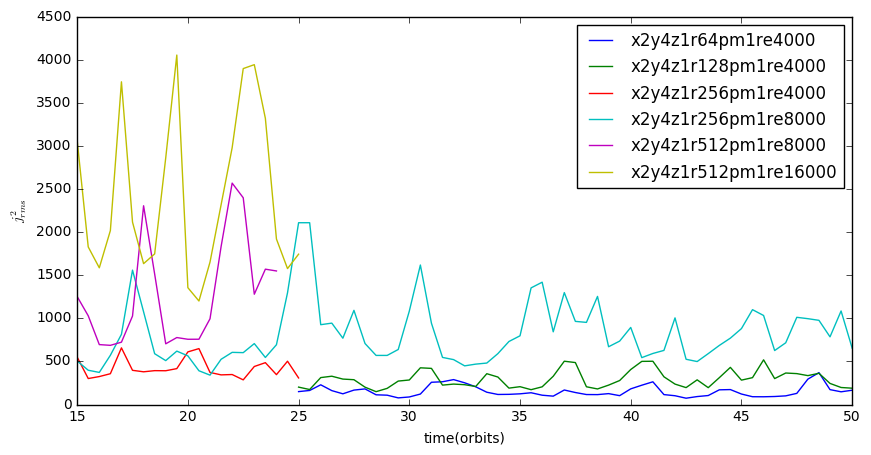

In [29]:
fdir =  '/tigress/jiming/reconnect/athena/bin/'
targlist = ['x2y4z1r64pm1re4000','x2y4z1r128pm1re4000',\
            'x2y4z1r256pm1re4000','x2y4z1r256pm1re8000','x2y4z1r512pm1re8000',\
            'x2y4z1r512pm1re16000']


for targ in targlist:
    fname = fdir+targ+'/Unstra.out2.jth.tab'
    dtype1 = np.dtype([('time', 'f8'), ('jth2', 'f8'),\
                       ('jcs2','f8'),('j2','f8')])
    jtab = np.loadtxt(fname, dtype=dtype1)
    plt.plot(jtab['time']/2.,(jtab['j2']),label=targ)
    print 'for '+targ+': (<j^2_sheet>/<j^2>) = ',\
           (np.average(jtab['jcs2']/jtab['j2']))
plt.xlabel('time(orbits)')
#plt.ylabel(r'$\langle j^2\rangle/\langle j^2\rangle_{sheet}$')
plt.ylabel(r'$j_{rms}^2$')
plt.legend(fontsize=12,loc=1)

## test yt

In [19]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
#import athena4_read as ath
#import athena_read as ath
#from main import loadData
import yt
%matplotlib inline

fdir =  '/tigress/jiming/reconnect/athena/bin/'
targ = 'x2y4z1r128pm1re4000/'
#targ = 'x2y4z1r256pm1re8000/'
targ = 'x2y4z1r512pm1re16000/'
fname = fdir+targ+'Unstra.out2.00050.athdf'
data=yt.load(fname)

yt : [WARNING  ] 2017-06-06 14:44:11,414 Assuming 1.0 = 1.0 cm
yt : [WARNING  ] 2017-06-06 14:44:11,416 Assuming 1.0 = 1.0 s
yt : [WARNING  ] 2017-06-06 14:44:11,417 Assuming 1.0 = 1.0 g
yt : [WARNING  ] 2017-06-06 14:44:11,418 Assuming 1.0 = 1.0 K
yt : [INFO     ] 2017-06-06 14:44:11,464 Parameters: current_time              = 157.079424821
yt : [INFO     ] 2017-06-06 14:44:11,465 Parameters: domain_dimensions         = [1024 1008  512]
yt : [INFO     ] 2017-06-06 14:44:11,467 Parameters: domain_left_edge          = [-1.  -2.  -0.5]
yt : [INFO     ] 2017-06-06 14:44:11,469 Parameters: domain_right_edge         = [ 1.   2.   0.5]
yt : [INFO     ] 2017-06-06 14:44:11,470 Parameters: cosmological_simulation   = 0.0


## histogram of $v_x$ in MRI turbulence. $c_s=1$

(array([  3.24400000e+03,   3.52700000e+03,   4.14600000e+03,
          4.59000000e+03,   5.15000000e+03,   5.82600000e+03,
          6.38300000e+03,   7.13100000e+03,   8.00600000e+03,
          8.86000000e+03,   1.02150000e+04,   1.13040000e+04,
          1.28660000e+04,   1.42090000e+04,   1.62120000e+04,
          1.82740000e+04,   2.03440000e+04,   2.28370000e+04,
          2.58250000e+04,   2.90990000e+04,   3.24880000e+04,
          3.68550000e+04,   4.11620000e+04,   4.56320000e+04,
          5.18050000e+04,   5.81350000e+04,   6.58070000e+04,
          7.37870000e+04,   8.26990000e+04,   9.32260000e+04,
          1.04183000e+05,   1.16809000e+05,   1.32367000e+05,
          1.47260000e+05,   1.65666000e+05,   1.86529000e+05,
          2.09120000e+05,   2.36706000e+05,   2.64714000e+05,
          2.96540000e+05,   3.34108000e+05,   3.73710000e+05,
          4.22238000e+05,   4.70967000e+05,   5.31633000e+05,
          5.97761000e+05,   6.70276000e+05,   7.53234000e+05,
        

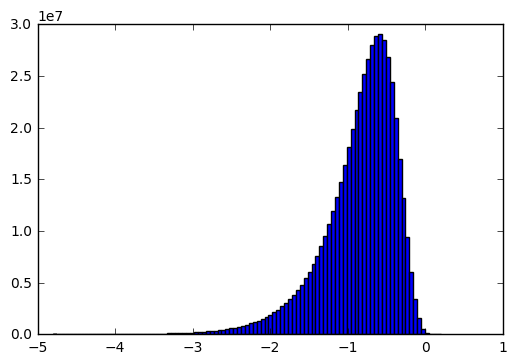

In [22]:
ad = data.all_data()
vel1 = ad['athena_pp','vel1']
plt.hist(np.log10(np.abs(vel1)),bins=np.linspace(-4.8,0.2,100))

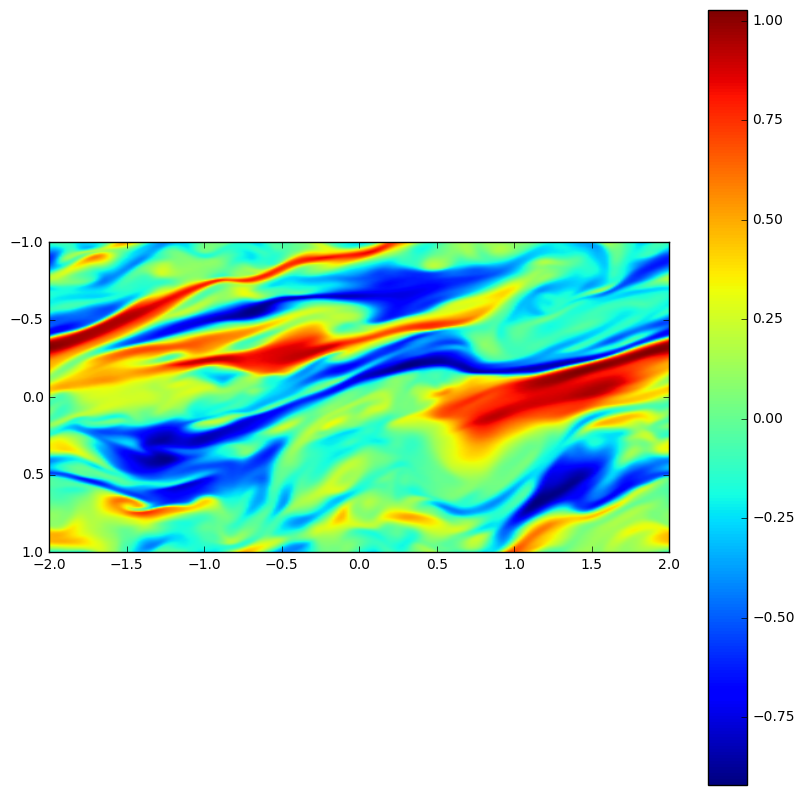

In [107]:
all_data_level_0 = data.covering_grid(level=0, left_edge=[-1,-2,-0.5],dims=data.domain_dimensions)
density = all_data_level_0['Bcc2']
plt.figure(figsize=(10,10))
plt.imshow(density[:,:,64],origin='upper',extent=[-2,2,1,-1])#,vmin=0.5,vmax=1.5)
plt.colorbar()

In [167]:
def current_density(data):
    ad = data.covering_grid(level=0, left_edge=[-1,-2,-0.5],dims=data.domain_dimensions)
    def curl(vx,vy,vz,dx,dy,dz):
        [dxvx,dyvx,dzvx] = np.gradient(vx)               
        [dxvy,dyvy,dzvy] = np.gradient(vy)
        [dxvz,dyvz,dzvz] = np.gradient(vz)               
        cx = dyvz/dy-dzvy/dz
        cy = dzvx/dz-dxvz/dx                             
        cz = dxvy/dx-dyvx/dy 
        return cx**2+cy**2+cz**2
    j2 = curl(ad['Bcc1'],ad['Bcc2'],ad['Bcc3'],ad['dx'],ad['dy'],ad['dz'])
    w2 = curl(ad['vel1'],ad['vel2'],ad['vel3'],ad['dx'],ad['dy'],ad['dz'])
    return j2,w2

In [179]:
fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00045.athdf'
time,data = ath.athdf(fname,quantities=['Bcc2'])

time =  141.371607789


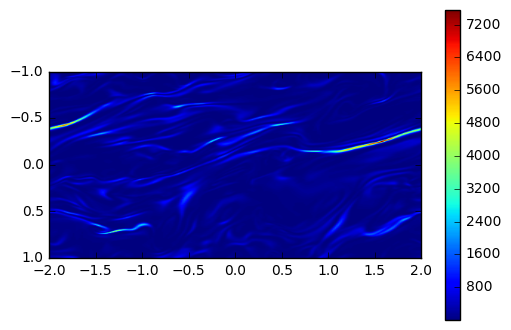

In [171]:
plt.imshow(j2[:,:,64],origin='upper',extent=[-2,2,1,-1])#,vmin=0.5,vmax=1.5)
plt.colorbar()

In [179]:
print np.average(j2)
jth2 = 1.19516e3
print np.average(j2[j2>jth2])
print jth2/np.average(j2)

201.902486191
2048.9693056
5.91949124823


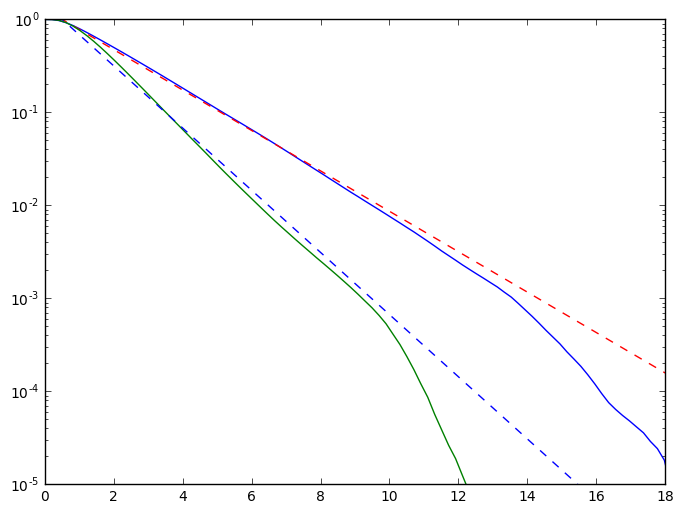

In [211]:
matplotlib.rcParams['figure.figsize'] = (8,6)
fname = 'Unstra.out2.00049.athdf.jcdf.tab'
dtype1 = np.dtype([('jth2', 'f8'), ('cdfj2', 'f8')])
ahist = np.loadtxt(fname, dtype=dtype1, usecols=(0,1))
plt.plot(ahist['jth2']**0.5,ahist['cdfj2'])
plt.yscale('log')
plt.xlim([0,18])
plt.ylim([1e-5,1])
plt.plot(ahist['jth2']**0.5,np.exp(-(ahist['jth2']**0.5-0.5)/2),'r--')

fname = 'Unstra.out2.00033.athdf.vcdf.tab'
dtype1 = np.dtype([('wth2', 'f8'), ('cdfw2', 'f8')])
ahist = np.loadtxt(fname, dtype=dtype1, usecols=(0,1))
plt.plot(ahist['wth2']**0.5,ahist['cdfw2'])
plt.plot(ahist['wth2']**0.5,np.exp(-(ahist['wth2']**0.5-0.5)/1.3),'b--')

## show the weak shocks 
* identify plasmoid (?) or vortex (?) in current sheet

In [217]:
import cPickle as pickle
from csheet3d import plot_3slice
from csheet3d import show_contour
import athena_read as ath
###########################################
# prepare the data for plotting the contours
###########################################
def prepare_contour(fname):
    time,data = ath.athdf(fname,quantities=['Bcc1'])
    b1 = data['Bcc1']
    time,data = ath.athdf(fname,quantities=['Bcc2'])
    b2 = data['Bcc2']
    time,data = ath.athdf(fname,quantities=['Bcc3'])
    b3 = data['Bcc3']
    time,data = ath.athdf(fname,quantities=['vel1'])
    v1 = data['vel1']
    time,data = ath.athdf(fname,quantities=['vel3'])
    v3 = data['vel3']
    time,data = ath.athdf(fname,quantities=['vel2'])
    v2 = data['vel2']
    time,data = ath.athdf(fname,quantities=['rho'])
    d = data['rho']
    x  = data['x1f'];y  = data['x2f']; z  = data['x3f']
    dx = dz = x[1]-x[0]; dy = y[1]-y[0]
#     def curl(vx,vy,vz,dx,dy,dz):
#       [dzvx,dyvx,dxvx] = np.gradient(vx)
#       [dzvy,dyvy,dxvy] = np.gradient(vy)
#       [dzvz,dyvz,dxvz] = np.gradient(vz)
#       j2 = (dyvz/dy-dzvy/dz)**2
#       j2 += (dzvx/dz-dxvz/dx)**2
#       j2 += (dxvy/dx-dyvx/dy)**2
#       return j2

#     j2 = curl(b1,b2,b3,dx,dy,dz)
#     w2 = curl(v1,v2,v3,dx,dy,dz)*d

    return time,x,y,z,b1,b2,b3,v1,v2,v3,d #,j2,w2

In [54]:
fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00044.athdf'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00045.athdf'
#fname=fdir+'x2y4z1r256pm1re8000/Unstra.out2.00070.athdf'
#fname=fdir+'adb.r256.new/Unstra.out2.00030.athdf'
time,x,y,z,b1,b2,b3,v1,v2,v3,d = prepare_contour(fname)
#time,x,y,z,b1,b2,b3,v1,v2,v3,d,j2,w2 = prepare_contour(fname)

time =  141.371607789
time =  141.371607789
time =  141.371607789
time =  141.371607789
time =  141.371607789
time =  141.371607789
time =  141.371607789


In [55]:
def divergence(vx,vy,vz,dx,dy,dz):
    dvxdx = np.gradient(vx,axis=2)/dx
    dvydy = np.gradient(vy,axis=1)/dy
    dvzdz = np.gradient(vz,axis=0)/dz
    return dvxdx+dvydy+dvzdz
dx,dy,dz = 1/512.,1/252.,1/512.
dx,dy,dz = 1/512.*2.,1/252.*2.,1/512.*2.
divv = divergence(v1,v2,v3,dx,dy,dz)

shock dissipation:
(1) qdiss = nu rho divv^2  0.108880546761
(2) qdiss = 2 (dv/cs)*press/(dx/cs) 17.029463069


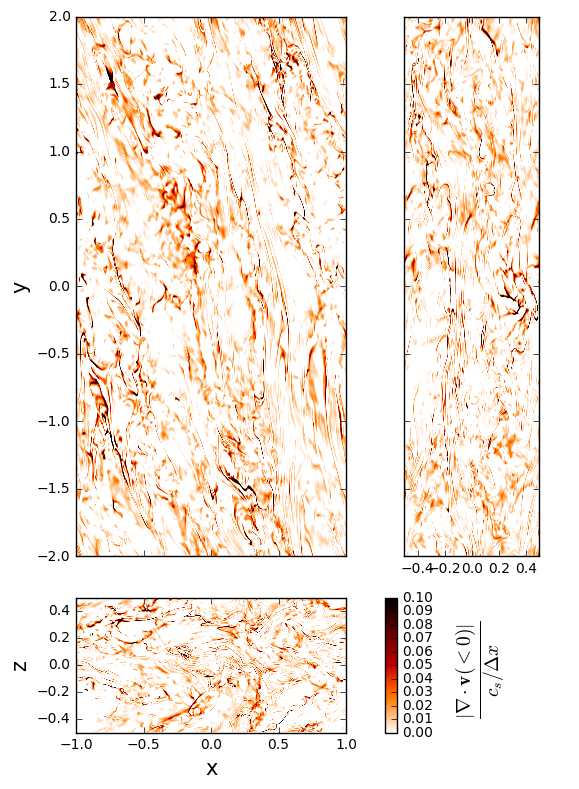

In [59]:
from my_colors import get_jhcolors
from csheet3d import plot_3slice

dx3d = (dx+dy)/2. #(dx+dy+dz)/3. #(dx*dy*dz)**(1./3.)
#va2 = ((b1**2+b2**2+b3**2)/d)
#csdx = np.sqrt(1.0+va2)/dx3d
csdx = np.sqrt(1.0+0.0)/dx3d
divv[divv>0.0] = 0.0
plot_3slice(np.abs(divv)/csdx,dmin=0,dmax=0.1,yslice=502,xslice=128,zslice=152,
#plot_3slice(np.abs(divv)/csdx,dmin=0,dmax=0.1,yslice=252,xslice=128,zslice=112,
            cmap='gist_heat_r',label=r'$\frac{|\nabla\cdot\mathbf{v}(<0)|}{c_s/\Delta x}$')
##plt.savefig('divv_r256re8000.png', format='png', dpi=300)
#plt.savefig('divv_r512re16000.png', format='png', dpi=300)
plt.savefig('divv_r512re16000_t=45.png', format='png', dpi=300)
##plt.savefig('divv_r256adbre8000.png', format='png', dpi=300)
print 'shock dissipation:'
nu_shock = 2*dx3d**2*(-divv)
qdiss = np.average(d*nu_shock*divv**2)*2.*4.*1.
print "(1) qdiss = nu rho divv^2 ",qdiss
qdiss = np.average(np.abs(divv)*2.0*(d*1.0**2))*2.*4.*1.
print "(2) qdiss = 2 (dv/cs)*press/(dx/cs)", qdiss

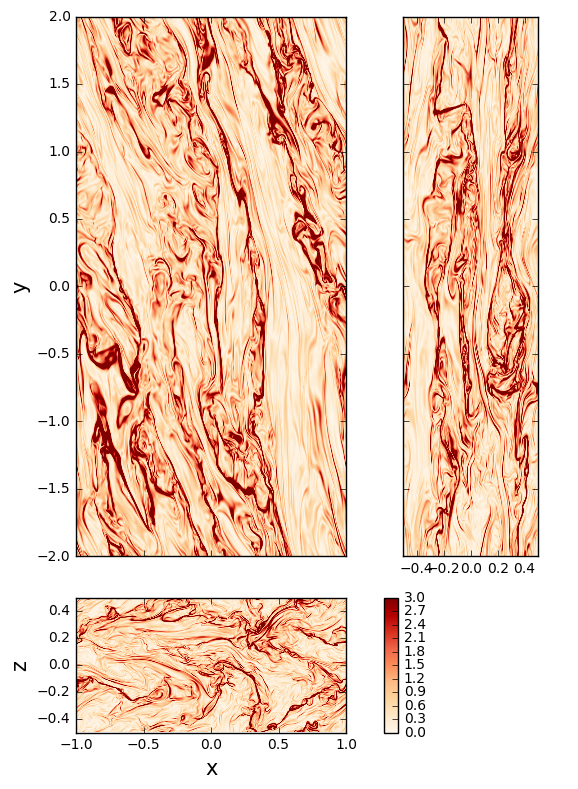

In [107]:
#plot_3slice(j2u/np.average(j2u),dmin=0,dmax=5,yslice=502,xslice=128,zslice=152)
plot_3slice(np.sqrt(j2)/np.average(np.sqrt(j2)),dmin=0,dmax=3,yslice=502,xslice=512,zslice=154)
#plot_3slice(d,dmin=0,dmax=2,yslice=502,xslice=512,zslice=154)
plt.savefig('jsheet_y=0.png', format='png', dpi=900)

## correlation between $\mathcal{E}_{\eta}/\mathcal{E}_{\nu}$ and $\rm Rm$ and $E_m/E_k$

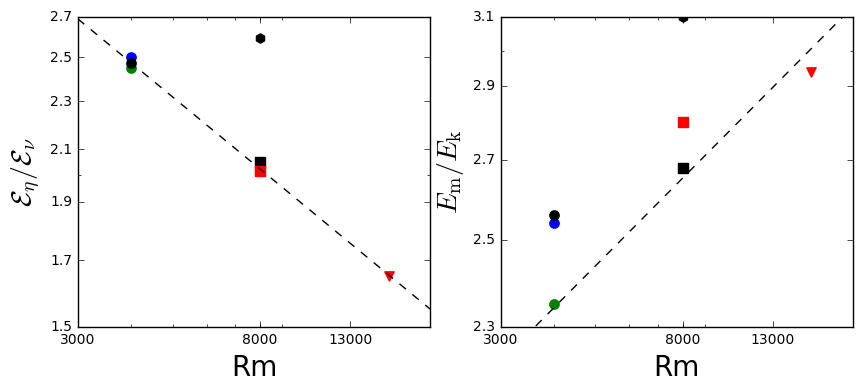

In [384]:
ratio=[2.5,2.45,2.47,
       2.05,2.59,2.015,
       1.65]
reynolds=[4000,4000,4000,8000,8000,8000,16000]
label=['r64re4000','r128re4000','r256re4000',
       'r256re8000','r256adbre8000','r512re8000',
       'r512re16000']
marker=['o','o','o','s','h','s','v']
color =['b','g','k','k','k','r','r']

matplotlib.rcParams['figure.figsize'] = (10,4)

plt.subplot(1,2,1)
for c,m,rey,rat in zip(color,marker,reynolds,ratio):
    plt.scatter(rey,rat,color=c,marker=m,s=45)

plt.xscale('log')
plt.yscale('log')
plt.xlim([3e3,2e4])
plt.ylim([1.5,2.7])
xticks=np.arange(3000,18000,5000)
labels=[str(tick) for tick in xticks]
plt.xticks(xticks, labels)

yticks=np.linspace(1.5,2.7,7)
labels=[str(tick) for tick in yticks]
plt.yticks(yticks, labels)
plt

xx = np.linspace(3e3,2e4,100)
yy = xx**(-0.29)*27.4
plt.plot(xx,yy,'k--')

plt.xlabel('Rm',fontsize=20)
plt.ylabel(r'$\mathcal{E}_{\eta}/\mathcal{E}_{\nu}$',fontsize=20)


###############################
ratio=[2.54,2.35,2.56,
      2.68,3.10,2.8,
      2.94]
reynolds=[4000,4000,4000,8000,8000,8000,16000]
label=['r64re4000','r128re4000','r256re4000',
       'r256re8000','r256adbre8000','r512re8000',
       'r512re16000']
marker=['o','o','o','s','h','s','v']
color =['b','g','k','k','k','r','r']

plt.subplot(1,2,2)
for c,m,rey,rat in zip(color,marker,reynolds,ratio):
    plt.scatter(rey,rat,color=c,marker=m,s=45)

plt.xscale('log')
plt.yscale('log')
plt.xlim([3e3,2e4])
plt.ylim([2.3,3.1])
xticks=np.arange(3000,18000,5000)
labels=[str(tick) for tick in xticks]
plt.xticks(xticks, labels)

yticks=np.linspace(2.3,3.1,5)
labels=[str(tick) for tick in yticks]
plt.yticks(yticks, labels)

xx = np.linspace(3e3,2e4,100)
yy = xx**(0.18)/1.9
plt.plot(xx,yy,'k--')
plt.xlabel('Rm',fontsize=20)
plt.ylabel(r'$E_{\rm m}/E_{\rm k}$',fontsize=20)


## correlation between Re and $\lambda_2$

            Loureiro 2017 stated $\lambda_{cr}\sim L S_L^{-4/7}$, under this scale, reconnection becomes important for dissipating the energy, the predicted power spectra is $E(k_{\perp})\propto k_{\perp}^{-5/2}$

In [61]:
%matplotlib inline

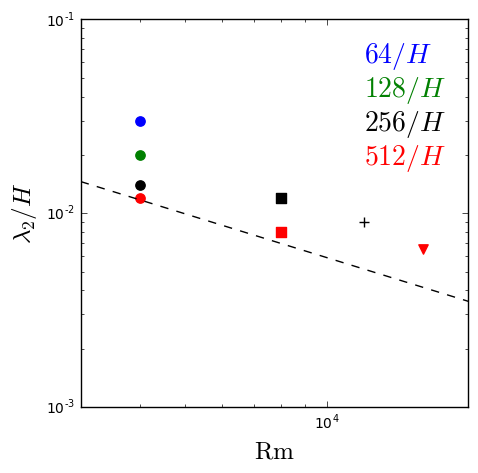

In [27]:
thickness=[30,20,14,12,
       12,12,8,9,
       6.5]
reynolds=[4000,4000,4000,4000,8000,8000,8000,12000,16000]
label=['r64re4000','r128re4000','r256re4000','r512re4000',
       'r256re8000','r256adbre8000','r512re8000','r256ideal',
       'r512re16000']
marker=['o','o','o','o','s','h','s','+','v']
color =['b','g','k','r','k','k','r','k','r']

matplotlib.rcParams['figure.figsize'] = (5,5)
#plt.subplot(1,2,1)
for c,m,rey,rat in zip(color,marker,reynolds,thickness):
    plt.scatter(rey,rat*1e-3,color=c,marker=m,s=45)

plt.xscale('log')
plt.yscale('log')
plt.xlim([3e3,2e4])

# #plt.ylim([1.5,2.7])
# xticks=np.arange(3000,18000,5000)
# labels=[str(tick) for tick in xticks]
# plt.xticks(xticks, labels)

# yticks=np.linspace(1.5,2.7,7)
# labels=[str(tick) for tick in yticks]
# plt.yticks(yticks, labels)
# plt

xx = np.linspace(3e3,2e4,100)
yy = xx**(-0.75)*5.9
plt.plot(xx,yy,'k--')


# yy = xx**(-5./7.)*4.4
# plt.plot(xx,yy,'g--')

# yy = xx**(-2./3.)*3
# plt.plot(xx,yy,'b--')


xpos,ypos = 1.2e4,0.06
plt.text(xpos,ypos,r'$64/H$',color='b',fontsize=20)
plt.text(xpos,ypos*(2./3.),r'$128/H$',color='g',fontsize=20)
plt.text(xpos,ypos*(2./3.)**2,r'$256/H$',color='k',fontsize=20)
plt.text(xpos,ypos*(2./3.)**3,r'$512/H$',color='r',fontsize=20)

plt.xlabel(r'$\rm Rm$',fontsize=18)
plt.ylabel(r'$\lambda_2 / H$',fontsize=18)

plt.savefig('thickness_Rm.png', format='png', dpi=300)

# ###############################
# ratio=[2.54,2.35,2.56,
#       2.68,3.10,2.8,
#       2.94]
# reynolds=[4000,4000,4000,8000,8000,8000,16000]
# label=['r64re4000','r128re4000','r256re4000',
#        'r256re8000','r256adbre8000','r512re8000',
#        'r512re16000']
# marker=['o','o','o','s','h','s','v']
# color =['b','g','k','k','k','r','r']

# plt.subplot(1,2,2)
# for c,m,rey,rat in zip(color,marker,reynolds,ratio):
#     plt.scatter(rey,rat,color=c,marker=m,s=45)

# plt.xscale('log')
# plt.yscale('log')
# plt.xlim([3e3,2e4])
# plt.ylim([2.3,3.1])
# xticks=np.arange(3000,18000,5000)
# labels=[str(tick) for tick in xticks]
# plt.xticks(xticks, labels)

# yticks=np.linspace(2.3,3.1,5)
# labels=[str(tick) for tick in yticks]
# plt.yticks(yticks, labels)

# xx = np.linspace(3e3,2e4,100)
# yy = xx**(0.18)/1.9
# plt.plot(xx,yy,'k--')
# plt.xlabel('Rm',fontsize=20)
# plt.ylabel(r'$E_{\rm m}/E_{\rm k}$',fontsize=20)


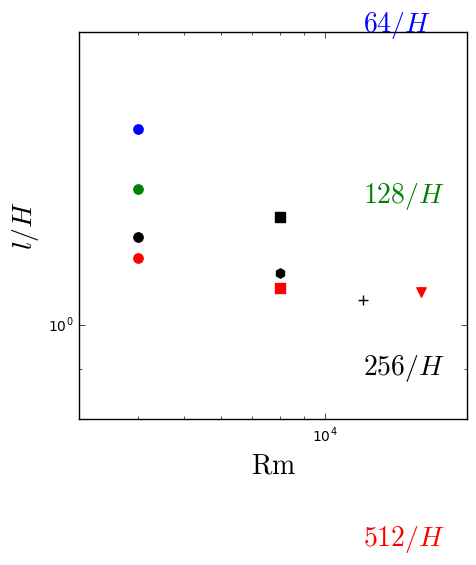

In [77]:
thickness=[1.59,1.38,1.23,1.17,
       1.29,1.13,1.09,1.06,
       1.08]
reynolds=[4000,4000,4000,4000,8000,8000,8000,12000,16000]
label=['r64re4000','r128re4000','r256re4000','r512re4000',
       'r256re8000','r256adbre8000','r512re8000','r256ideal',
       'r512re16000']
marker=['o','o','o','o','s','h','s','+','v']
color =['b','g','k','r','k','k','r','k','r']

matplotlib.rcParams['figure.figsize'] = (5,5)
#plt.subplot(1,2,1)
for c,m,rey,rat in zip(color,marker,reynolds,thickness):
    plt.scatter(rey,rat,color=c,marker=m,s=45)

plt.xscale('log')
plt.yscale('log')
plt.xlim([3e3,2e4])
plt.ylim([8e-1,2])

# #plt.ylim([1.5,2.7])
# xticks=np.arange(3000,18000,5000)
# labels=[str(tick) for tick in xticks]
# plt.xticks(xticks, labels)

# yticks=np.linspace(1.5,2.7,7)
# labels=[str(tick) for tick in yticks]
# plt.yticks(yticks, labels)
# plt

xx = np.linspace(3e3,2e4,100)
yy = xx**(-0.75)*6
plt.plot(xx,yy,'k--')
yy = xx**(-0.75)*10.5
#plt.plot(xx,yy,'k--')

xpos,ypos = 1.2e4,2
plt.text(xpos,ypos,r'$64/H$',color='b',fontsize=20)
plt.text(xpos,ypos*(2./3.),r'$128/H$',color='g',fontsize=20)
plt.text(xpos,ypos*(2./3.)**2,r'$256/H$',color='k',fontsize=20)
plt.text(xpos,ypos*(2./3.)**3,r'$512/H$',color='r',fontsize=20)

plt.xlabel(r'$\rm Rm$',fontsize=20)
plt.ylabel(r'$l / H$',fontsize=20)

#plt.savefig('thickness_Rm.png', format='png', dpi=300)

## Rm dependence of aspect ratio $\xi/\lambda$

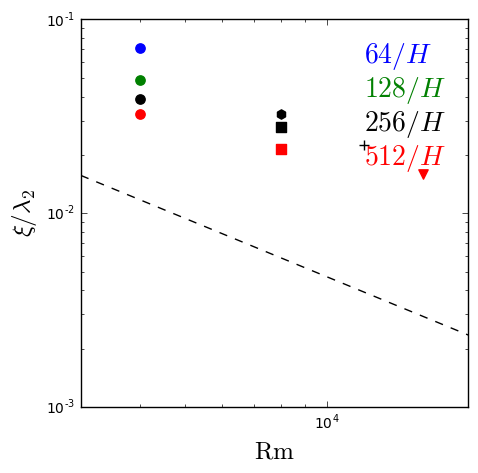

In [91]:
aspect=[14.,20.5,25.7,30.9,
       35.7,30.7,46.7,44.4,
       62.5]
reynolds=[4000,4000,4000,4000,8000,8000,8000,12000,16000]
label=['r64re4000','r128re4000','r256re4000','r512re4000',
       'r256re8000','r256adbre8000','r512re8000','r256ideal',
       'r512re16000']
marker=['o','o','o','o','s','h','s','+','v']
color =['b','g','k','r','k','k','r','k','r']

matplotlib.rcParams['figure.figsize'] = (5,5)
#plt.subplot(1,2,1)
for c,m,rey,rat in zip(color,marker,reynolds,aspect):
    plt.scatter(rey,1./rat,color=c,marker=m,s=45)

plt.xscale('log')
plt.yscale('log')
plt.xlim([3e3,2e4])

# #plt.ylim([1.5,2.7])
# xticks=np.arange(3000,18000,5000)
# labels=[str(tick) for tick in xticks]
# plt.xticks(xticks, labels)

# yticks=np.linspace(1.5,2.7,7)
# labels=[str(tick) for tick in yticks]
# plt.yticks(yticks, labels)
# plt

xx = np.linspace(3e3,2e4,100)
yy = xx**(-5/7)*47
plt.plot(xx,yy,'k--')
#yy = xx**(-0.75)*10.5
#plt.plot(xx,yy,'k--')

xpos,ypos = 1.2e4,0.06
plt.text(xpos,ypos,r'$64/H$',color='b',fontsize=20)
plt.text(xpos,ypos*(2./3.),r'$128/H$',color='g',fontsize=20)
plt.text(xpos,ypos*(2./3.)**2,r'$256/H$',color='k',fontsize=20)
plt.text(xpos,ypos*(2./3.)**3,r'$512/H$',color='r',fontsize=20)

plt.xlabel(r'$\rm Rm$',fontsize=18)
plt.ylabel(r'$\xi/\lambda_2$',fontsize=18)

#plt.savefig('thickness_Rm.png', format='png', dpi=300)




In [241]:
# x,y = data['x1f'],data['x2f']
# jslice = (j2u/np.average(j2u))[30,:,:] #[30,250:502,512:1023] #798]
# plt.subplot(1,2,1)
# show_contour(x,y,jslice,dmin=0,dmax=50,xspan=(0,0.5),yspan=(-1,0))

def plot_8panel(t,x,y,z,j2u,w2u,b1,b2,b3,v1,v2,v3,d):
    matplotlib.rcParams['figure.figsize'] = (10,40)
    x,y = data['x1f'],data['x3f']
    x1b = (x + 0.5*(x[1]-x[0]))[:-1]
    x3b = (y + 0.5*(y[1]-y[0]))[:-1]
    nx,nz = len(x1b),len(x3b)
    count = 1
    jmin,jmax = 0,5
    bmin,bmax = -2,2
    vmin,vmax = -1.5,1.5
    rmin,rmax = 0,2
    xspan,yspan = (0.3,0.7),(-0.5,-0.1)
    #xspan,yspan = (-0.4,0.),(-0.5,-0.1)
    ncol,nrow = 4,22

    left, width = .25, .5
    bottom, height = .25, .5
    right = left + width
    top = bottom + height

    cmap = 'seismic'
    yslice= 502
    step = 10

    wu = np.sqrt(w2u)
    wu /= np.average(wu)
    ju = np.sqrt(j2u)
    ju /= np.average(ju)

    for i in (np.arange(11)-5):
      ind = yslice+step*i
      for nvar in np.arange(8): #// j2,vx,bx,by
        cmap = 'seismic'
        if nvar == 0:
          var = ju[:,ind,:] #ysli(np.sqrt(j2u)/np.average(np.sqrt(j2u)))[:,yslice+step*i,:] 
          cmap = 'OrRd'
          dmin,dmax = jmin,jmax
          label = r'$|j|$'
        elif nvar == 1:
          var = b1[:,ind,:]
          dmin,dmax = bmin,bmax
          label = r'$B_x$'                                   
        elif nvar == 2:
          var = b2[:,ind,:]
          dmin,dmax = bmin,bmax
          label = r'$B_y$'                                           
        elif nvar == 3:
          var = b3[:,ind,:]
          dmin,dmax = bmin,bmax
          label = r'$B_z$'  
        elif nvar == 4:
          #var = d[:,ind,:]
          #dmin,dmax = rmin,rmax
          #label = r'$\rho$'
          var = wu[:,ind,:] #(np.sqrt(w2u)/np.average(np.sqrt(w2u)))[:,yslice+step*i,:] 
          cmap = 'OrRd'
          dmin,dmax = jmin,jmax
          label = r'$|\omega|$'
        elif nvar == 5:
          var = v1[:,ind,:]
          dmin,dmax = vmin,vmax
          label = r'$v_x$'
        elif nvar == 6:
          var = v2[:,ind,:]+1.5*1.0*np.array(np.tile(x1b,(nz,1)))
          dmin,dmax = vmin,vmax
          label = r'$\delta v_y$'
        elif nvar == 7:
          var = v3[:,ind,:]
          dmin,dmax = vmin,vmax
          label = r'$v_z$'                                          
        else:
          print 'out plotting bound'

        plt.subplot(nrow,ncol,count)
        show_contour(x,y,var,dmin=dmin,dmax=dmax,xspan=xspan,yspan=yspan,cmap=cmap,xlabel='x',ylabel='z')
        plt.text(xspan[1]-0.1,yspan[1]-0.05,label,fontsize=15)                                             
        if nvar > 0:
          plt.tick_params(labelbottom='off') 
          plt.tick_params(labelleft='off')
        count += 1

    plt.tight_layout()


* channel mode (BH91,GX94,Pessah & Chan08):  


$(B_x,B_y,B_z) = b_c e^{st}\cos(kz)(\cos\phi_b,\sin\phi_b,0)$

$(v_x,v_y,v_z) = v_c e^{st}\sin(kz)(\cos\phi_v,\sin\phi_v,0)$


* (1) in ideal MHD limit, the growth rate

$s = \Omega\sqrt{\sqrt{(2-q)^2+8q(k/k_{crit})^2}-(2-q)-2q(k/k_{crit})^2}$, where 

$k^2_{crit} = 2q\Omega^2/v_{Az}^2$ is the marginal mode upper limit of $k$

the pitch angles

$\phi_v = \tan^{-1}[(v_{Az}^2+s^2)/(2s\Omega_0)]$

$\phi_b = \phi_v+\pi/2$.

The fastest mode has 

$k_{max} = \sqrt{1-(2-q)^2/4}\Omega/v_{Az}$, and $s_{max} = q\Omega/2$.


* (2) with viscosity+resistivity (PC08,Rembiasz+15):

$\phi_v = \tan^{-1}\left[\frac{v_{Az}^2k^2+(s+k^2\eta)(s+k^2\nu)}{2\Omega_0(s+k^2\eta)}\right]$

$\phi_b = \tan^{-1}\left[\frac{-\Omega_0\{2(s+k^2\eta)+q(\nu-\eta)k^2\}}{v_{Az}^2k^2+(s+k^2\eta)(s+k^2\nu)}\right]$

under the assumption $Pm=1$, $\Phi_b = \phi_v+\pi/2$ is still true.


* In the following plots,  $\tan\phi_b \sim B_y/B_x \sim 2/(-0.5)$, $\phi_b (-76^\circ)$; $\tan\phi_v \sim v_y/v_x \sim 0.25/1 ($14^\circ$). 

* Note the estimate of $v_y$ has to be spatial average value, as the MRI channel mode is already becoming unstable to parastic instabilities (perhaps K-H instability)

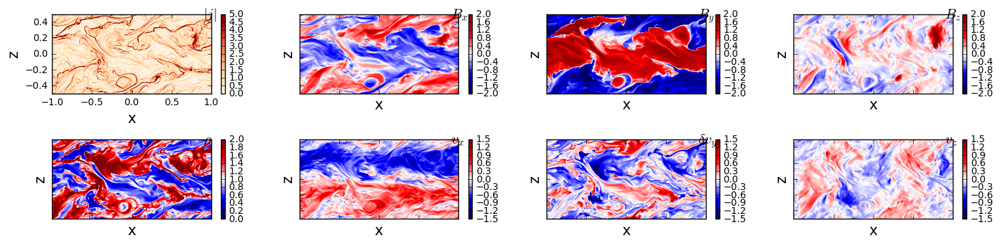

In [34]:
from csheet3d import plot_8panel

# tstr ='44'
j2 =np.load(fname+'.j2_t='+tstr+'.p.npy')
w2 =np.load(fname+'.w2_t='+tstr+'.p.npy')
# d=np.load(fname+".d_t="+tstr+".p.npy")
# bx=np.load(fname+".bx_t="+tstr+".p.npy")
# by=np.load(fname+".by_t="+tstr+".p.npy")
# bz=np.load(fname+".bz_t="+tstr+".p.npy")
# vel1=np.load(fname+".vx_t="+tstr+".p.npy")
# vel2=np.load(fname+".vy_t="+tstr+".p.npy")
# vel3=np.load(fname+".vz_t="+tstr+".p.npy")
# x=np.load(fname+".x_t="+tstr+".p.npy")
# y=np.load(fname+".y_t="+tstr+".p.npy")
# z=np.load(fname+".z_t="+tstr+".p.npy")
plot_8panel(time,x,z,j2,w2,bx,by,bz,vel1,vel2,vel3,d,isrho=True)

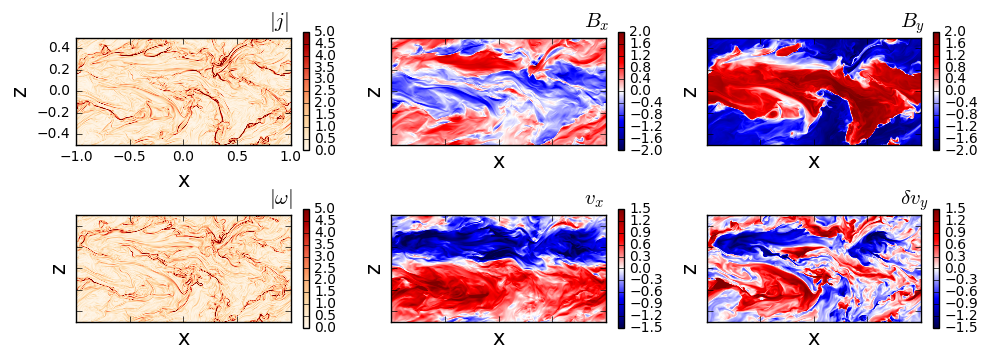

In [44]:
from csheet3d import plot_6panel 
fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00045.athdf'

# j2 =np.load(fname+'.j2_t=45.p.npy')
# w2 =np.load(fname+'.w2_t=45.p.npy')
# d=np.load(fname+".d_t=45.p.npy")
# bx=np.load(fname+".bx_t=45.p.npy")
# by=np.load(fname+".by_t=45.p.npy")
# #bz=np.load(fname+".bz_t=45.p.npy")
# vel1=np.load(fname+".vx_t=45.p.npy")
# vel2=np.load(fname+".vy_t=45.p.npy")
# #vel3=np.load(fname+".vz_t=45.p.npy")
# x=np.load(fname+".x_t=45.p.npy")
# y=np.load(fname+".y_t=45.p.npy")
# z=np.load(fname+".z_t=45.p.npy")
time = 45.*np.pi
plot_6panel(time,x,z,j2,w2,bx,by,vel1,vel2,d,isrho=False)
plt.savefig('channel_t=45_6panel.png', format='png', dpi=300)

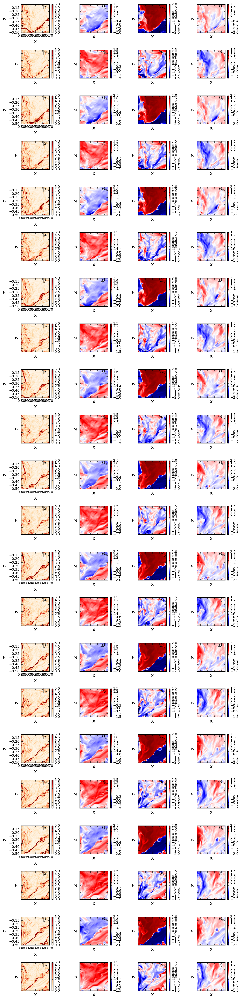

In [242]:
plot_8panel(time,x,y,z,j2,w2,b1,b2,b3,v1,v2,v3,d)

In [30]:

###############################################################
## try slices in other directions
###############################################################
# # x,y = data['x1f'],data['x2f']
# # jslice = (j2u/np.average(j2u))[30,:,:] #[30,250:502,512:1023] #798]
# # plt.subplot(1,2,1)
# # show_contour(x,y,jslice,dmin=0,dmax=50,xspan=(0,0.5),yspan=(-1,0))


# matplotlib.rcParams['figure.figsize'] = (10,20)
# x,y = data['x1f'],data['x3f']
# x,y = data['x2f'],data['x3f']
# count = 1
# jmin,jmax = 0,10
# bmin,bmax = -2,2
# vmin,vmax = -0.5,0.5
# xspan,yspan = (0.6,0.66),(0.02,0.08)
# ncol,nrow = 4,11
# cmap = 'seismic'
# xslice=512
# for i in (np.arange(11)-5):
#   for nvar in np.arange(4): #// j2,vx,bx,by
#     cmap = 'seismic'
#     dmin,dmax = 0,5
#     if nvar == 0:
#       var = (j2u/np.average(j2u))[:,:,xslice+10*i] 
#       cmap = 'OrRd'
#       dmin,dmax = jmin,jmax
#     elif nvar == 1:
#       var = data['vel1'][:,:,xslice+10*i]
#       dmin,dmax = vmin,vmax
#     elif nvar == 2:
#       var = data['Bcc1'][:,:,xslice+10*i]
#       dmin,dmax = bmin,bmax
#     elif nvar == 3:
#       var = data['Bcc2'][:,:,xslice+10*i]
#       dmin,dmax = bmin,bmax
#     else:
#       print 'out plotting bound'

#     plt.subplot(nrow,ncol,count)
#     show_contour(x,y,var,dmin=dmin,dmax=dmax,xspan=xspan,yspan=yspan,cmap=cmap,xlabel='y',ylabel='z')
#     count += 1
    
# plt.tight_layout()


In [4]:
import cPickle as pickle
from csheet3d import get_curl
from csheet3d import plot_3slice
from csheet3d import show_contour
import athena_read as ath


fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00046.athdf'
t,x,y,z,j2e,w2e = get_curl(fname)
#from csheet3d import plot_3slice
#from csheet3d import get_curl
fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00044.athdf'
t,x,y,z,j2s,w2s = get_curl(fname)


time =  144.51300065
time =  144.51300065
time =  144.51300065
time =  144.51300065
time =  144.51300065
time =  144.51300065
time =  144.51300065
time =  138.229990084
time =  138.229990084
time =  138.229990084
time =  138.229990084
time =  138.229990084
time =  138.229990084
time =  138.229990084


In [6]:

fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00045.athdf'
j2 =np.load(fname+'.j2_t=45.p.npy')
w2 =np.load(fname+'.w2_t=45.p.npy')

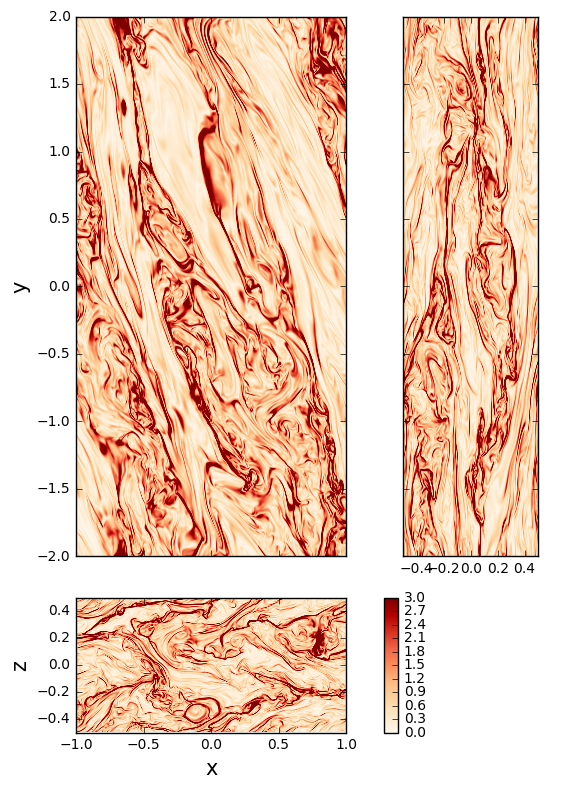

In [9]:
plot_3slice(np.sqrt(j2s)/np.average(np.sqrt(j2s)),dmin=0,dmax=3,yslice=502,xslice=819,zslice=102)

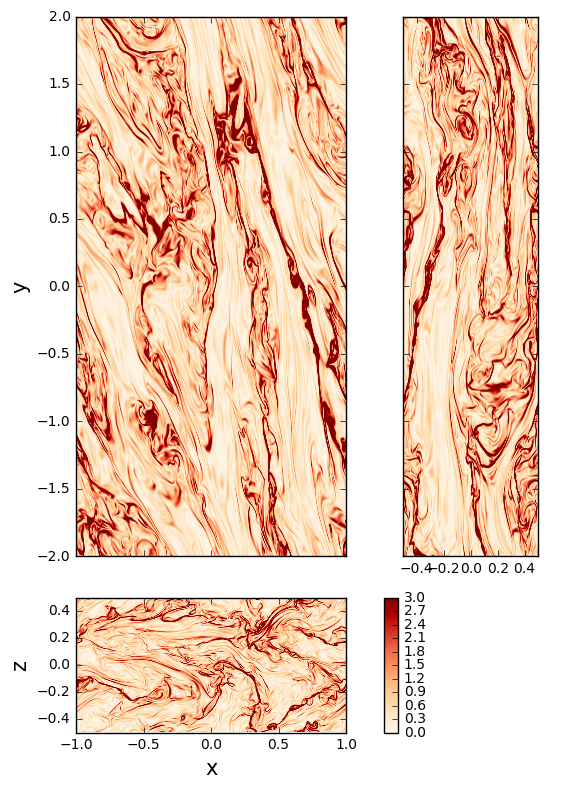

In [10]:
plot_3slice(np.sqrt(j2)/np.average(np.sqrt(j2)),dmin=0,dmax=3,yslice=502,xslice=819,zslice=102)

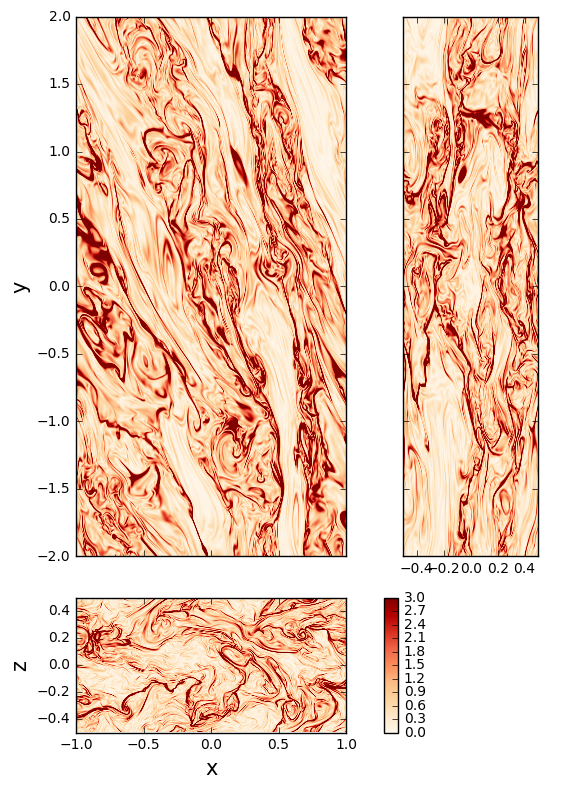

In [11]:
plot_3slice(np.sqrt(j2e)/np.average(np.sqrt(j2e)),dmin=0,dmax=3,yslice=502,xslice=819,zslice=102)

In [12]:
fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00046.athdf'


np.save(fname+".j2_t=46.p",j2e)
np.save(fname+".w2_t=46.p",w2e)

fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00044.athdf'
np.save(fname+".j2_t=44.p",j2s)
np.save(fname+".w2_t=44.p",w2s)

In [33]:
fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00044.athdf'
tstr='44'
#time,data = ath.athdf(fname,quantities=['vel1','vel2','vel3'])
time,data = ath.athdf(fname,quantities=['vel1'])
vel1 = data['vel1']
time,data = ath.athdf(fname,quantities=['vel2'])
vel2 = data['vel2']
time,data = ath.athdf(fname,quantities=['vel3'])
vel3 = data['vel3']
time,data = ath.athdf(fname,quantities=['Bcc1'])
bx = data['Bcc1']
time,data = ath.athdf(fname,quantities=['Bcc2'])
by = data['Bcc2']
time,data = ath.athdf(fname,quantities=['Bcc3'])
bz = data['Bcc3']
time,data = ath.athdf(fname,quantities=['rho'])
d = data['rho']

np.save(fname+ ".d_t="+tstr+".p",d)
np.save(fname+".bx_t="+tstr+".p",bx)
np.save(fname+".by_t="+tstr+".p",by)
np.save(fname+".bz_t="+tstr+".p",bz)
np.save(fname+".vx_t="+tstr+".p",vel1)
np.save(fname+".vy_t="+tstr+".p",vel2)
np.save(fname+".vz_t="+tstr+".p",vel3)
np.save(fname+ ".x_t="+tstr+".p",data['x1f'])
np.save(fname+ ".y_t="+tstr+".p",data['x2f'])
np.save(fname+ ".z_t="+tstr+".p",data['x3f'])

# vel1,vel2,vel3=data['vel1'],data['vel2'],data['vel3']
# x,y,z = data['x1f'],data['x2f'],data['x3f']
# x1b = (x + 0.5*(x[1]-x[0]))[:-1]
# x2b = (y + 0.5*(y[1]-y[0]))[:-1]
# x3b = (z + 0.5*(z[1]-z[0]))[:-1]
# nx,ny,nz = len(x1b),len(x2b),len(x3b)
# plot_3slice(data['vel2']+1.5*1.0*np.array(np.tile(x1b,(nz,ny,1))),dmin=-2,dmax=2,yslice=502,xslice=819,zslice=102,cmap='seismic')

time =  138.229990084
time =  138.229990084
time =  138.229990084
time =  138.229990084
time =  138.229990084
time =  138.229990084
time =  138.229990084


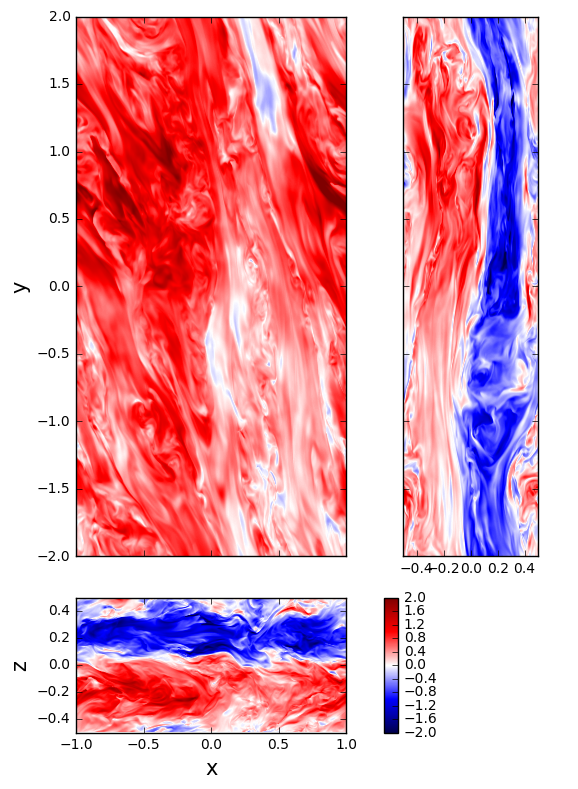

In [17]:
plot_3slice(data['vel1'],dmin=-2,dmax=2,yslice=502,xslice=819,zslice=102,cmap='seismic')

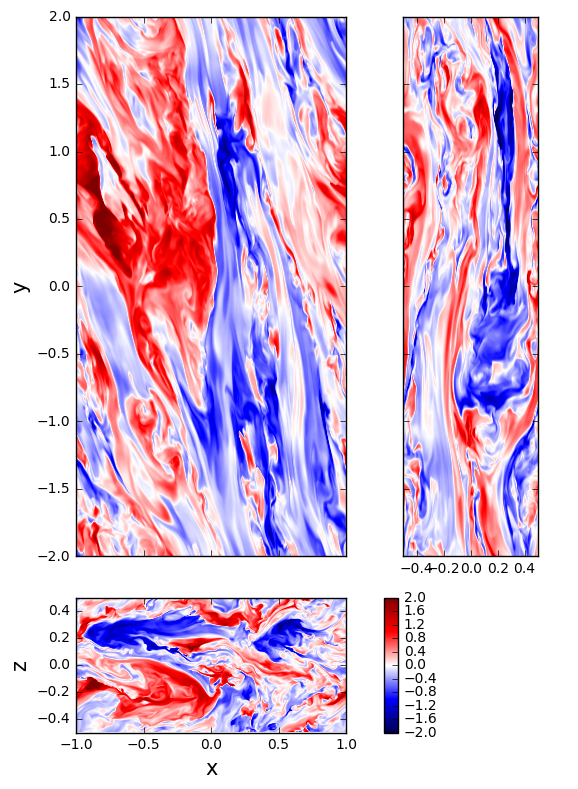

## Adiabatic run
    similar to above runs except we now keep the heating from dissipation

Run x2y4z1r256pm1re8000: <alpha> =  0.149096912406 0.0300220509719 0.179118963378
Run adb.r256/adb.tc1e-12: <alpha> =  0.186240461779 0.0383283894805 0.22456885126
Run adb.r256/adb.t=0: <alpha> =  0.0893016722082 0.0241495350108 0.113451207219
Run adb.r256: <alpha> =  0.167891721408 0.027280843847 0.195172565255
Run adb.r256.new: <alpha> =  0.15916251364 0.0284082800711 0.187570793711


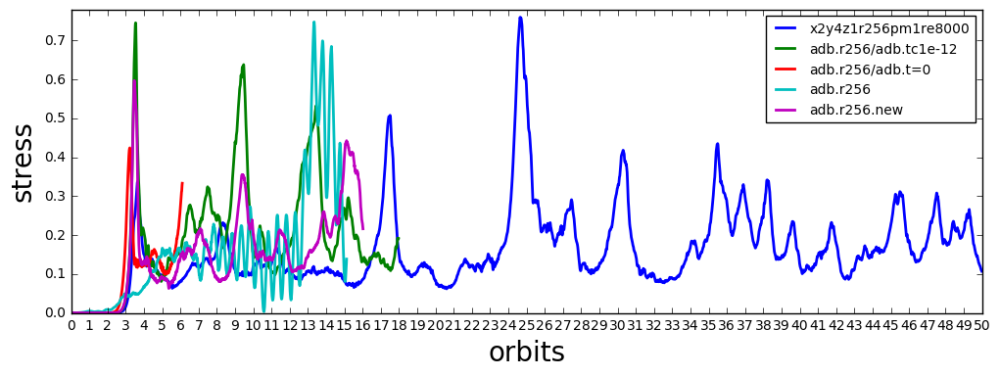

In [27]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
from read_hist import read_hist1d
%matplotlib inline


direname='/tigress/jiming/reconnect/athena/bin/'
basename='Unstra.out2.'
appdname='athdf'
histname='Unstra.hst'

omg=1.0
rho0=1.0
cs = 1.0
pres = rho0*cs**2
torb=2.*np.pi/omg

#list of target
targlist=[ 'x2y4z1r256pm1re8000','adb.r256/adb.tc1e-12','adb.r256/adb.t=0','adb.r256','adb.r256.new']
#targlist = ['adb/adb.r256']


# # a shorter list for paper:
# targlist=[  'x2y4z1r128pm1re4000',\
#             'x2y4z1r256pm1re8000',\
#             'x2y4z1r512pm1re16000',\
#             'x2y4z1r256ideal']

Lx,Ly,Lz=2.0,4.0,1.0
volume= Lx*Ly*Lz
first_time=True

matplotlib.rcParams['figure.figsize'] = (12,4)

for targname in targlist:
    fname=direname+targname+'/'+histname
    if targname[0:3] == 'adb':
      tt,em1,em2,em3,maxwell,reynolds = read_hist1d(fname,adb=True)
    else:
      tt,em1,em2,em3,maxwell,reynolds = read_hist1d(fname)
    plt.plot(tt/torb,(maxwell+reynolds)/pres/volume,label=targname,lw=2)
    #plt.plot(tt/torb,(em1+em2+em3)/pres/volume,label=targname[6:],lw=2)
    size=int(len(maxwell)*0.2)
    if targname == 'x2y4z1r256pm1re8000':
        size =int(len(maxwell)*0.2)
    if targname == 'x2y4z1r512pm1re4000':
        size =int(len(maxwell)*0.2)
    print 'Run '+targname+': <alpha> = ',np.average(maxwell[size:])/pres/volume, \
                                         np.average(reynolds[size:])/pres/volume, \
                                         np.average(maxwell[size:]+reynolds[size:])/pres/volume
   
plt.ylim([0,0.78])
plt.xlim([0,50])
plt.xticks(np.arange(0, 51, 1.0))
plt.xlabel('orbits',fontsize=20)
plt.ylabel('stress',fontsize=20)
plt.legend(fontsize=10,loc=1)
#plt.savefig('alpha_t.png', format='png', dpi=300)

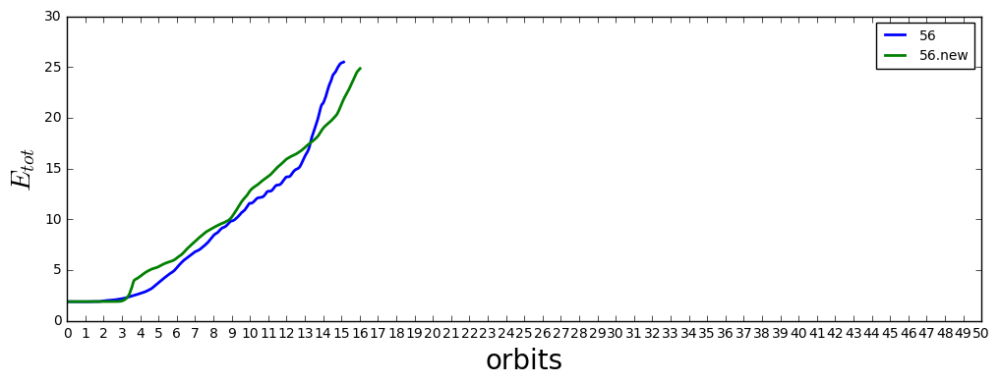

In [26]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
from read_hist import read_hist1d_energy
%matplotlib inline


direname='/tigress/jiming/reconnect/athena/bin/'
basename='Unstra.out2.'
appdname='athdf'
histname='Unstra.hst'

omg=1.0
rho0=1.0
cs = 1.0
pres = rho0*cs**2
torb=2.*np.pi/omg

#list of target
targlist=[ 'adb.r256','adb.r256.new']#,'adb/adb.t=0']#,'x2y4z1r256pm1re8000']#,'adb/adb.tc1e-12']

Lx,Ly,Lz=2.0,4.0,1.0
volume= Lx*Ly*Lz
first_time=True

matplotlib.rcParams['figure.figsize'] = (12,4)

for targname in targlist:
    fname=direname+targname+'/'+histname
    tt,ek1,ek2,ek3,em1,em2,em3,etot = read_hist1d_energy(fname)
    plt.plot(tt/torb,etot/pres/volume,label=targname[6:],lw=2)
   
#plt.ylim([0,0.78])
plt.xlim([0,50])
#plt.ylim([0,10])
plt.xticks(np.arange(0, 51, 1.0))
plt.xlabel('orbits',fontsize=20)
plt.ylabel(r'$E_{tot}$',fontsize=20)
plt.legend(fontsize=10,loc=1)
#plt.savefig('alpha_t.png', format='png', dpi=300)

In [29]:
import athena_read as ath

def loadData(fname='Unstra.out2.00008.athdf'):
  """load 3d bfield vfield"""
  """bfield[nz,ny,nx]"""
  """vfield[nz,ny,nx]"""
  """[nz,ny,nx]=256,504,512"""
  """[Lz,Ly,Lx]=[1,4,2]"""
  #data=ath.athdf(fname,quantities=['Bcc1','Bcc2','Bcc3'])
  #data=ath.athdf(fname,quantities=['vel1','vel2','vel3'])
  #data=ath.athdf(fname,quantities=['rho'])
  time,data=ath.athdf(fname,quantities=['rho'])
  rho = data['rho']
  time,data=ath.athdf(fname,quantities=['Bcc1'])
  bx = data['Bcc1']
  time,data=ath.athdf(fname,quantities=['Bcc2'])
  by = data['Bcc2']
  time,data=ath.athdf(fname,quantities=['Bcc3'])
  bz = data['Bcc3']
  time,data=ath.athdf(fname,quantities=['vel1'])
  vx = data['vel1']
  time,data=ath.athdf(fname,quantities=['vel2'])
  vy = data['vel2'] # with vshear=-q\Omega x; q=1.5 Omega=1.0
  time,data=ath.athdf(fname,quantities=['vel3'])
  vz = data['vel3']
  # ---
  x  = data['x1f'] # face centered grid
  y  = data['x2f']
  z  = data['x3f']    
  dx = x[1]-x[0]
  dy = y[1]-y[0]
  dz = z[1]-z[0]
  x = (x+0.5*dx)[:-1]
  y = (y+0.5*dy)[:-1]
  z = (z+0.5*dz)[:-1]
  nx,ny,nz = len(x),len(y),len(z)
   # delta v_y without vshear
  vy += 1.5*1.0*np.array(np.tile(x,(nz,ny,1)))

  return x,y,z,rho,vx,vy,vz,bx,by,bz

In [30]:
fname='/tigress/jiming/reconnect/athena/bin/x2y4z1r256pm1re8000/Unstra.out2.00100.athdf'
x,y,z,rho,vx,vy,vz,bx,by,bz = loadData(fname)

time =  314.15926
time =  314.15926
time =  314.15926
time =  314.15926
time =  314.15926
time =  314.15926
time =  314.15926


In [32]:
print vy.shape

(256, 504, 512)


In [ ]:
import cPickle as pickle
from csheet3d import get_curl
from csheet3d import plot_3slice
from csheet3d import show_contour
import athena_read as ath


fdir = '/tigress/jiming/reconnect/athena/bin/'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00040.athdf'
t,x,y,z,j2,w2 = get_curl(fname)

In [14]:
del j2,w2

## identify magnetic null points

* use the following to get the number count for the table in paper

In [347]:
import cPickle as pickle

fdir = '/tigress/jiming/reconnect/athena/bin/'
#fname=fdir+'x2y4z1r256pm1re8000/Unstra.out2.00031.athdf'
#fname=fdir+'x2y4z1r256pm1re4000/Unstra.out2.00030.athdf'
fname=fdir+'x2y4z1r256ideal/Unstra.out2.00030.athdf'
fname=fdir+'x2y4z1r512pm1re16000/Unstra.out2.00030.athdf'
fname=fdir+'x2y4z1r128pm1re4000/Unstra.out2.00050.athdf'
fname=fdir+'x2y4z1r512pm1re8000/Unstra.out2.00030.athdf'
#fname=fdir+'adb.r256.new/Unstra.out2.00020.athdf'
fname=fdir+'x2y4z1r512pm1re4000/Unstra.out2.00015.athdf'
jlist_sorted = pickle.load( open( fname+".jlist.p", "rb" ) )
print len(jlist_sorted),' current sheets'


null = pickle.load( open( fname+".null.p", "rb" ) )
print len(null), ' magnetic null points'
print
print null[:5]

4811  current sheets
845  magnetic null points

[(0, 561, 7), (0, 692, 175), (0, 992, 1016), (2, 215, 752), (3, 696, 173)]


In [245]:
type(jlist_sorted[100])

dict

In [348]:
def identifier(jlist,nlist):
  j_null=[]
  null_copy = nlist[:]
  #print null_copy
  for i in range(0,len(jlist)):
    if len(jlist[i]) >= 8:     
      points = set(null_copy).intersection(jlist[i].keys()) 
      #if i<=10:
      #  print points
      if bool(points): # found identity 
        j_null.append(jlist[i])
      #else:  # no identity 
      #  j_nonu +=jlist[i]
      null_copy=[x for x in null_copy if x not in list(points)]

  return j_null,null_copy

jnull,ncopy = identifier(jlist_sorted,null)
print len(jnull),len(ncopy)

54 731


In [334]:
print len(jnull)
print [len(jnull[i]) for i in np.arange(0,99)]


99
[122455, 81723, 64903, 54560, 50000, 41476, 27389, 24874, 20748, 17617, 16068, 15015, 13146, 12876, 12655, 9939, 9913, 9135, 7530, 7469, 7305, 6506, 5991, 5614, 5553, 5303, 5285, 4987, 4953, 4942, 4827, 4392, 4117, 3932, 3654, 3634, 3271, 3259, 3249, 3235, 3203, 3188, 3119, 2938, 2893, 2827, 2686, 2607, 2454, 2261, 2239, 2214, 1955, 1703, 1674, 1651, 1646, 1371, 1343, 1334, 1238, 1155, 1125, 1119, 1080, 1055, 1019, 1005, 888, 852, 796, 677, 661, 654, 644, 617, 566, 496, 494, 434, 419, 333, 326, 252, 223, 220, 208, 172, 160, 149, 128, 81, 66, 22, 16, 6, 2, 1, 1]


In [195]:
# search for the current sheet given a null point? 
identity = {}
null_copy = null[:]
print null_copy[:5]
jvolume = 0.0; numnull = float(len(null))
for i in range(0,len(jlist_sorted)):
  jvolume +=len(jlist_sorted[i]) # obtain total volume
  for location in null_copy:
    if location in jlist_sorted[i]:
      null_copy.remove(location)
      identity[location] = i # store null pt location:index of current sheet key:value pair
print len(identity)
print identity
print 
# calc the number density of null points on current sheet or in the whole box
lx,ly,lz=2,4,1
resx,resz = 256.,256.
resy = resx*0.5
totvolume = lx*ly*lz*resx*resy*resz
print "current sheet volume / whole box volume = ", jvolume/totvolume
print "number density of null points in whole volume = ", numnull/totvolume
print "number density of null points in current sheet = ", float(len(identity))/jvolume

[(0, 264, 37), (0, 314, 467), (1, 0, 409), (1, 138, 469), (1, 249, 295)]
210
{(8, 20, 195): 518, (36, 219, 434): 3, (140, 4, 157): 436, (247, 351, 471): 79, (42, 26, 470): 12, (138, 207, 506): 1, (6, 268, 325): 25, (15, 354, 312): 5, (129, 409, 114): 0, (17, 482, 252): 101, (35, 302, 439): 3, (113, 408, 296): 596, (58, 243, 411): 24, (94, 268, 385): 35, (41, 205, 421): 3, (100, 347, 474): 1, (13, 447, 308): 46, (24, 466, 251): 61, (218, 68, 177): 13, (46, 114, 451): 0, (109, 192, 445): 47, (41, 179, 448): 2546, (50, 336, 68): 18, (137, 465, 175): 0, (155, 48, 93): 77, (156, 175, 483): 16, (244, 330, 85): 7, (76, 165, 439): 92, (194, 373, 359): 322, (229, 458, 232): 114, (192, 190, 130): 91, (73, 259, 154): 8, (6, 23, 192): 518, (55, 210, 100): 181, (153, 379, 166): 71, (203, 153, 105): 106, (7, 267, 327): 25, (167, 122, 456): 2, (216, 421, 88): 7, (145, 226, 473): 1, (74, 258, 156): 8, (27, 39, 368): 75, (61, 302, 436): 3, (101, 127, 69): 65, (230, 468, 230): 114, (79, 297, 236): 0, (6

In [162]:
print [len(jlist_sorted[i]) for i in np.arange(5)]

[168257, 77833, 71574, 58421, 48877]


set([0, 1, 2, 3, 4, 5, 518, 7, 8, 10, 12, 13, 15, 16, 17, 18, 24, 25, 538, 28, 7709, 34, 35, 37, 40, 42, 44, 46, 47, 1584, 52, 53, 54, 55, 61, 574, 65, 67, 1094, 71, 72, 75, 77, 79, 80, 596, 85, 88, 91, 92, 93, 1040, 611, 101, 103, 106, 113, 114, 116, 133, 653, 149, 155, 157, 158, 180, 181, 183, 192, 8389, 200, 206, 207, 215, 218, 223, 224, 240, 245, 256, 773, 276, 283, 287, 48, 292, 303, 819, 322, 347, 349, 383, 389, 525, 430, 436, 490, 2546, 84])
99


(array([ 15.,   6.,  10.,   8.,   7.,   6.,   1.,   4.,   0.,   4.,   5.,
          2.,   3.,   1.,   3.,   1.,   1.,   2.,   0.,   2.,   0.,   2.,
          0.,   0.,   1.,   1.,   2.,   0.,   1.,   1.,   1.,   0.,   1.,
          0.,   0.,   0.,   0.,   0.,   1.,   0.,   1.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.]),
 array([    0.,    20.,    40.,    60.,    80.,   100.,   120.,   140.,
          160.,   180.,   200.,   220.,   240.,   260.,   280.,   300.,
          320.,   340.,   360.,   380.,   400.,   420.,   440.,   460.,
          480.,   500.,   520.,   540.,   560.,   580.,   600.,   620.,
          640.,   660.,   680.,   700.,   720.,   740.,   760.,   780.,
          800.,   820.,   840.,   860.,   880.,   900.,   920.,   940.,
          960.,   980.,  1000.]),
 <a list of 50 Patch objects>)

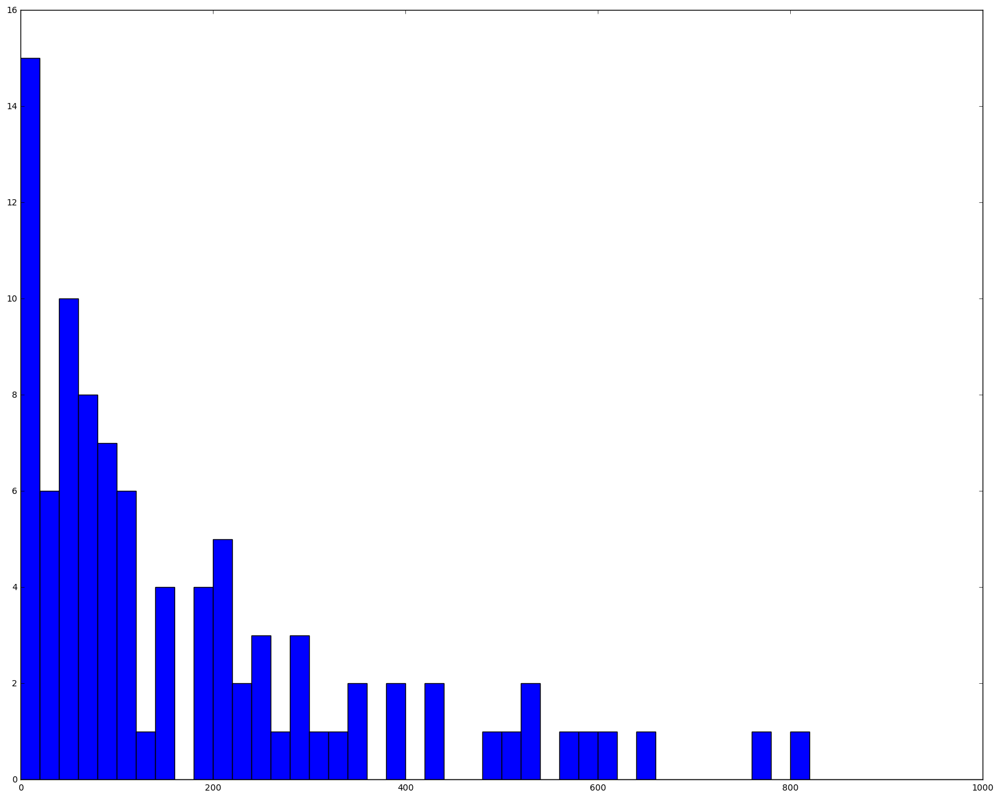

In [200]:

hdata = identity.values()
print set(hdata)
print len(set(hdata))

#vmin=
#hist,bins = np.histogram(hdata, bins=np.logspace(vmin,vmax,nbins),      density=1)
plt.hist(list(set(hdata)),bins=50,range=(0,1000))

In [219]:
type(jlist_sorted[1].values())

list

In [268]:
print np.shape(hdata)

(210,)
